<a href="https://colab.research.google.com/github/hegdenischay/NEURONNet/blob/main/Synchrony_b_w_2_coupled_and_4_coupled.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
size =   3#@param {type:"integer"}
dimension = "High" #@param ["High", "Low"]
epochs =  20 #@param {type:"integer"}
A_plus = 0.01 #@param {type:"number"}
A_minus = -0.011 #@param {type: "number"}
lateralDelay = 5 #@param {type: "number"}

In [ ]:
#@title Parameters
from ipywidgets import FloatText, Checkbox, VBox, Dropdown
import ipywidgets as widgets

currentAmp = FloatText(description='Amplitude:', value=0.1)
sets = FloatText(description='sets:', value=15)
noiseSD = FloatText(description='noiseSD:', value=0.01)

vb = VBox(children = [currentAmp, sets])
with_noise = Checkbox(description='Add noise')

def add_noise(button):
    if button['new']:
        vb.children = [currentAmp, sets, noiseSD]
    else:
        vb.children = [currentAmp, sets]

with_noise.observe(add_noise, names='value')
display(with_noise)
display(vb)

Checkbox(value=False, description='Add noise')

In [ ]:
#@title Distribution
from ipywidgets import FloatText, Checkbox, VBox, Dropdown
import ipywidgets as widgets

distribution = Dropdown(description='distribution:', options=["uniform", "normal", "poisson"], value="uniform")
low = FloatText(description='low:', value=1)
high = FloatText(description='high:', value=1.5)
leng = FloatText(description='size:', value=sets.value)
mean = FloatText(description='mean:', value=1)
sd = FloatText(description='SD:', value=0.5)
lam = FloatText(description='lam', value=3)

vb2 = VBox(children = [low, high, leng])

def change_widgets(button):
    if button['new'] == "uniform":
        vb2.children = [low, high, leng]
    elif button['new'] == "normal":
        vb2.children = [mean, sd, leng]
    elif button['new'] == "poisson":
        vb2.children = [lam, sets]

distribution.observe(change_widgets, names='value')
display(distribution)
display(vb2)

Dropdown(description='distribution:', options=('uniform', 'normal', 'poisson'), value='uniform')

In [ ]:
import numpy as np
i1 = 0.22
i2 = 0.5
sets = 3
weights = np.random.uniform(0.5,1,15)
weight = 0.01
del1 = 4
del2 = 2

### Install Neuron

In [ ]:
pip install pandas neuron

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# %load_ext google.colab.data_table
# import pandas
# data = {'Time taken': ['5 sets (with learning)', '5 sets (without learning)', '30 sets (with learning)', '30 sets (without)'], 'Time (s)': [64.94386959075928, 64.94386959075928-47.318169593811035, 163.1467843055725, 163.1467843055725-123.22148942947388]}  
# pandas.DataFrame(data)

### Import prerequisites

In [ ]:
import time
totalstart = time.time()
import os
if os.getcwd() != "/content":
    # we are not in google colab, assume hebbian library is in current dir
    from hebb import ORN, MCELL, GCELL
else:
    # download from git
    import shutil, requests
    url = 'https://cloud.operationtulip.com/s/t8nbn8Y582w94P3/download/git.zip'
    response = requests.get(url, stream=True)
    with open('git.zip', 'wb') as out_file:
        shutil.copyfileobj(response.raw, out_file)
    del response
    import zipfile
    with zipfile.ZipFile('git.zip', 'r') as zip_ref:
        zip_ref.extractall('')


In [ ]:
!nrnivmodl &>/dev/null

In [ ]:
from neuron import h #.h is a HOC object instance & gui from neuron can also be imported 
from math import pi                  
from neuron.units import ms,mV
from hebb_test import ORN, MCELL, GCELL
h.load_file('stdrun.hoc')                #Allows us to do a high level simulation
pc = h.ParallelContext()
import random  
import matplotlib.pyplot as plt1

from bokeh.io import output_notebook
import bokeh.plotting as plt2
output_notebook()

import seaborn as sns

## Helper Functions

In [ ]:
def stairstep(lo: float, hi: float, duration: int, max_duration: int = 200, noise: list = []) -> list:
    # duration and max_duration are in ms
    ans = [lo if i < duration else hi for i in range(0,max_duration)]
    if len(noise) == 0:
        return ans
    else:
        assert len(ans) == len(noise)
        return [ans[i]+noise[i] for i in range(len(ans))]
    # return [0+0.8*(i/duration) if i < duration else 0 for i in range(0,max_duration)]
    # visualize input 

In [ ]:
def netConMaker(source, dest, weights, delay, threshold, place='axon', type='exc'):
    # print(source, dest)
    if place == 'axon':
        if type == 'exc':
            netcon = h.NetCon(source.axon(0.5)._ref_v, dest.dendexcisyn, sec=source.axon)
        elif type == 'inh':
            netcon = h.NetCon(source.axon(0.5)._ref_v, dest.dendinhisyn, sec=source.axon)
    elif place == 'soma':
        if type == 'exc':
            netcon = h.NetCon(source.soma(0.5)._ref_v, dest.dendexcisyn, sec=source.soma)
        elif type == 'inh':
            netcon = h.NetCon(source.soma(0.5)._ref_v, dest.dendinhisyn, sec=source.soma)
    netcon.weight[0] = weights
    netcon.delay = delay
    netcon.threshold = threshold
    return netcon

In [ ]:
def latConMaker(source, dest, weights, delay, threshold, type='exc'):
    if type == 'exc':
        netcon = h.NetCon(source.dend(0.5)._ref_v, dest.dendexcisyn, sec=source.dend)
    else:
        netcon = h.NetCon(source.dend(0.5)._ref_v, dest.dendinhisyn, sec=source.dend)
    if "Set [2]" in repr(source):
        netcon.weight[0] = del1
    else:
        netcon.weight[0] = del2
    # netcon.weight[0] = weights
    netcon.delay = delay
    netcon.threshold = threshold
    return netcon

In [ ]:
%matplotlib inline
def plotCell(source, name, addendum=''):
    recording_cell = source
    cell_axon = h.Vector().record(recording_cell.axon(0.5)._ref_v)
    cell_dend = h.Vector().record(recording_cell.dend(0.5)._ref_v)
    t = h.Vector().record(h._ref_t)

    h.finitialize(-70 * mV)
    h.continuerun(300 * ms)

    f = plt1.figure(figsize=(16,9))
    ax = f.add_subplot(1,1,1)
    ax.plot(t, list(cell_axon), label=name+' axon '+addendum)
    ax.plot(t, list(cell_dend), label=name+' dendrite '+addendum)
    ax.legend(loc="upper right")
    ax.set_xlabel('t (ms)')
    ax.set_ylabel('v (mV)')
    plt1.show()

In [ ]:
import math
def generate_L_weight_delta(first, second):
    A_plus = 0.01
    A_minus = -0.011
    tau_pre =20*ms
    tau_post =20*ms
    delta_t = [(second[iter] - first[iter]) for iter in range(min(len(first),len(second)))]
    delta_w_list = [A_plus*math.exp(-delta_t[iter]/tau_post) if delta_t[iter] >=0 else A_minus*math.exp(delta_t[iter]/tau_pre) for iter in range(min(len(first),len(second)))]  
    delta_w = sum(delta_w_list)
    return delta_w

In [ ]:
from IPython.display import HTML, display
import time

def progress(value, max=100):
    return HTML("""
        <progress
            value='{value}'
            max='{max}',
            style='width: 100%'
        >
            {value}
        </progress>
    """.format(value=value, max=max))

## Network Definitions

In [ ]:
#Gives one 2 coupled neuron using freeman's topology in olfactory bulb
class CONNECTING:

    def __init__(self,M,weights,delay1=0,delay2=2,delay3=4,delay4=6):
        wMM=weights[0]
        wMG=weights[1]
        wGM=weights[2]
        wGG=weights[3]
        
        self.M = M #Set no.
        self.th = -70
        self.maindelay = 5
        
        #Making 2 neurons
        self.P1=MCELL(2,self.M)
        self.P2=MCELL(3,self.M)
        self.cells =  [self.P1, self.P2]
        
        if M != 1:
            self.stim = h.IClamp(self.P1.dend(0.5))
            self.stim.delay = 10
            self.stim.dur = 1000
            self.stim.amp = i1
        else:
            self.stim = h.IClamp(self.P1.dend(0.5))
            self.stim.delay = 10
            self.stim.dur = 1000
            self.stim.amp = i2
        
        self.nc1 = netConMaker(self.P1, self.P2, wMM, self.maindelay+delay3, self.th, 'soma') #Connecting P1 to P2
        self.nc2 = netConMaker(self.P2, self.P1, wMM, self.maindelay+delay3, self.th, 'soma') #Connecting P2 to P1
    
        # 4-coupled

        self.M1=MCELL(1,self.M)
        self.M2=MCELL(2,self.M)
        self.G1=GCELL(3,self.M)
        self.G2=GCELL(4,self.M)
        self.cells.extend([self.M1, self.M2, self.G1, self.G2])

        self.nc3 = netConMaker(self.P1, self.M1, wMM, delay1+self.maindelay, self.th, 'soma')
        self.nc4 = netConMaker(self.M1, self.M2, wMM, delay2+self.maindelay, self.th, 'soma') #Connecting M1 to M2
        self.nc5 = netConMaker(self.M2, self.M1, wMM, delay2+self.maindelay, self.th, 'soma') #Connecting M2 to M1
        self.nc6 = netConMaker(self.M2, self.G1, wMG, delay2+self.maindelay, self.th, 'soma') #Connecting M2 to G1
        self.nc7 = netConMaker(self.G1, self.M2, wGM, delay2+self.maindelay, self.th, 'soma', type='inh') #Connecting G1 to M2
        self.nc8 = netConMaker(self.G1, self.G2, wGG, delay3+self.maindelay, self.th, 'soma', type='inh') #Connecting G1 to G2
        self.nc9 = netConMaker(self.G2, self.G1, wGG, delay3+self.maindelay, self.th, 'soma', type='inh') #Connecting G2 to G1
        self.nc10 = netConMaker(self.G2, self.M1, wGM, delay4+self.maindelay, self.th, 'soma', type='inh') #Connecting G2 to M1
        self.nc11 = netConMaker(self.M1, self.G2, wMG, delay4+self.maindelay, self.th, 'soma') #Connecting M1 to G2
        self.nc12 = netConMaker(self.M1, self.G1, wMG, delay1+self.maindelay, self.th, 'soma') #Connecting M1 to G1
        self.nc13 = netConMaker(self.G1, self.M1, wGM, delay1+self.maindelay, self.th, 'soma', type='inh') #Connecting G1 to M1

In [ ]:

class LATERAL:
    """Laterally coupling N-2 coupled neurons
    """
    def __init__(self,N,weights,delay1=0,delay2=2,delay3=4,delay4=6):
        wMML=weights[1]
        wGGL=weights[5]
        
        self.N = N
        self.th = -70
        self.maindelay = lateralDelay
        self.sets = [CONNECTING(i, weights) for i in range(N)]
            
        self.twoCupArr = []
        for r in range(0,N-1):
          #Connecting P1[0] to P1[1]
          # make a list for easier access
          netConList = []
          netConList.append(latConMaker(self.sets[r].P1, self.sets[r+1].P1,wMML,self.maindelay+delay2,self.th)) #P1[0] to P1[1]
          netConList.append(latConMaker(self.sets[r+1].P1, self.sets[r].P1, wMML, self.maindelay+delay2,self.th))

          self.twoCupArr.append(netConList)
        self.fourCupArr = []
        for r in range(1,N-1):
            for j in range(N-r):
                netConList = []
                netConList.append(latConMaker(self.sets[j].M1, self.sets[j+r].M1, wMML, self.maindelay+delay3, self.th)) #Connect M1[0] to M1[1]
                netConList.append(latConMaker(self.sets[j+r].M1, self.sets[j].M1, wMML, self.maindelay+delay3, self.th)) #Connect M1[1] to M1[0]
                netConList.append(latConMaker(self.sets[j].G1, self.sets[j+r].G1, wGGL, self.maindelay+delay2, self.th, 'inh')) #Connecting G1[0] to G1[1]
                netConList.append(latConMaker(self.sets[j+r].G1, self.sets[j].G1, wGGL, self.maindelay+delay2, self.th, 'inh')) #Connecting G1[1] to G1[0]
                self.fourCupArr.append(netConList)

        


In [ ]:
import numpy as np
if distribution.value == "uniform":
    weights = np.random.uniform(low.value, high.value, 6)
elif distribution.value == "normal":
    weights = np.random.normal(mean.value, sd.value, 6)
elif distribution.value == "poisson":
    weights = np.random.poisson(lam.value, 6)

In [ ]:
#Give N value to get N no. of 2 coupled neurons laterally connected
#given_input_from_user = int(input('Enter the number of 2 coupled sets required: '))
import numpy as np
del1 = 4
del2 = 2
# size = 5
# all_weights = np.random.uniform(low, high,2*given_input_from_user-1)
# all_weights = [4.65058555, 2.92840154, 3.68134116, 1.30487304, 1.07771946, 3.15136447, 1.04247865, 2.29878494, 2.01195344]
# all_weights = [0.95336892, 0.87793015, 0.71060386, 0.88298338, 0.84561174, 0.5006465, 0.60983793, 0.88890724, 0.85189888]
L1=LATERAL(size,weights)

# Show Topology

In [ ]:
h.topology()


|-|       Set [1]_Mcell [2].soma(0-1)
   `|       Set [1]_Mcell [2].dend(0-1)
 `|       Set [1]_Mcell [2].axon(0-1)
|-|       Set [1]_Mcell [3].soma(0-1)
   `|       Set [1]_Mcell [3].dend(0-1)
 `|       Set [1]_Mcell [3].axon(0-1)
|-|       Set [1]_Mcell [1].soma(0-1)
   `|       Set [1]_Mcell [1].dend(0-1)
 `|       Set [1]_Mcell [1].axon(0-1)
|-|       Set [1]_Mcell [2].soma(0-1)
   `|       Set [1]_Mcell [2].dend(0-1)
 `|       Set [1]_Mcell [2].axon(0-1)
|--|       Set [1]_Gcell [3].soma(0-1)
    `-|       Set [1]_Gcell [3].dend(0-1)
 `-|       Set [1]_Gcell [3].axon(0-1)
|--|       Set [1]_Gcell [4].soma(0-1)
    `-|       Set [1]_Gcell [4].dend(0-1)
 `-|       Set [1]_Gcell [4].axon(0-1)
|-|       Set [2]_Mcell [2].soma(0-1)
   `|       Set [2]_Mcell [2].dend(0-1)
 `|       Set [2]_Mcell [2].axon(0-1)
|-|       Set [2]_Mcell [3].soma(0-1)
   `|       Set [2]_Mcell [3].dend(0-1)
 `|       Set [2]_Mcell [3].axon(0-1)
|-|       Set [2]_Mcell [1].soma(0-1)
   `|       Set [2]_Mcell

1.0

#Synchrony

In [ ]:
def printCov(i,j):
    arr1 = []
    arr2 = []
    import numpy as np
    arr1.append(h.Vector().record(L1.sets[i].P1.axon(0.5)._ref_v))
    arr1.append(h.Vector().record(L1.sets[i].P2.axon(0.5)._ref_v))
    arr2.append(h.Vector().record(L1.sets[j].P1.axon(0.5)._ref_v))
    arr2.append(h.Vector().record(L1.sets[j].P2.axon(0.5)._ref_v))
    h.finitialize(-70*mV)
    h.continuerun(300*ms)
    arr1Mean = np.mean(arr1, axis=0)
    arr2Mean = np.mean(arr2, axis=0)
    cov = np.cov(list(arr1Mean), list(arr2Mean))
    # print(cov[0][1]/(np.sqrt(cov[0][0]*cov[1][1])))
    return cov[0][1]/(np.sqrt(cov[0][0]*cov[1][1]))

In [ ]:
covListB = []
covListA = []
for i in range(5, 200, 5):
    lateralDelay = i
    extra = 1
    L1 = LATERAL(sets, weights)
    # print('delay = ', la, 'ms')
    # print('Covariance matrix:')
    covListB.append(printCov(0,1))
    covListB.append(printCov(0,2))

Lateral Delay: 195, del1: 4, del2: 2, i1: 0.22, i2: 0.5


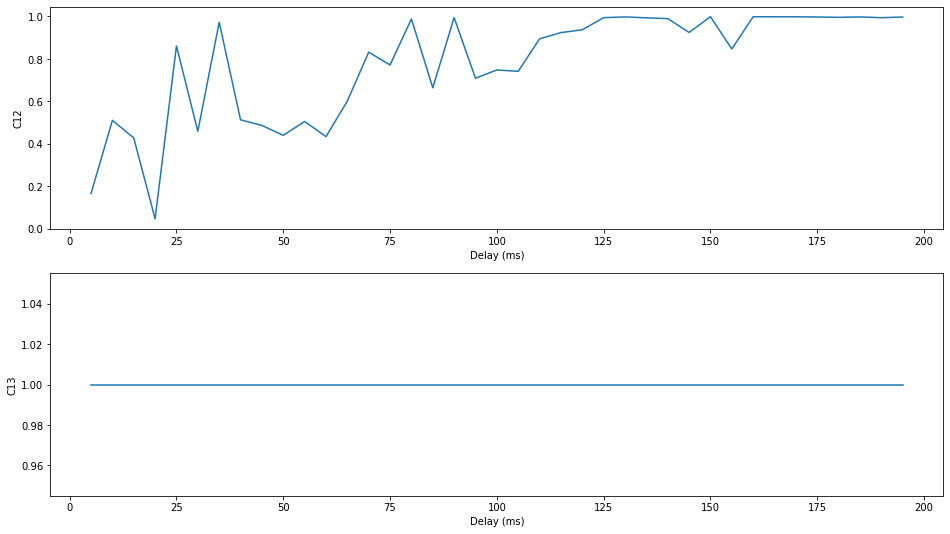

In [ ]:
fig, axs = plt1.subplots(2, figsize=(16,9))
print(f"Lateral Delay: {lateralDelay}, del1: {del1}, del2: {del2}, i1: {i1}, i2: {i2}")
axs[0].plot([i for i in range(5,200,5)], covListB[::2])
axs[0].set_xlabel('Delay (ms)')
axs[0].set_ylabel('C12')
axs[1].plot([i for i in range(5,200,5)], covListB[1::2])
axs[1].set_xlabel('Delay (ms)')
axs[1].set_ylabel('C13')
plt1.show(fig)

In [ ]:
# covariance
import pandas as pd
def crosscorr(datax, datay, lag=0, wrap=False):
    """ Lag-N cross correlation. 
    Shifted data filled with NaNs 
    
    Parameters
    ----------
    lag : int, default 0
    datax, datay : pandas.Series objects of equal length
    Returns
    ----------
    crosscorr : float
    """
    if wrap:
        shiftedy = datay.shift(lag)
        shiftedy.iloc[:lag] = datay.iloc[-lag:].values
        return datax.corr(shiftedy)
    else: 
        return datax.corr(datay.shift(lag))

In [ ]:
covListB = []
covListA = []
for i in range(5, 200, 5):
    lateralDelay = i
    extra = 1
    L1 = LATERAL(sets, weights)
    # print('delay = ', la, 'ms')
    # print('Covariance matrix:')
    covListB.append(printCov(0,1))
    covListB.append(printCov(0,2))

In [ ]:
i1 = 0.8
i2 = 2
sets = 3
weights = np.random.uniform(0.5,1,15)
weight = 0.53
del1 = 6
del2 = 2
lateralDelay = 65

Lateral Delay: 65, del1: 100, del2: 2, i1: 0.8, i2: 2


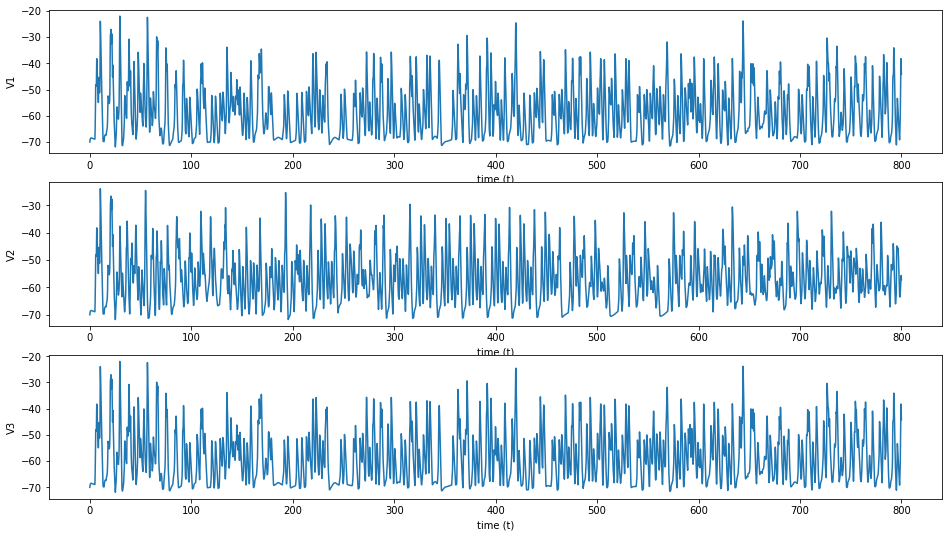

Length of V1 32001


No handles with labels found to put in legend.


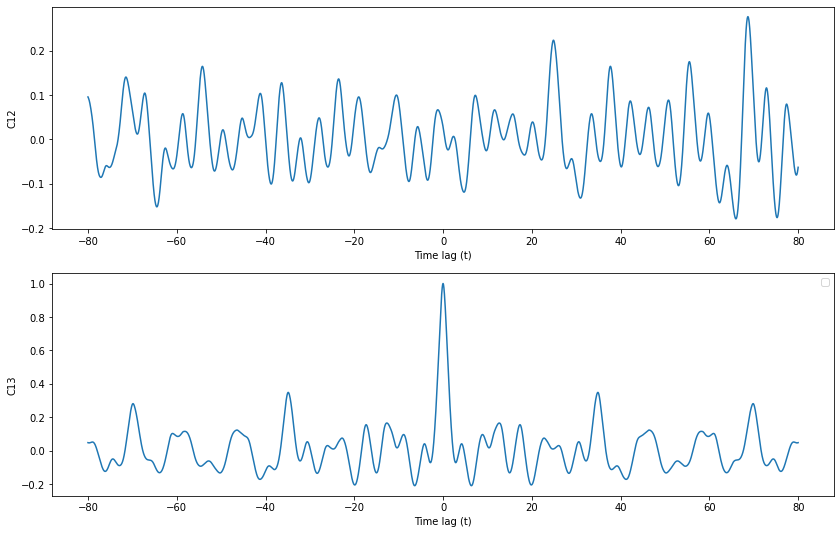

In [ ]:
import pandas as pd

L1 = LATERAL(sets, weights)
print(f"Lateral Delay: {lateralDelay}, del1: {del1}, del2: {del2}, i1: {i1}, i2: {i2}")
V1 , V2, V3 = [], [], []
V1.append(h.Vector().record(L1.sets[0].P1.axon(0.5)._ref_v))
V1.append(h.Vector().record(L1.sets[0].P2.axon(0.5)._ref_v))

V2.append(h.Vector().record(L1.sets[1].P1.axon(0.5)._ref_v))
V2.append(h.Vector().record(L1.sets[1].P2.axon(0.5)._ref_v))

V3.append(h.Vector().record(L1.sets[2].P1.axon(0.5)._ref_v))
V3.append(h.Vector().record(L1.sets[2].P2.axon(0.5)._ref_v))

V1.append(h.Vector().record(L1.sets[0].M1.axon(0.5)._ref_v))
V1.append(h.Vector().record(L1.sets[0].M2.axon(0.5)._ref_v))
V1.append(h.Vector().record(L1.sets[0].G1.axon(0.5)._ref_v))
V1.append(h.Vector().record(L1.sets[0].G2.axon(0.5)._ref_v))

V2.append(h.Vector().record(L1.sets[1].M1.axon(0.5)._ref_v))
V2.append(h.Vector().record(L1.sets[1].M2.axon(0.5)._ref_v))
V2.append(h.Vector().record(L1.sets[1].G1.axon(0.5)._ref_v))
V2.append(h.Vector().record(L1.sets[1].G2.axon(0.5)._ref_v))

V3.append(h.Vector().record(L1.sets[2].M1.axon(0.5)._ref_v))
V3.append(h.Vector().record(L1.sets[2].M2.axon(0.5)._ref_v))
V3.append(h.Vector().record(L1.sets[2].G1.axon(0.5)._ref_v))
V3.append(h.Vector().record(L1.sets[2].G2.axon(0.5)._ref_v))

t = h.Vector().record(h._ref_t)
h.finitialize(-70*mV)
h.continuerun(800*ms)
V1Mean = np.mean(V1, axis=0)
V2Mean = np.mean(V2, axis=0)
V3Mean = np.mean(V3, axis=0)
fig, axs = plt1.subplots(3, figsize=(16,9))
axs[0].plot(t, list(V1Mean))
axs[0].set_xlabel('time (t)')
axs[0].set_ylabel('V1')
axs[1].plot(t, list(V2Mean))
axs[1].set_xlabel('time (t)')
axs[1].set_ylabel('V2')
axs[2].plot(t, list(V3Mean))
axs[2].set_xlabel('time (t)')
axs[2].set_ylabel('V3')
plt1.show(fig)
d1 = pd.DataFrame(V1Mean, columns=['voltage'])
d2 = pd.DataFrame(V2Mean, columns=['voltage'])
d3 = pd.DataFrame(V3Mean, columns=['voltage'])
# print(d1,d2,d3)
print("Length of V1",len(V1[0]))
lim = int(80*len(V1[0])/1000)
c12 = [crosscorr(d1['voltage'],d2['voltage'], lag) for lag in range(-int(lim),int(lim+1))]
c13 = [crosscorr(d1['voltage'],d3['voltage'], lag) for lag in range(-int(lim),int(lim+1))]
# ffset = np.floor(len(rs)/2)-np.argmax(rs)
f,ax=plt1.subplots(2, figsize=(14,9))
ax[0].plot([80*i/lim for i in range(-lim,lim+1)], c12)
ax[0].set_xlabel('Time lag (t)')
ax[0].set_ylabel('C12')
ax[1].plot([80*i/lim for i in range(-lim,lim+1)], c13)
ax[1].set_xlabel('Time lag (t)')
ax[1].set_ylabel('C13')

# ax.axvline(np.ceil(len(rs)/2),color='k',linestyle='--',label='Center')
# ax.axvline(np.argmax(rs),color='r',linestyle='--',label='Peak synchrony')
# ax.set(title=f'Offset = {offset} frames\nS1 leads <> S2 leads',ylim=[.1,.31],xlim=[0,301], xlabel='Offset',ylabel='Pearson r')
# ax.set_xticklabels([-150, -100, -50, 0, 50, 100, 150]);
plt1.legend()

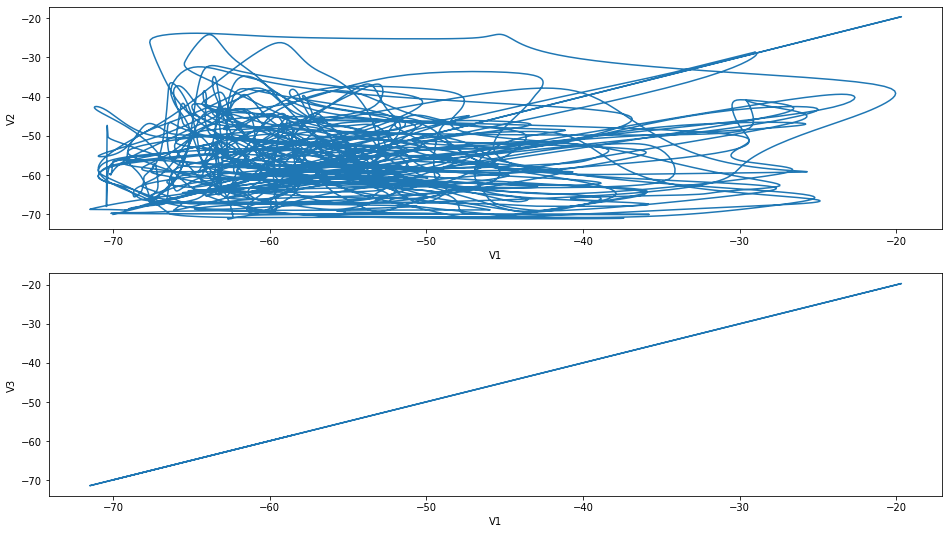

In [ ]:
fig, axs = plt1.subplots(2, figsize=(16,9))
axs[0].plot(list(V1Mean), list(V2Mean))
axs[0].set_xlabel('V1')
axs[0].set_ylabel('V2')
axs[1].plot(list(V1Mean), list(V3Mean))
axs[1].set_xlabel('V1')
axs[1].set_ylabel('V3')
plt1.show(fig)

# brute forcing to figure out fig 4

In [ ]:
# %matplotlib inline
# weights = [0.5 for i in range(11)]
# lateralDelay = 45
# for del2 in np.arange(0.1,2.1,0.1).round(2):
#     for del1 in np.arange(0.1, 2.1, 0.1).round(2):
#         for i1 in np.arange(0.2, 0.9, 0.1).round(2):
#             L1 = LATERAL(sets, weights)
#             V1 , V2, V3 = [], [], []
#             V1.append(h.Vector().record(L1.sets[0].P1.axon(0.5)._ref_v))
#             V1.append(h.Vector().record(L1.sets[0].P2.axon(0.5)._ref_v))

#             V2.append(h.Vector().record(L1.sets[1].P1.axon(0.5)._ref_v))
#             V2.append(h.Vector().record(L1.sets[1].P2.axon(0.5)._ref_v))

#             V3.append(h.Vector().record(L1.sets[2].P1.axon(0.5)._ref_v))
#             V3.append(h.Vector().record(L1.sets[2].P2.axon(0.5)._ref_v))

#             V1.append(h.Vector().record(L1.sets[0].M1.axon(0.5)._ref_v))
#             V1.append(h.Vector().record(L1.sets[0].M2.axon(0.5)._ref_v))
#             V1.append(h.Vector().record(L1.sets[0].G1.axon(0.5)._ref_v))
#             V1.append(h.Vector().record(L1.sets[0].G2.axon(0.5)._ref_v))

#             V2.append(h.Vector().record(L1.sets[1].M1.axon(0.5)._ref_v))
#             V2.append(h.Vector().record(L1.sets[1].M2.axon(0.5)._ref_v))
#             V2.append(h.Vector().record(L1.sets[1].G1.axon(0.5)._ref_v))
#             V2.append(h.Vector().record(L1.sets[1].G2.axon(0.5)._ref_v))
    
#             V3.append(h.Vector().record(L1.sets[2].M1.axon(0.5)._ref_v))
#             V3.append(h.Vector().record(L1.sets[2].M2.axon(0.5)._ref_v))
#             V3.append(h.Vector().record(L1.sets[2].G1.axon(0.5)._ref_v))
#             V3.append(h.Vector().record(L1.sets[2].G2.axon(0.5)._ref_v))
#             t = h.Vector().record(h._ref_t)
#             h.finitialize(-70*mV)
#             h.continuerun(200*ms)
#             V1Mean = np.mean(V1, axis=0)
#             V2Mean = np.mean(V2, axis=0)
#             V3Mean = np.mean(V3, axis=0)
#             # print(len(L1.sets[0].P1.spike_times), len(L1.sets[1].P1.spike_times))
#             if len(L1.sets[0].P1.spike_times) == len(L1.sets[1].P1.spike_times):
#                 print(f"Lateral Delay: {lateralDelay}, del1: {del1}, del2: {del2}, i1: {i1}, i2: {i2}")
#             elif list(L1.sets[0].P1.spike_times) == list(L1.sets[1].P1.spike_times):
#                 fig, axs = plt1.subplots(3, figsize=(16,9))
#                 axs[0].plot(t, list(V1Mean))
#                 axs[0].set_xlabel('time (t)')
#                 axs[0].set_ylabel('V1')
#                 axs[1].plot(t, list(V2Mean))
#                 axs[1].set_xlabel('time (t)')
#                 axs[1].set_ylabel('V2')
#                 axs[2].plot(t, list(V3Mean))
#                 axs[2].set_xlabel('time (t)')
#                 axs[2].set_ylabel('V3')
#                 plt1.show(fig)

In [ ]:
i1 = 2
i2 = 4
sets = 3
weights = np.random.uniform(0.05,0.1,15)
weight = 0.01
del1 = 4
del2 = 2
lateralDelay = 65

In [ ]:
class LATERALNOCONN:

    def __init__(self,N,weights):
        wMML=weights
        #wMML=0.1
        
        self.N = N
        self.th = -70
        self.maindelay = lateralDelay
        self.sets = []
        c=0
        for i in range(N):
            self.sets.append(CONNECTING(i,weights))


#Fig 5 Connections without coupling

In [ ]:
# #without coupling
# weights = [0.5 for i in range(11)]
# for weight in np.arange(0.01, 0.06, 0.01).round(2):
#     L1 = LATERALNOCONN(sets, weights)
#     print(f"Lateral Delay: {lateralDelay}, del1: {del1}, del2: {del2}, i1: {i1}, i2: {i2}, weight:{weight}")
#     V1 , V2, V3 = [], [], []
#     V1.append(h.Vector().record(L1.sets[0].P1.axon(0.5)._ref_v))
#     V1.append(h.Vector().record(L1.sets[0].P2.axon(0.5)._ref_v))

#     V2.append(h.Vector().record(L1.sets[1].P1.axon(0.5)._ref_v))
#     V2.append(h.Vector().record(L1.sets[1].P2.axon(0.5)._ref_v))

#     V3.append(h.Vector().record(L1.sets[2].P1.axon(0.5)._ref_v))
#     V3.append(h.Vector().record(L1.sets[2].P2.axon(0.5)._ref_v))

#     V1.append(h.Vector().record(L1.sets[0].M1.axon(0.5)._ref_v))
#     V1.append(h.Vector().record(L1.sets[0].M2.axon(0.5)._ref_v))
#     V1.append(h.Vector().record(L1.sets[0].G1.axon(0.5)._ref_v))
#     V1.append(h.Vector().record(L1.sets[0].G2.axon(0.5)._ref_v))

#     V2.append(h.Vector().record(L1.sets[1].M1.axon(0.5)._ref_v))
#     V2.append(h.Vector().record(L1.sets[1].M2.axon(0.5)._ref_v))
#     V2.append(h.Vector().record(L1.sets[1].G1.axon(0.5)._ref_v))
#     V2.append(h.Vector().record(L1.sets[1].G2.axon(0.5)._ref_v))

#     V3.append(h.Vector().record(L1.sets[2].M1.axon(0.5)._ref_v))
#     V3.append(h.Vector().record(L1.sets[2].M2.axon(0.5)._ref_v))
#     V3.append(h.Vector().record(L1.sets[2].G1.axon(0.5)._ref_v))
#     V3.append(h.Vector().record(L1.sets[2].G2.axon(0.5)._ref_v))
#     t = h.Vector().record(h._ref_t)
#     h.finitialize(-70*mV)
#     h.continuerun(200*ms)
#     V1Mean = np.mean(V1, axis=0)
#     V2Mean = np.mean(V2, axis=0)
#     V3Mean = np.mean(V3, axis=0)
#     fig, axs = plt1.subplots(3, figsize=(16,9))
#     axs[0].plot(t, list(V1Mean))
#     axs[0].set_xlabel('time (t)')
#     axs[0].set_ylabel('V1')
#     axs[1].plot(t, list(V2Mean))
#     axs[1].set_xlabel('time (t)')
#     axs[1].set_ylabel('V2')
#     axs[2].plot(t, list(V3Mean))
#     axs[2].set_xlabel('time (t)')
#     axs[2].set_ylabel('V3')
#     plt1.show(fig)
#     fig, axs = plt1.subplots(2, figsize=(16,9))
#     axs[0].plot(list(V1Mean), list(V2Mean))
#     axs[0].set_xlabel('V1 (mV)')
#     axs[0].set_ylabel('V2 (mV)')
#     axs[1].plot(list(V1Mean), list(V3Mean))
#     axs[1].set_xlabel('V1 (mV)')
#     axs[1].set_ylabel('V3 (mV)')
#     plt1.show(fig)

#Connections with coupling

Lateral Delay: 65, del1: 4, del2: 2, i1: 2, i2: 4, weight:0.01


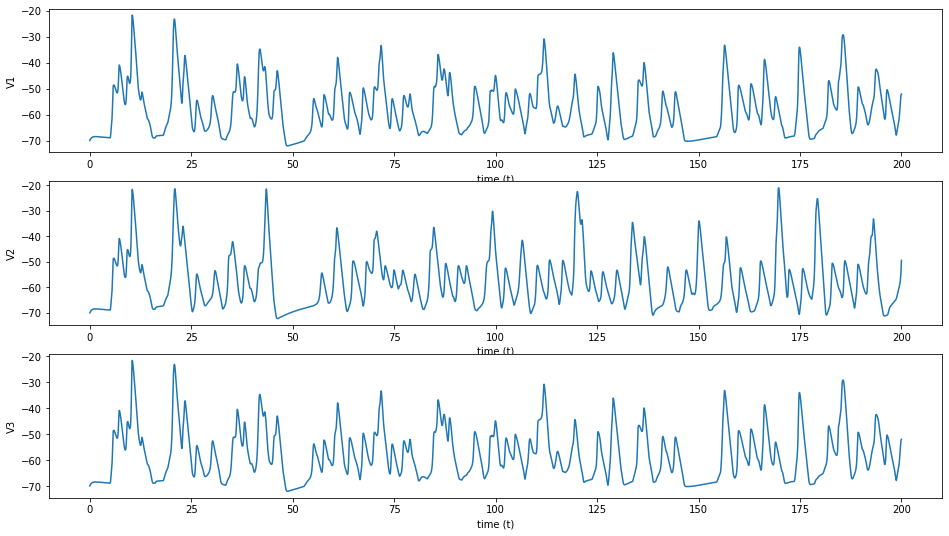

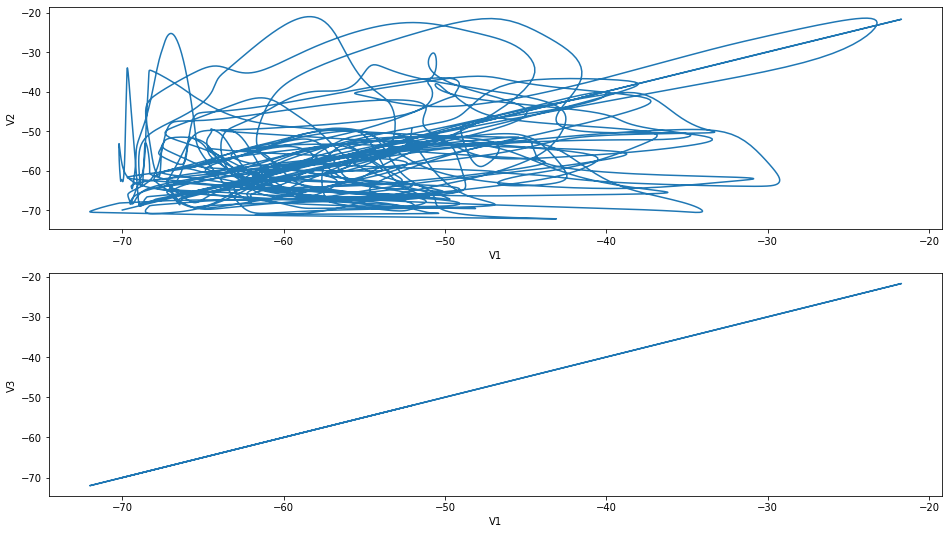

Lateral Delay: 65, del1: 4, del2: 2, i1: 2, i2: 4, weight:0.02


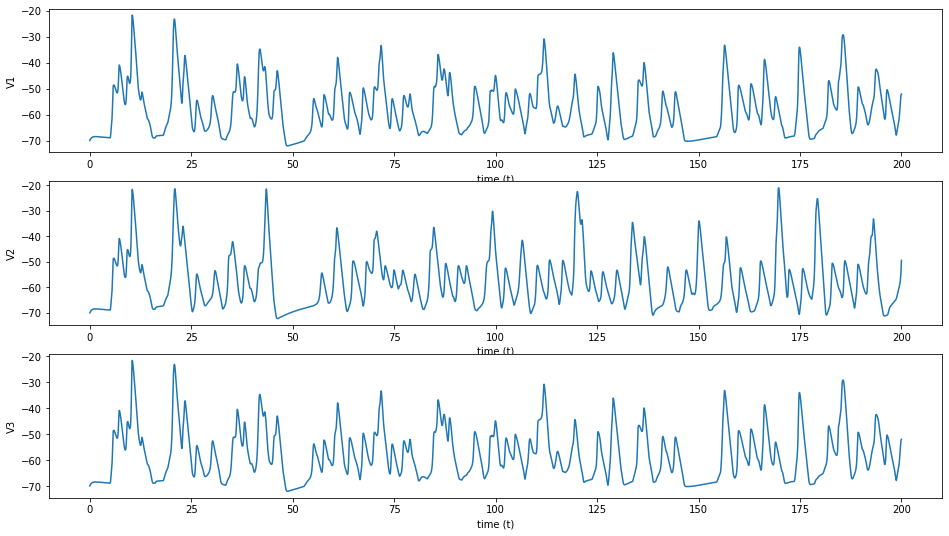

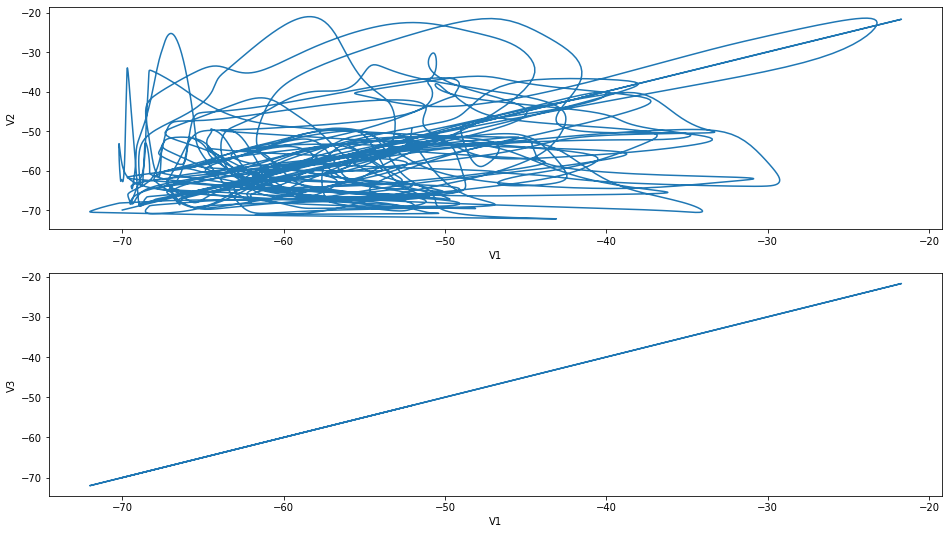

Lateral Delay: 65, del1: 4, del2: 2, i1: 2, i2: 4, weight:0.03


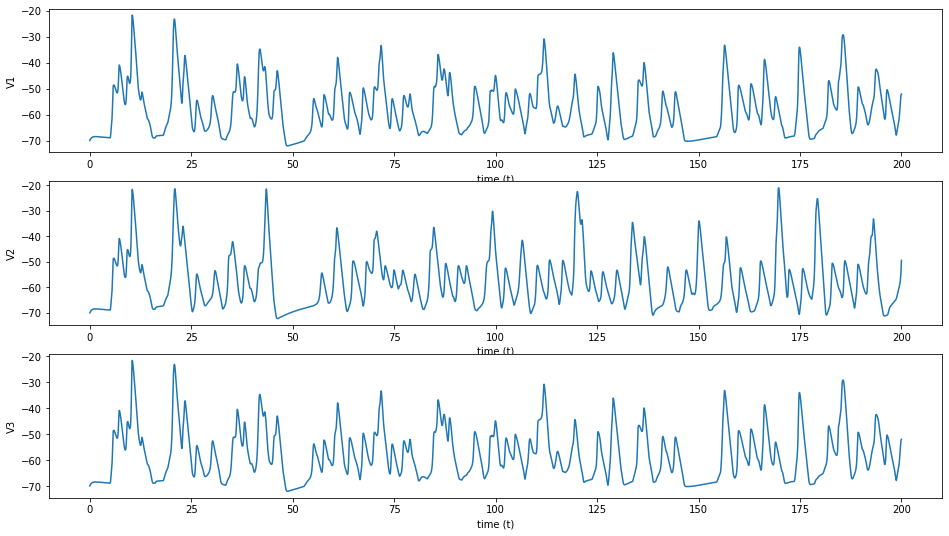

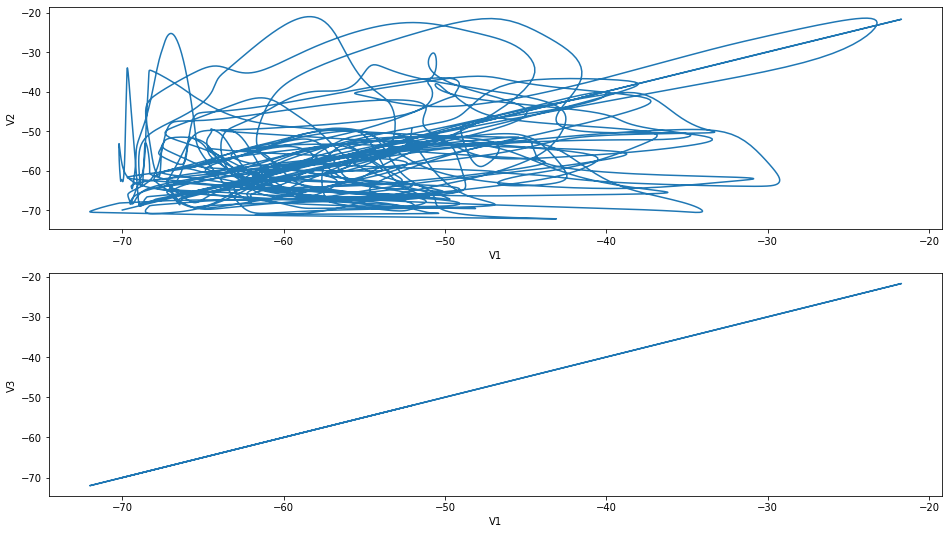

Lateral Delay: 65, del1: 4, del2: 2, i1: 2, i2: 4, weight:0.04


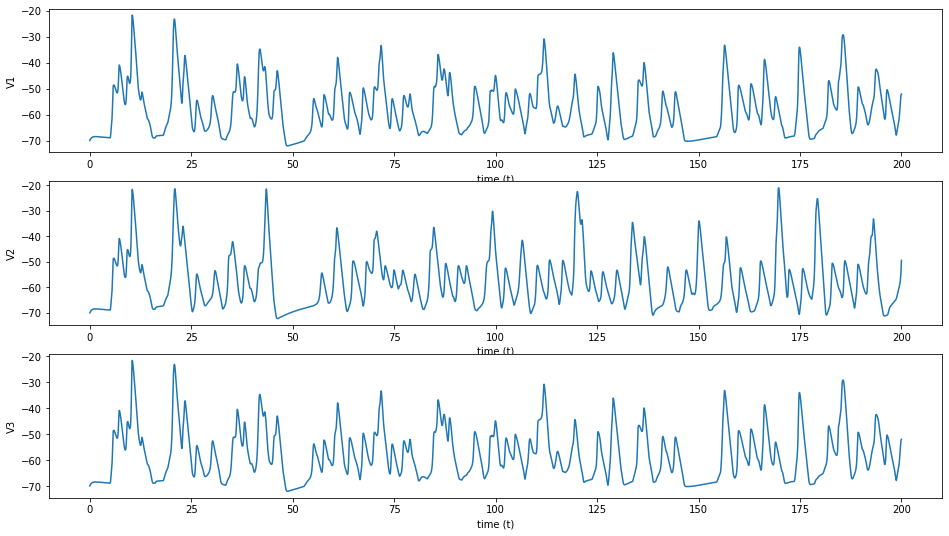

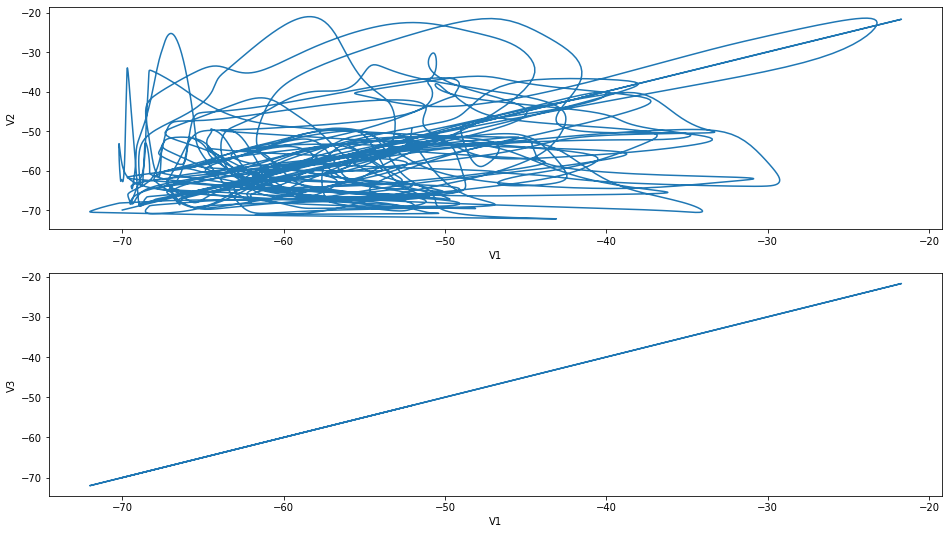

Lateral Delay: 65, del1: 4, del2: 2, i1: 2, i2: 4, weight:0.05


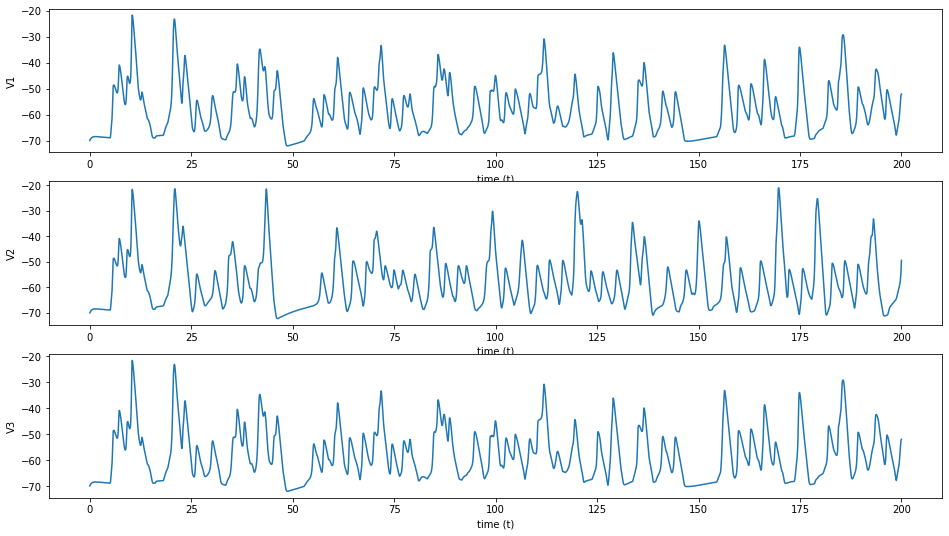

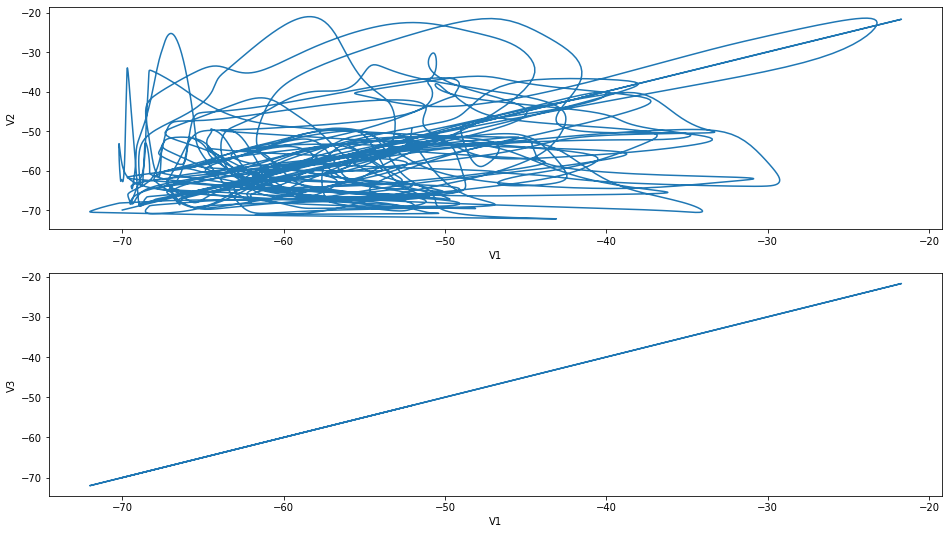

In [ ]:
#with coupling
weights = [0.5 for i in range(11)]
for weight in np.arange(0.01, 0.06, 0.01).round(2):
    L1 = LATERAL(sets, weights)
    print(f"Lateral Delay: {lateralDelay}, del1: {del1}, del2: {del2}, i1: {i1}, i2: {i2}, weight:{weight}")
    V1 , V2, V3 = [], [], []
    V1.append(h.Vector().record(L1.sets[0].P1.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].P2.axon(0.5)._ref_v))

    V2.append(h.Vector().record(L1.sets[1].P1.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].P2.axon(0.5)._ref_v))

    V3.append(h.Vector().record(L1.sets[2].P1.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].P2.axon(0.5)._ref_v))

    V1.append(h.Vector().record(L1.sets[0].M1.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].M2.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].G1.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].G2.axon(0.5)._ref_v))

    V2.append(h.Vector().record(L1.sets[1].M1.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].M2.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].G1.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].G2.axon(0.5)._ref_v))

    V3.append(h.Vector().record(L1.sets[2].M1.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].M2.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].G1.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].G2.axon(0.5)._ref_v))
    t = h.Vector().record(h._ref_t)
    h.finitialize(-70*mV)
    h.continuerun(200*ms)
    V1Mean = np.mean(V1, axis=0)
    V2Mean = np.mean(V2, axis=0)
    V3Mean = np.mean(V3, axis=0)
    fig, axs = plt1.subplots(3, figsize=(16,9))
    axs[0].plot(t, list(V1Mean))
    axs[0].set_xlabel('time (t)')
    axs[0].set_ylabel('V1')
    axs[1].plot(t, list(V2Mean))
    axs[1].set_xlabel('time (t)')
    axs[1].set_ylabel('V2')
    axs[2].plot(t, list(V3Mean))
    axs[2].set_xlabel('time (t)')
    axs[2].set_ylabel('V3')
    plt1.show(fig)
    h.finitialize(-70*mV)
    h.continuerun(200*ms)
    V1Mean = np.mean(V1, axis=0)
    V2Mean = np.mean(V2, axis=0)
    V3Mean = np.mean(V3, axis=0)
    fig, axs = plt1.subplots(2, figsize=(16,9))
    axs[0].plot(list(V1Mean), list(V2Mean))
    axs[0].set_xlabel('V1')
    axs[0].set_ylabel('V2')
    axs[1].plot(list(V1Mean), list(V3Mean))
    axs[1].set_xlabel('V1')
    axs[1].set_ylabel('V3')
    plt1.show(fig)

In [ ]:
i1 = 0.22
i2 = 0.5
sets = 3
weights = np.random.uniform(0.5,1,15)
weight = 0.01
del1 = 4
del2 = 2

Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 5


No handles with labels found to put in legend.


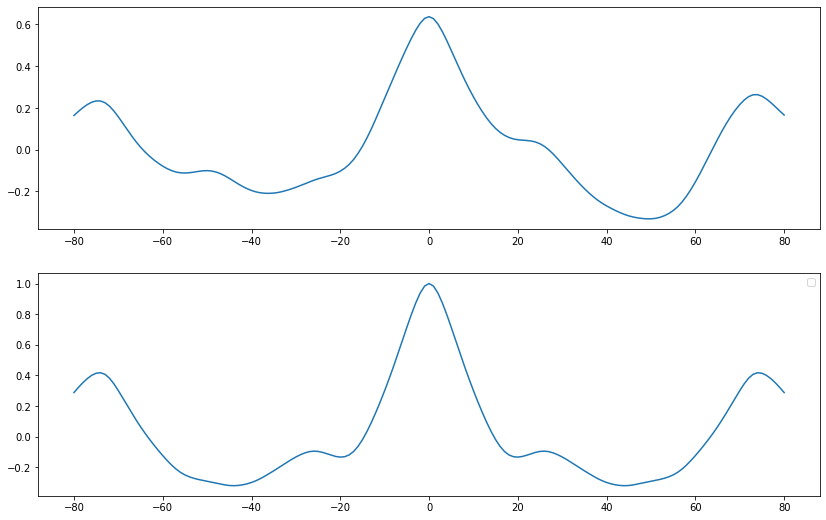

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 10


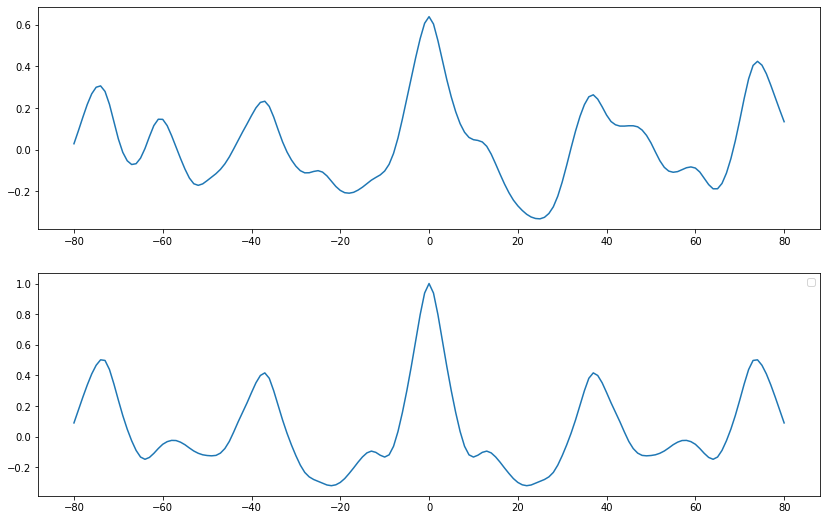

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 15


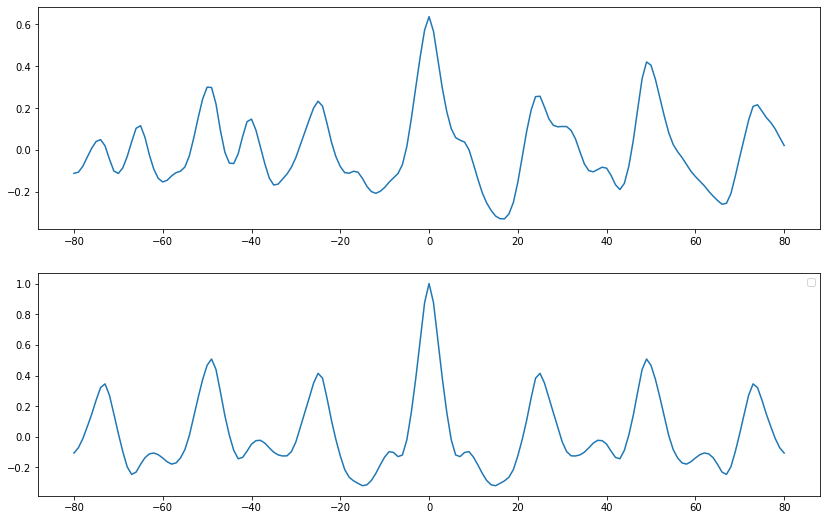

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 20


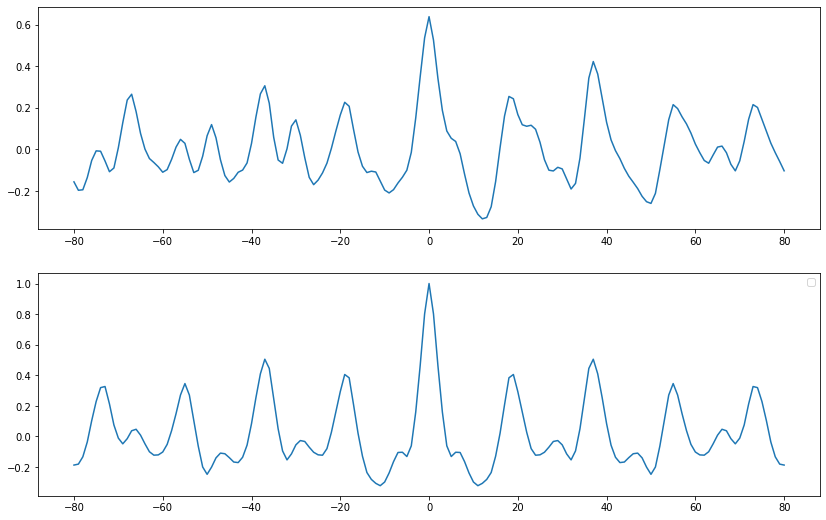

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 25


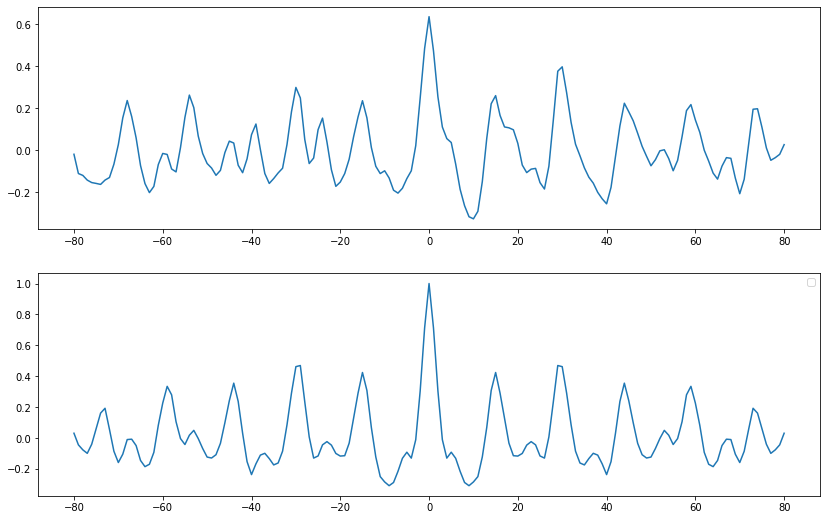

Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 30


No handles with labels found to put in legend.


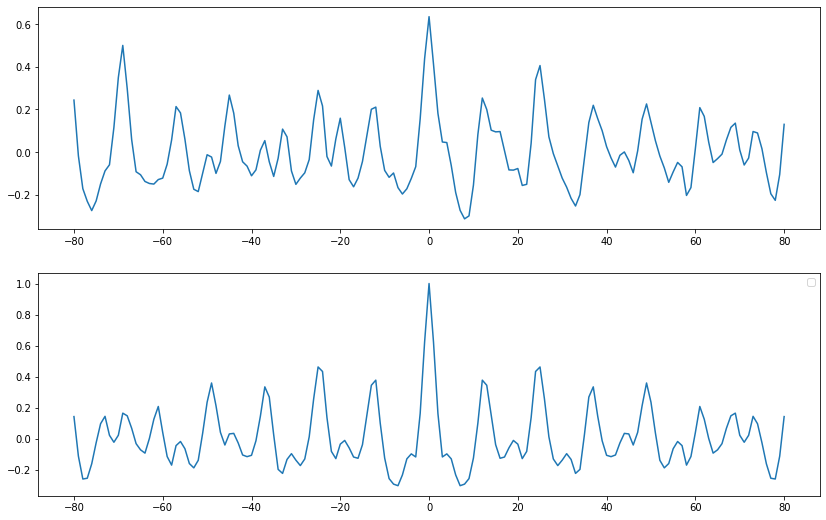

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 35


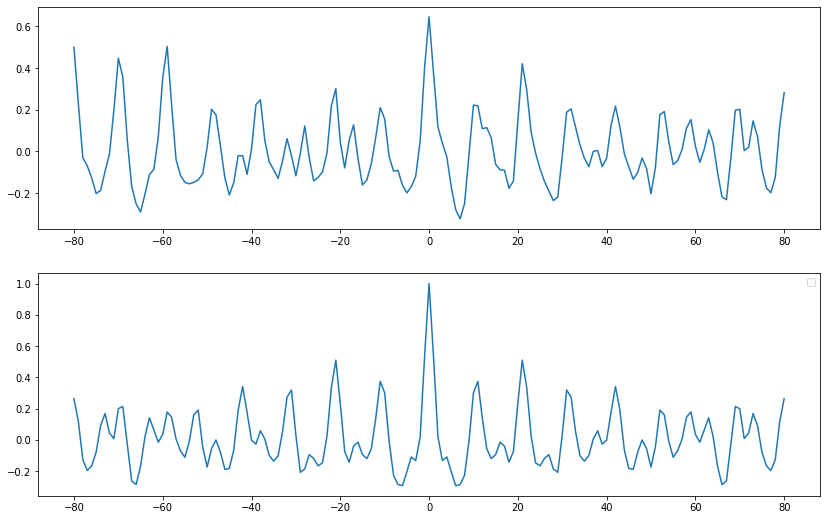

Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 40


No handles with labels found to put in legend.


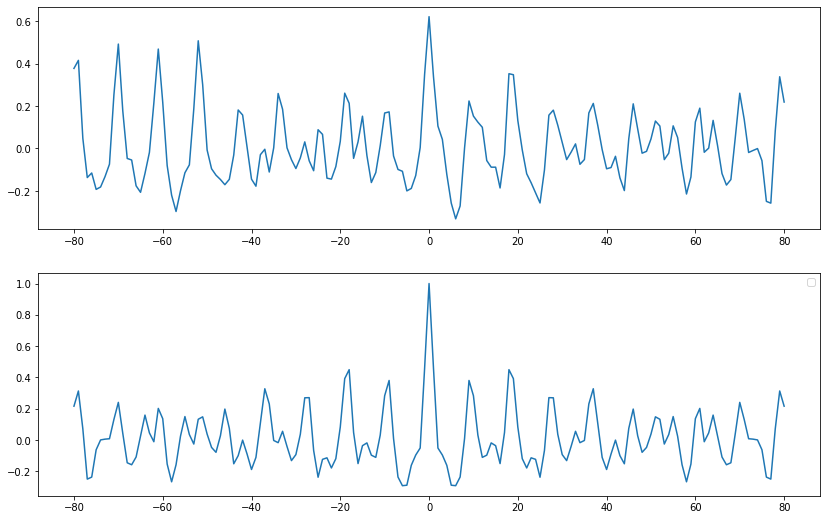

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 45


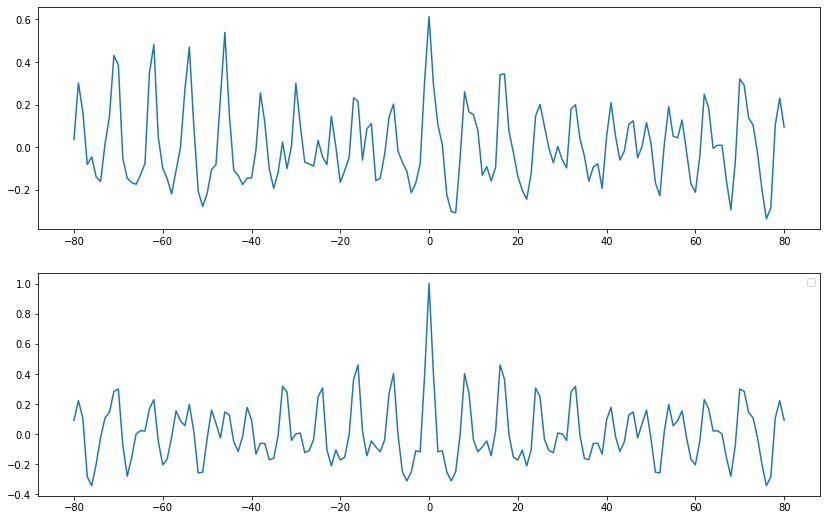

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 50


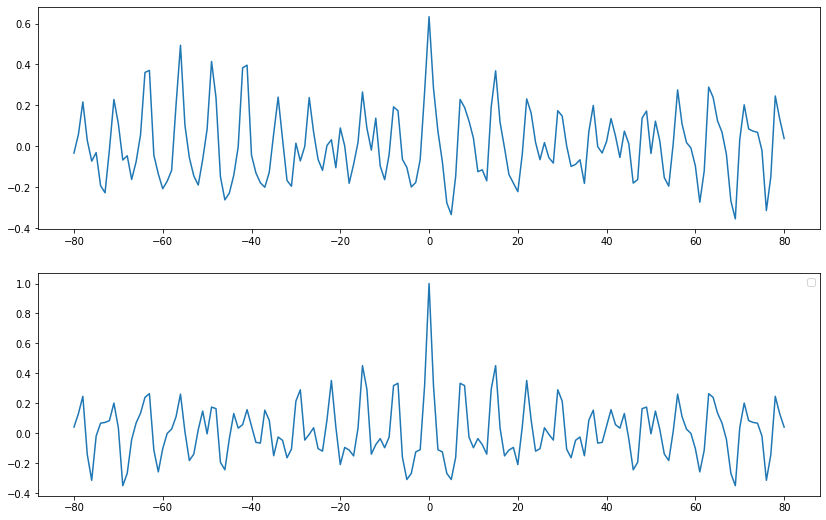

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 55


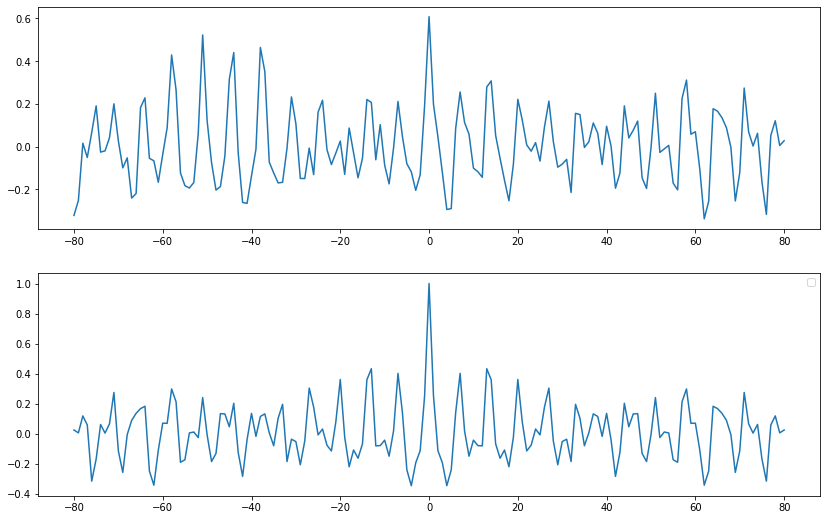

Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 60


No handles with labels found to put in legend.


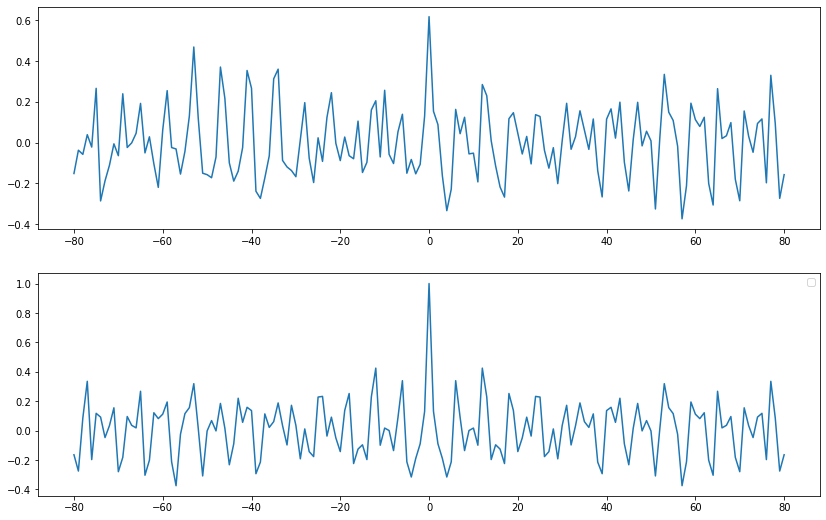

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 65


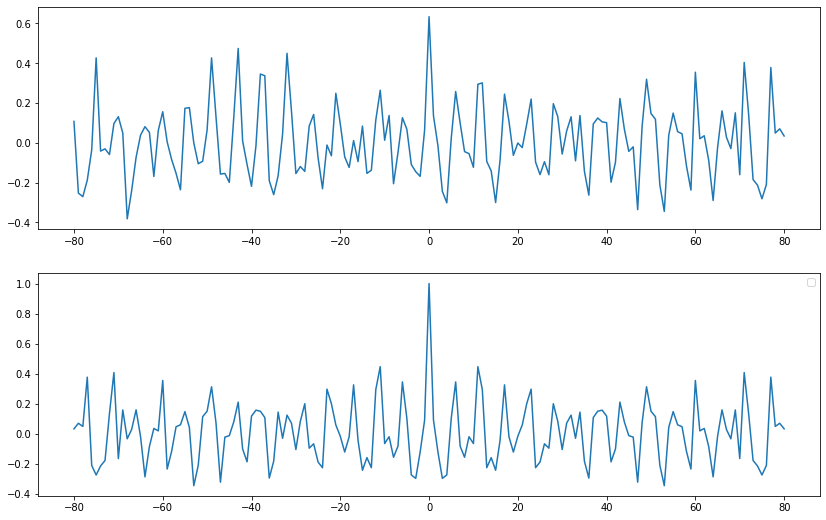

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 70


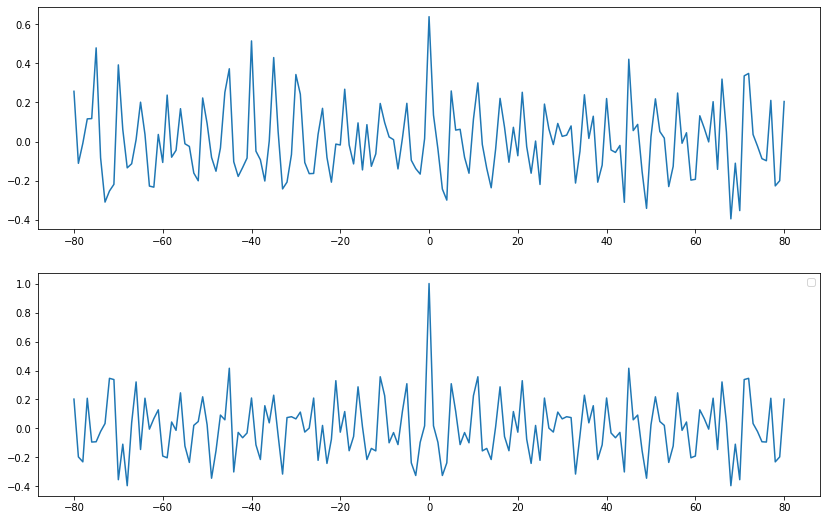

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 75


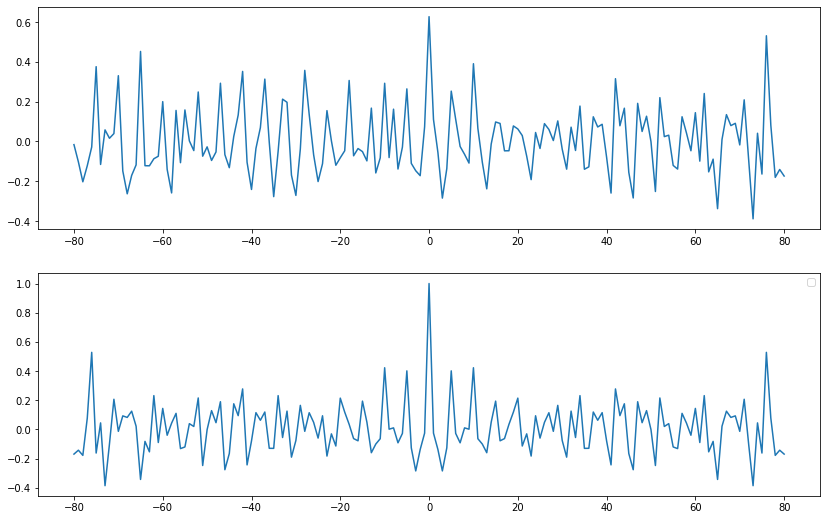

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 80


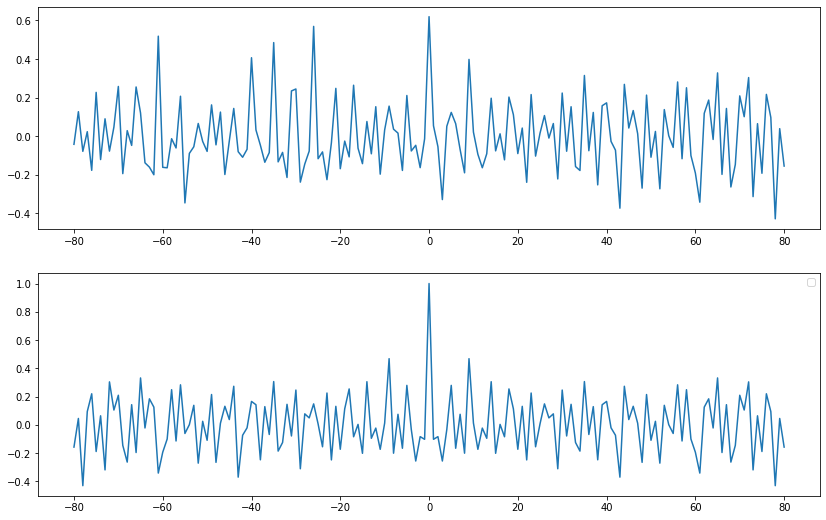

Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 85


No handles with labels found to put in legend.


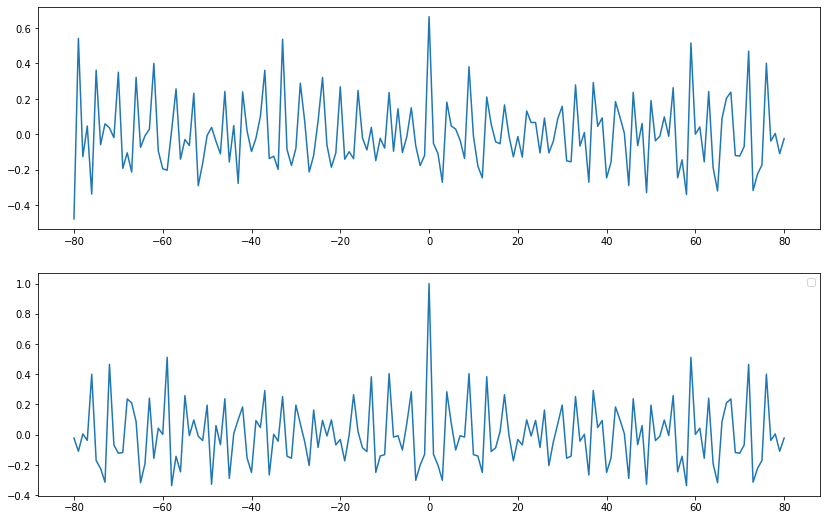

Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 90


No handles with labels found to put in legend.


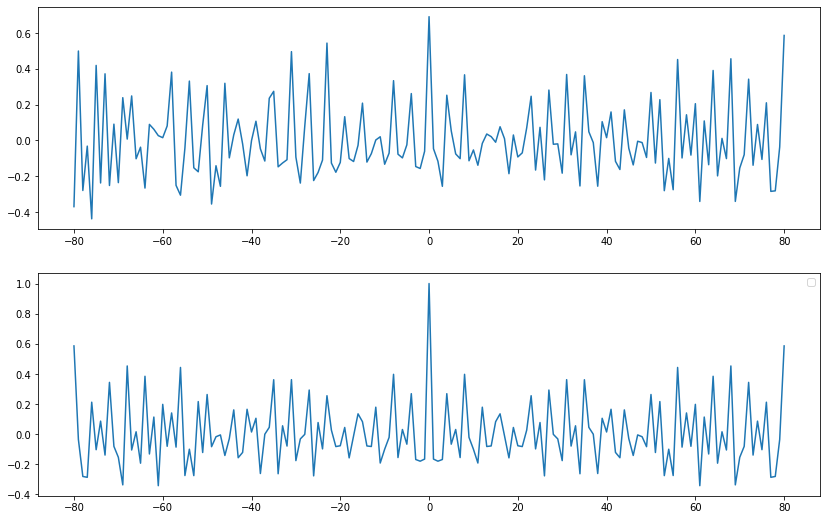

Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 95


No handles with labels found to put in legend.


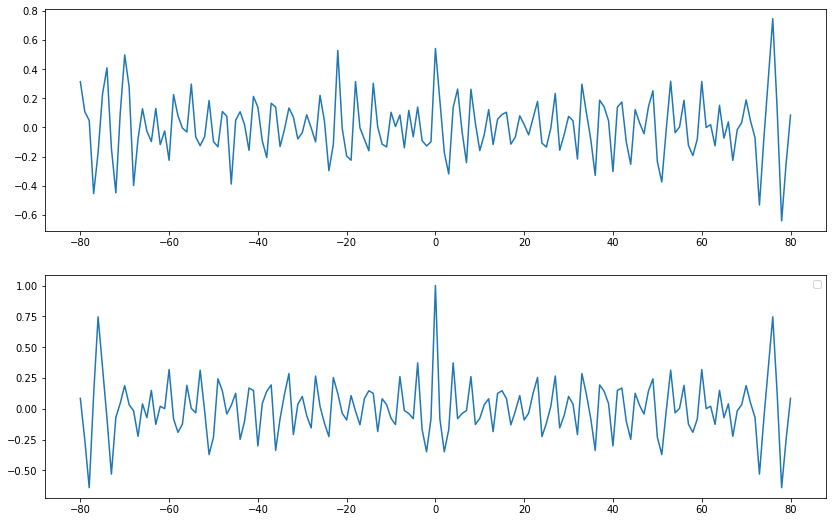

/usr/local/lib/python3.7/dist-packages/numpy/lib/function_base.py:2683: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
/usr/local/lib/python3.7/dist-packages/numpy/lib/function_base.py:2542: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 100


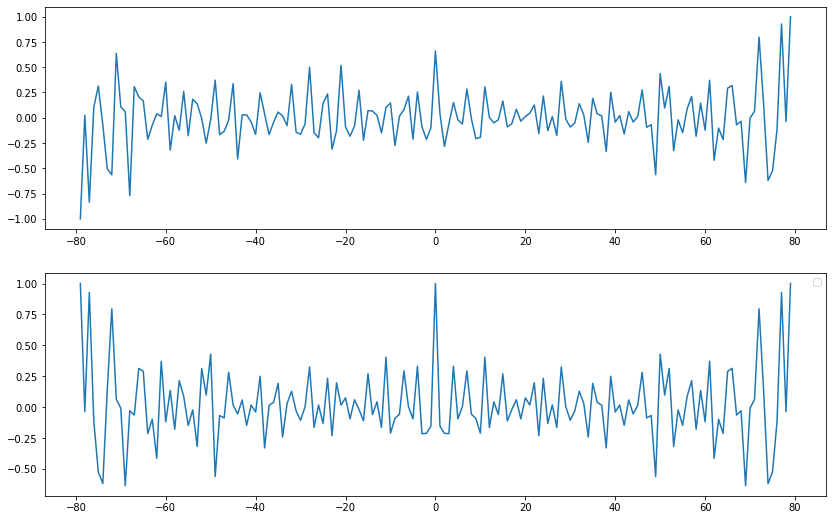

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 105


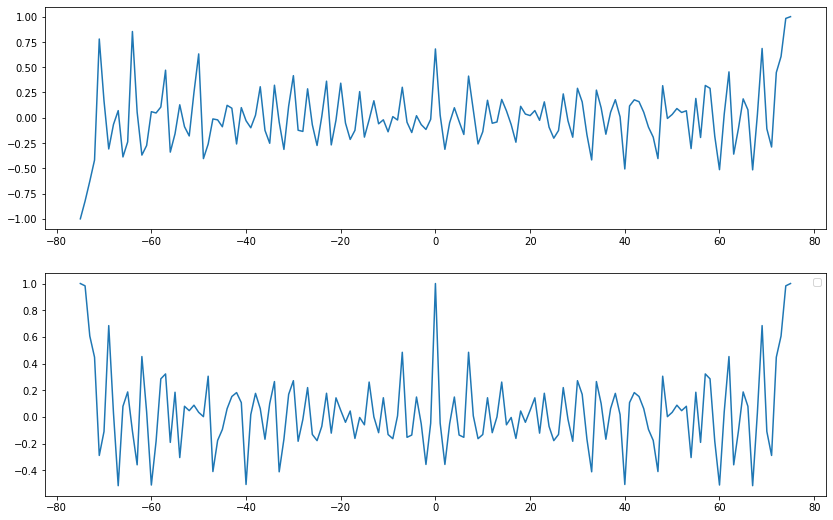

Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 110


No handles with labels found to put in legend.


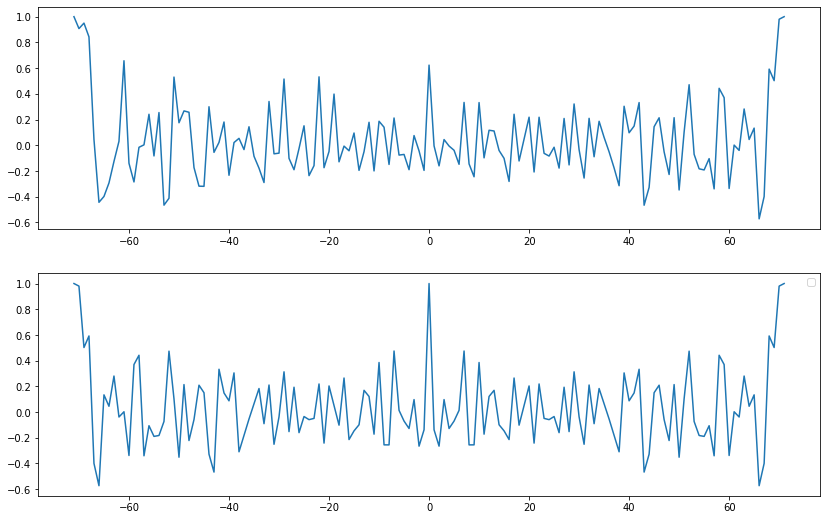

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 115


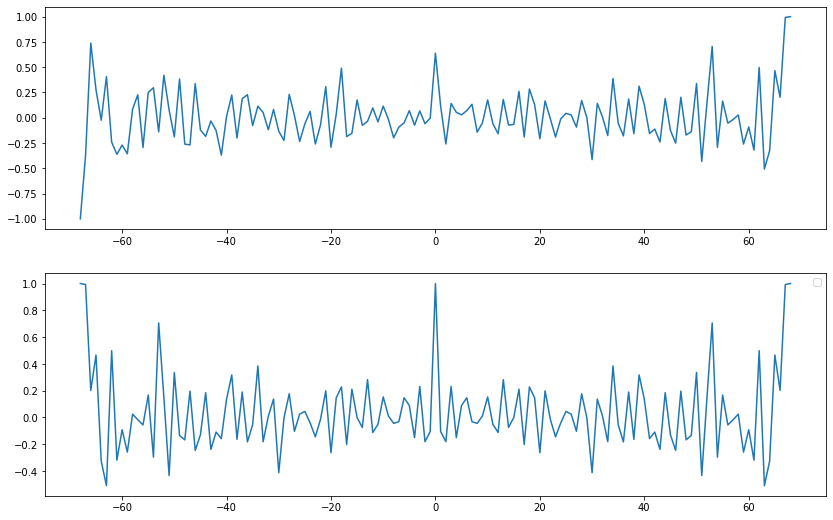

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 120


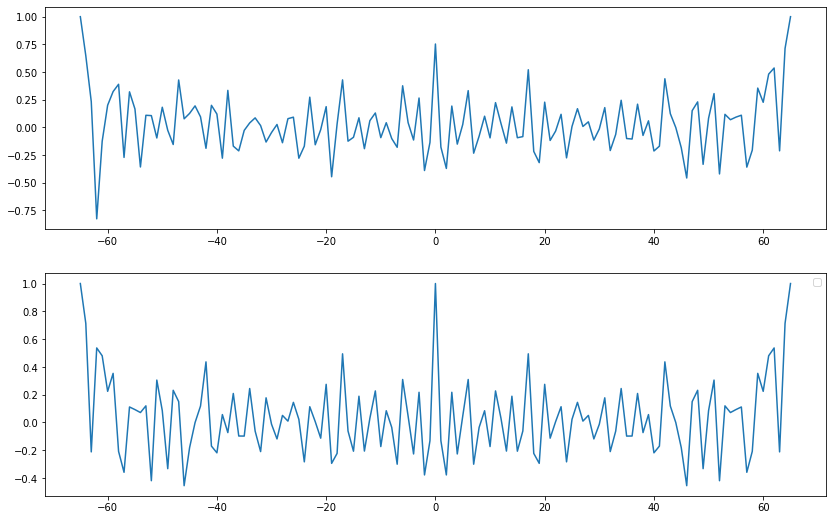

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 125


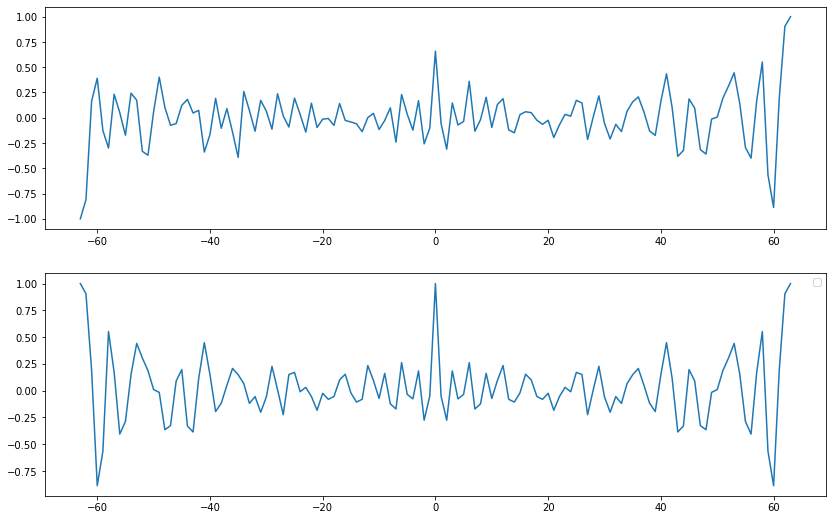

Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 130


No handles with labels found to put in legend.


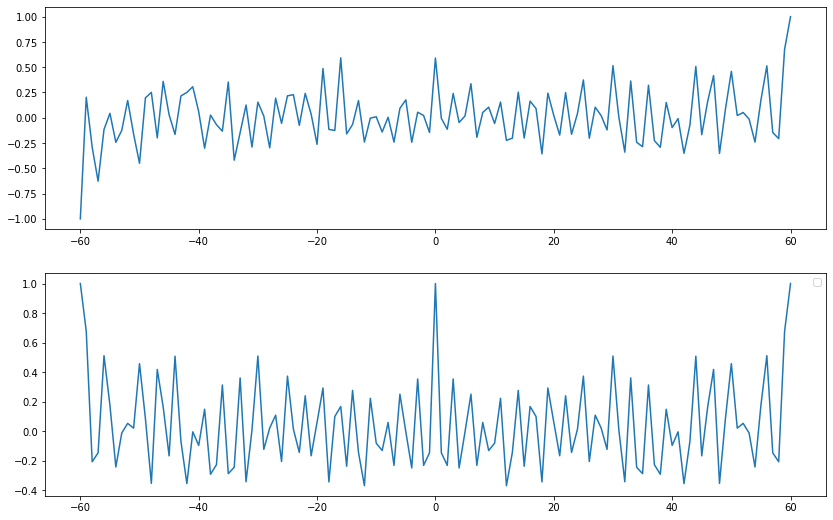

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 135


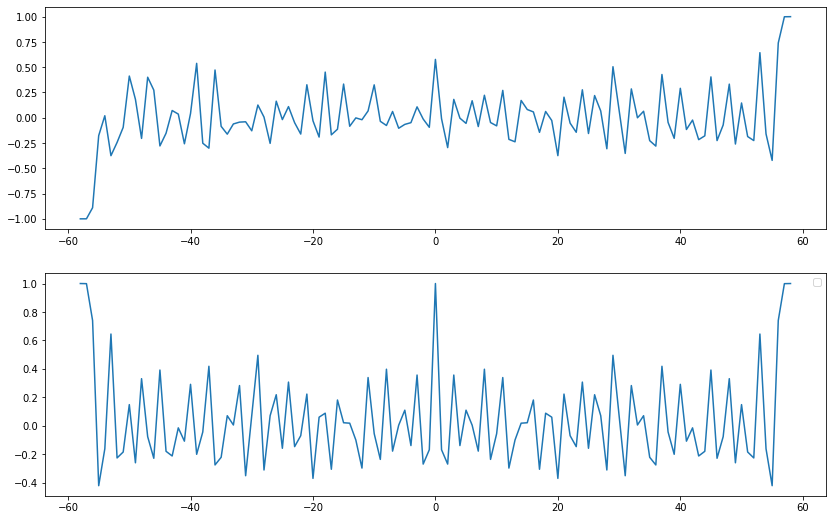

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 140


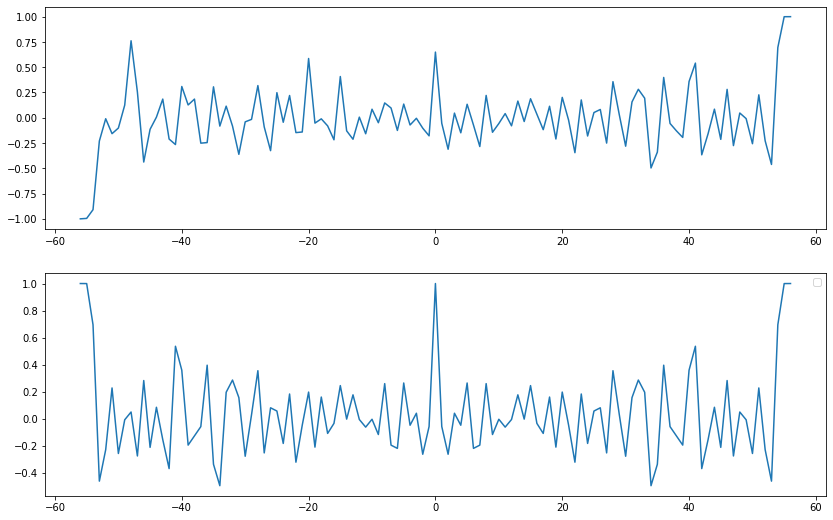

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 145


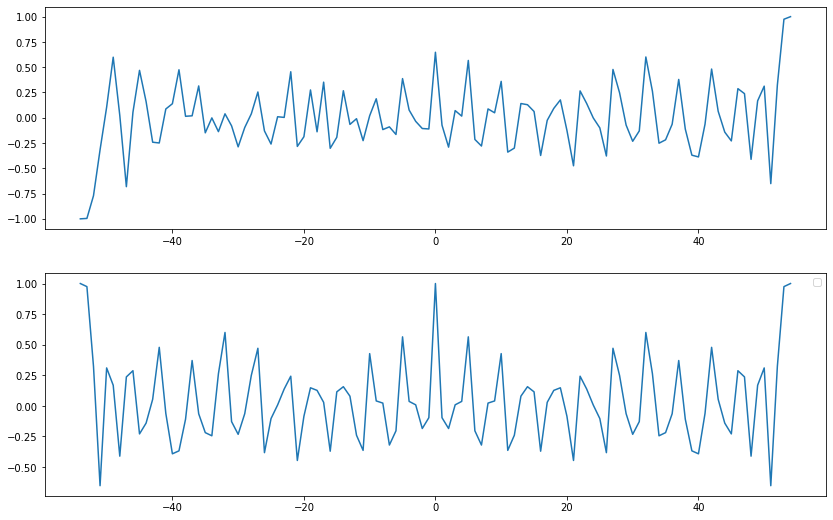

Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 150


No handles with labels found to put in legend.


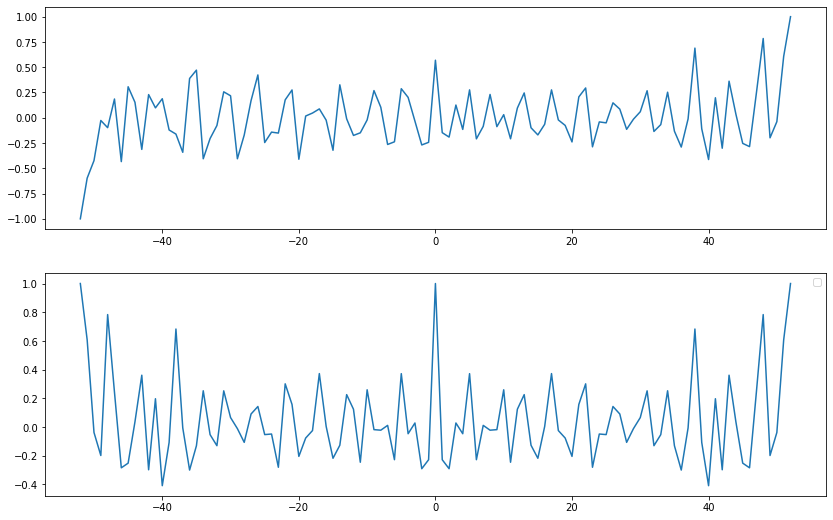

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 155


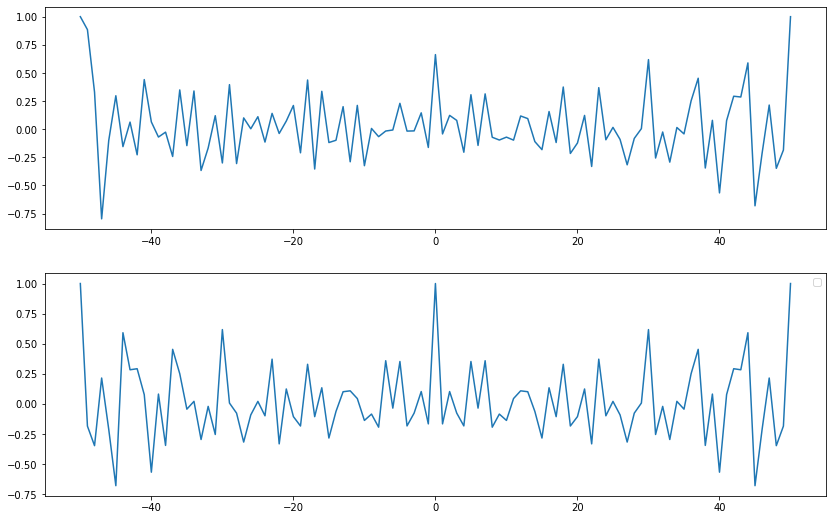

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 160


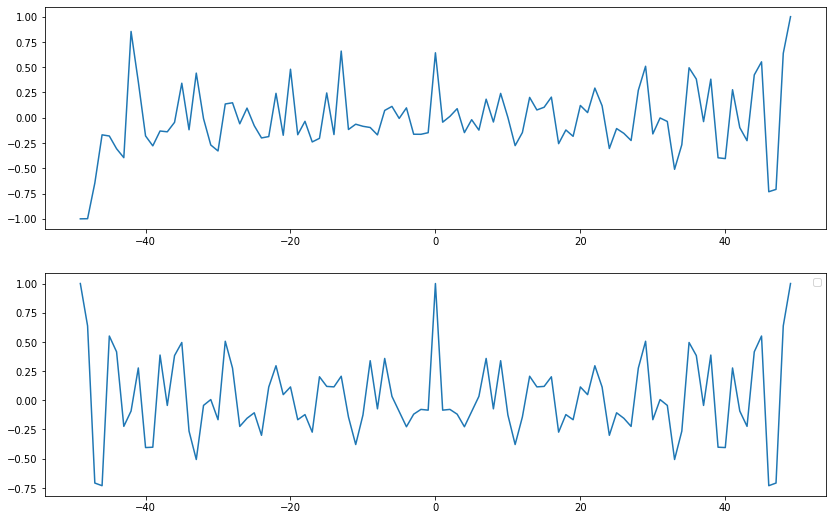

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 165


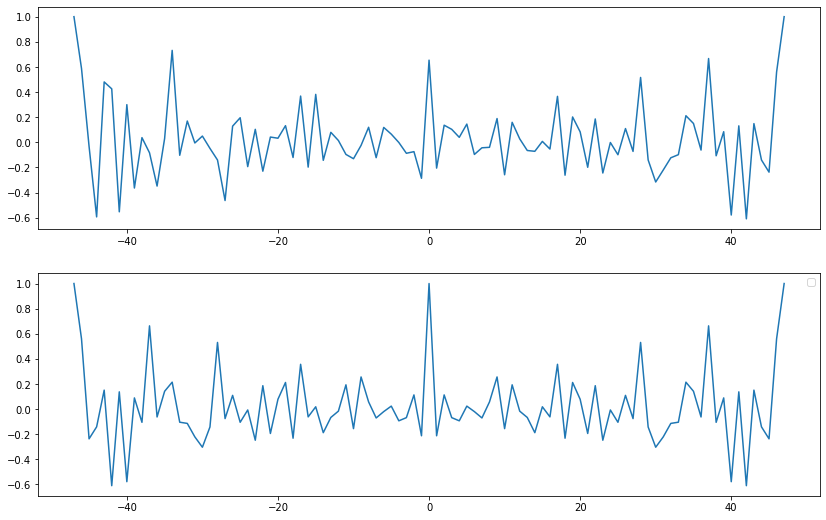

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 170


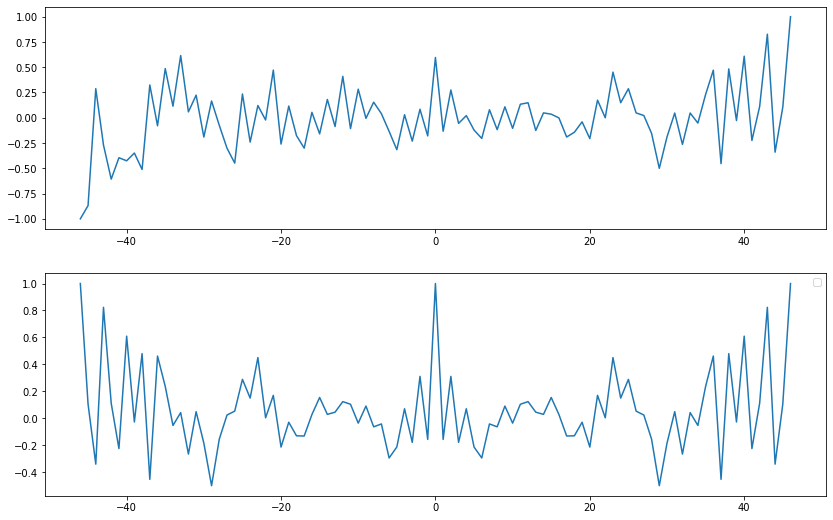

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 175


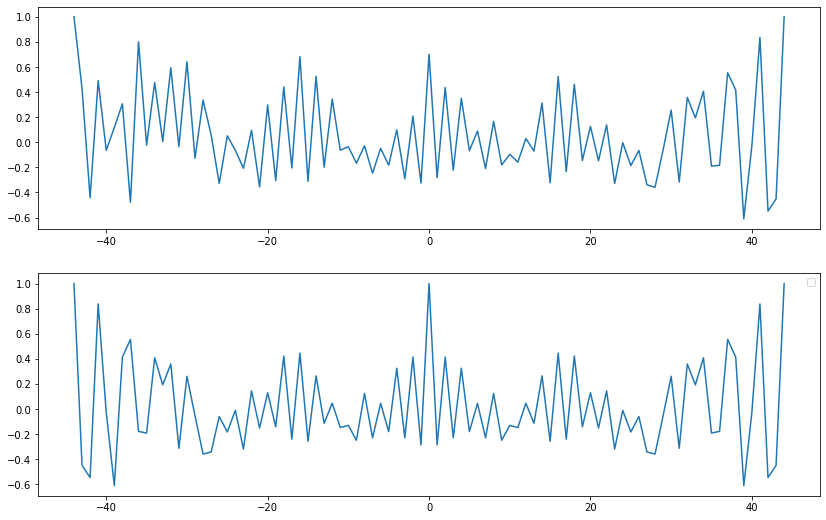

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 180


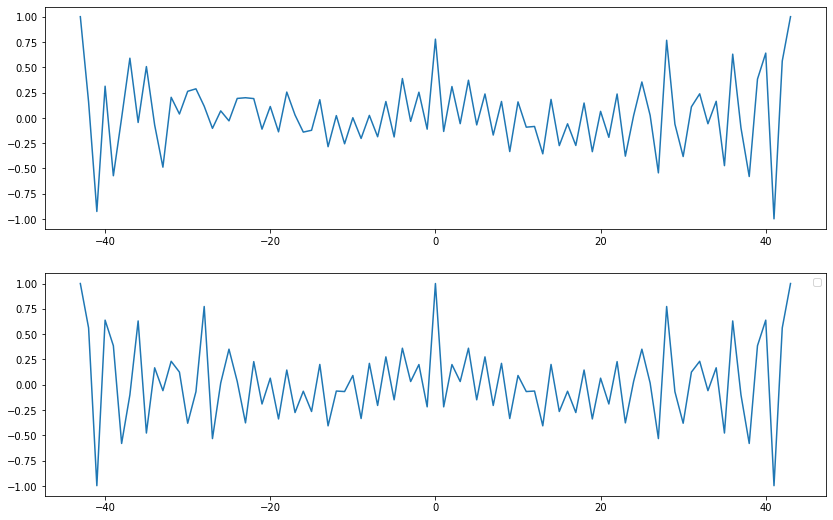

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 185


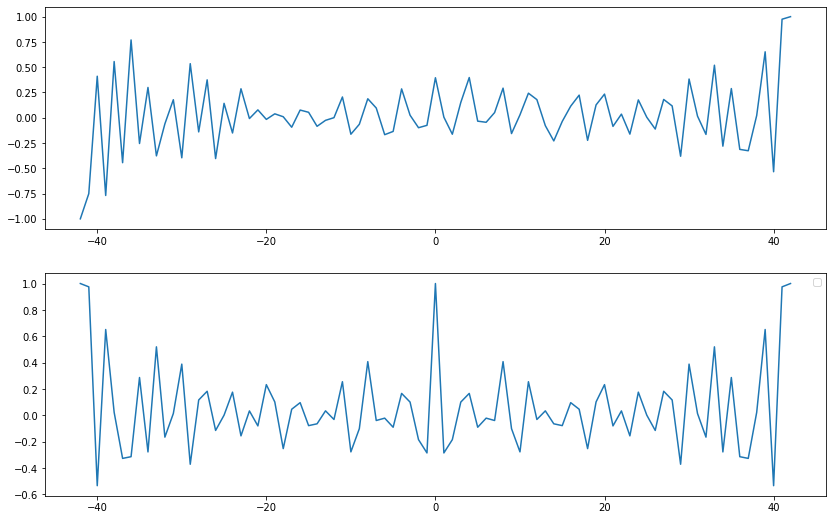

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 190


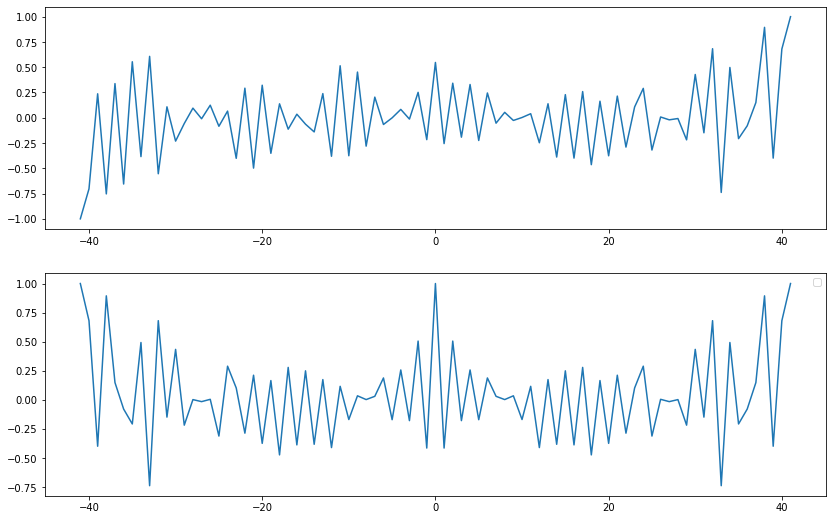

No handles with labels found to put in legend.


Lateral Delay: 50, del1: 4, del2: 2, i1: 0.22, i2: 0.5, skip: 195


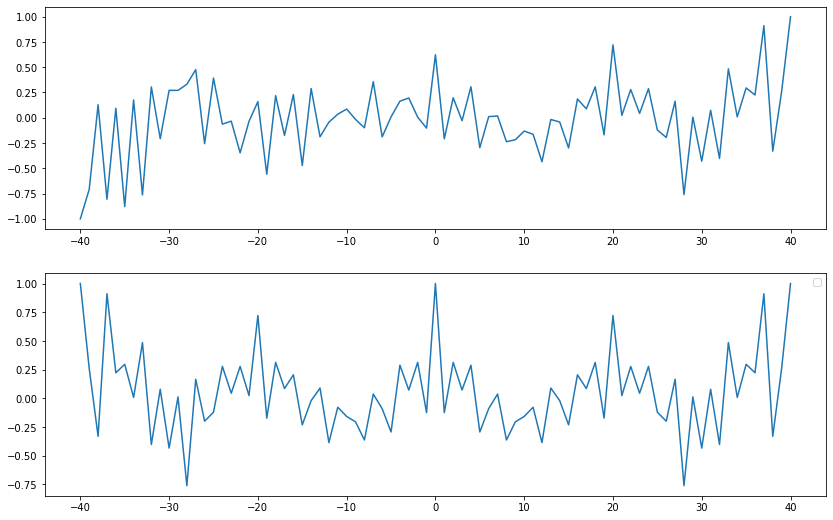

In [ ]:
# covariance
import pandas as pd
def crosscorr(datax, datay, lag=0, wrap=False):
    """ Lag-N cross correlation. 
    Shifted data filled with NaNs 
    
    Parameters
    ----------
    lag : int, default 0
    datax, datay : pandas.Series objects of equal length
    Returns
    ----------
    crosscorr : float
    """
    if wrap:
        shiftedy = datay.shift(lag)
        shiftedy.iloc[:lag] = datay.iloc[-lag:].values
        return datax.corr(shiftedy)
    else: 
        return datax.corr(datay.shift(lag))

lateralDelay = 50
for skip in range(5, 200, 5):
    L1 = LATERAL(sets, weights)
    print(f"Lateral Delay: {lateralDelay}, del1: {del1}, del2: {del2}, i1: {i1}, i2: {i2}, skip: {skip}")
    V1 , V2, V3 = [], [], []
    V1.append(h.Vector().record(L1.sets[0].P1.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].P2.axon(0.5)._ref_v))

    V2.append(h.Vector().record(L1.sets[1].P1.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].P2.axon(0.5)._ref_v))

    V3.append(h.Vector().record(L1.sets[2].P1.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].P2.axon(0.5)._ref_v))

    V1.append(h.Vector().record(L1.sets[0].M1.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].M2.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].G1.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].G2.axon(0.5)._ref_v))

    V2.append(h.Vector().record(L1.sets[1].M1.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].M2.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].G1.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].G2.axon(0.5)._ref_v))

    V3.append(h.Vector().record(L1.sets[2].M1.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].M2.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].G1.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].G2.axon(0.5)._ref_v))
    t = h.Vector().record(h._ref_t)
    h.finitialize(-70*mV)
    h.continuerun(200*ms)
    V1Mean = np.mean(V1, axis=0)
    V2Mean = np.mean(V2, axis=0)
    V3Mean = np.mean(V3, axis=0)
    d1 = pd.DataFrame(V1Mean[::skip], columns=['voltage'])
    d2 = pd.DataFrame(V2Mean[::skip], columns=['voltage'])
    d3 = pd.DataFrame(V3Mean[::skip], columns=['voltage'])
    # print(d1,d2,d3)
    lim = 80
    c12 = [crosscorr(d1['voltage'],d2['voltage'], lag) for lag in range(-int(lim),int(lim+1))]
    c13 = [crosscorr(d1['voltage'],d3['voltage'], lag) for lag in range(-int(lim),int(lim+1))]
    # ffset = np.floor(len(rs)/2)-np.argmax(rs)
    f,ax=plt1.subplots(2, figsize=(14,9))
    ax[0].plot([i for i in range(-lim,lim+1)], c12)
    ax[1].plot([i for i in range(-lim,lim+1)], c13)
    # ax.axvline(np.ceil(len(rs)/2),color='k',linestyle='--',label='Center')
    # ax.axvline(np.argmax(rs),color='r',linestyle='--',label='Peak synchrony')
    # ax.set(title=f'Offset = {offset} frames\nS1 leads <> S2 leads',ylim=[.1,.31],xlim=[0,301], xlabel='Offset',ylabel='Pearson r')
    # ax.set_xticklabels([-150, -100, -50, 0, 50, 100, 150]);
    plt1.legend()
    plt1.show()

[-70.         -69.9018135  -69.80864762 ... -16.4560026  -16.21781377
 -16.1176764 ] [-70.         -69.9018135  -69.80864762 ... -16.4560026  -16.21781377
 -16.1176764 ]


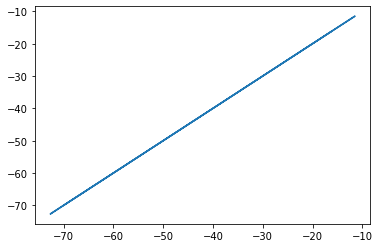

In [ ]:
import numpy as np
arr1 = []
arr3 = []
L1 = LATERAL(sets, weights)
arr1.append(h.Vector().record(L1.sets[0].P1.axon(0.5)._ref_v))
arr1.append(h.Vector().record(L1.sets[0].P2.axon(0.5)._ref_v))
arr1.append(h.Vector().record(L1.sets[0].M1.axon(0.5)._ref_v))
arr1.append(h.Vector().record(L1.sets[0].M2.axon(0.5)._ref_v))
arr1.append(h.Vector().record(L1.sets[0].G1.axon(0.5)._ref_v))
arr1.append(h.Vector().record(L1.sets[0].G2.axon(0.5)._ref_v))
arr3.append(h.Vector().record(L1.sets[2].P1.axon(0.5)._ref_v))
arr3.append(h.Vector().record(L1.sets[2].P2.axon(0.5)._ref_v))
arr3.append(h.Vector().record(L1.sets[2].M1.axon(0.5)._ref_v))
arr3.append(h.Vector().record(L1.sets[2].M2.axon(0.5)._ref_v))
arr3.append(h.Vector().record(L1.sets[2].G1.axon(0.5)._ref_v))
arr3.append(h.Vector().record(L1.sets[2].G2.axon(0.5)._ref_v))
h.finitialize(-70*mV)
h.continuerun(300*ms)
arr1Mean = np.mean(list(arr1), axis=0)
arr3Mean = np.mean(list(arr3), axis=0)
print(arr1Mean, arr3Mean)
plt1.plot(arr1Mean, arr3Mean)

del2 is 0.1, del1 is 0.1


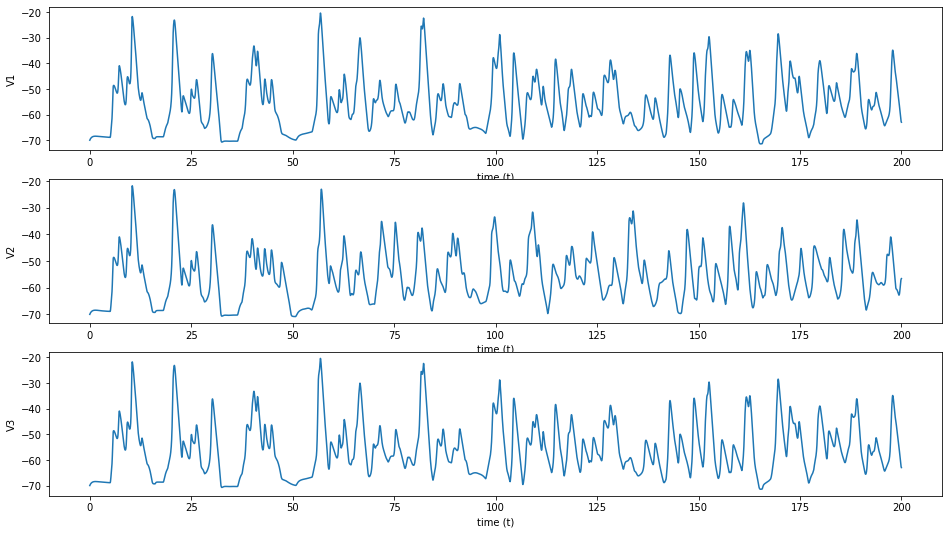

del2 is 0.1, del1 is 0.2


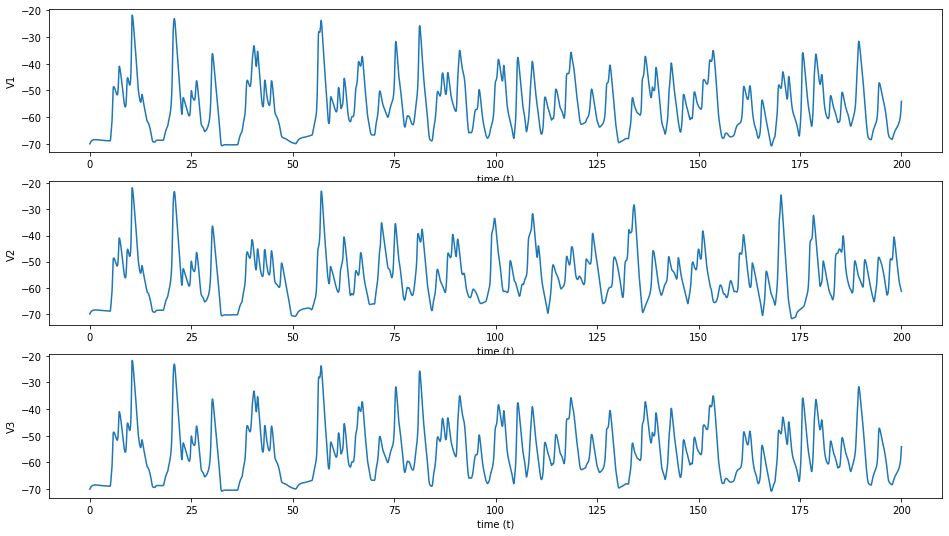

del2 is 0.1, del1 is 0.3


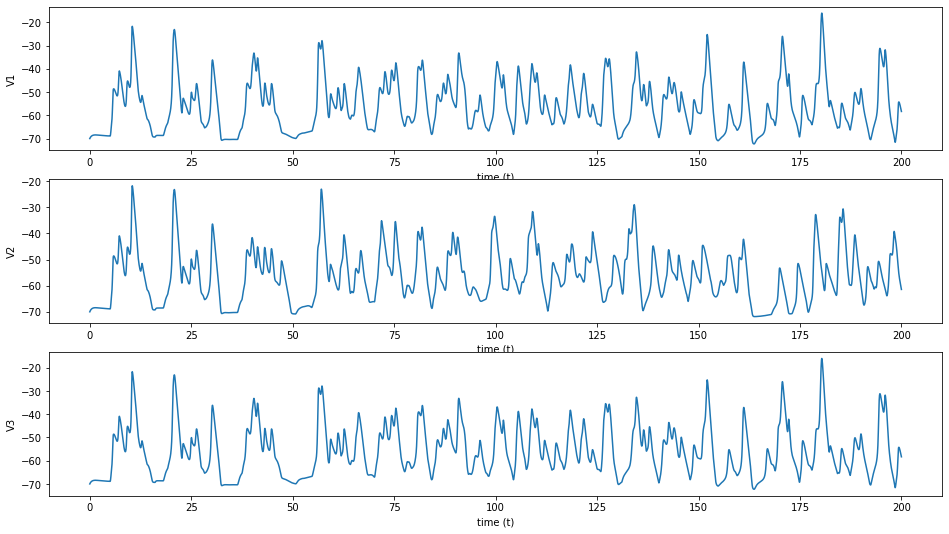

del2 is 0.1, del1 is 0.4


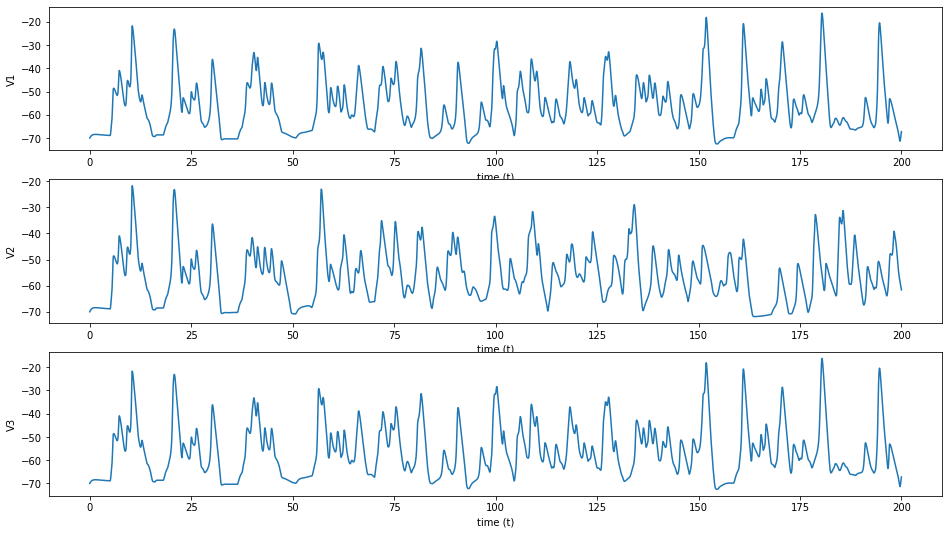

del2 is 0.1, del1 is 0.5


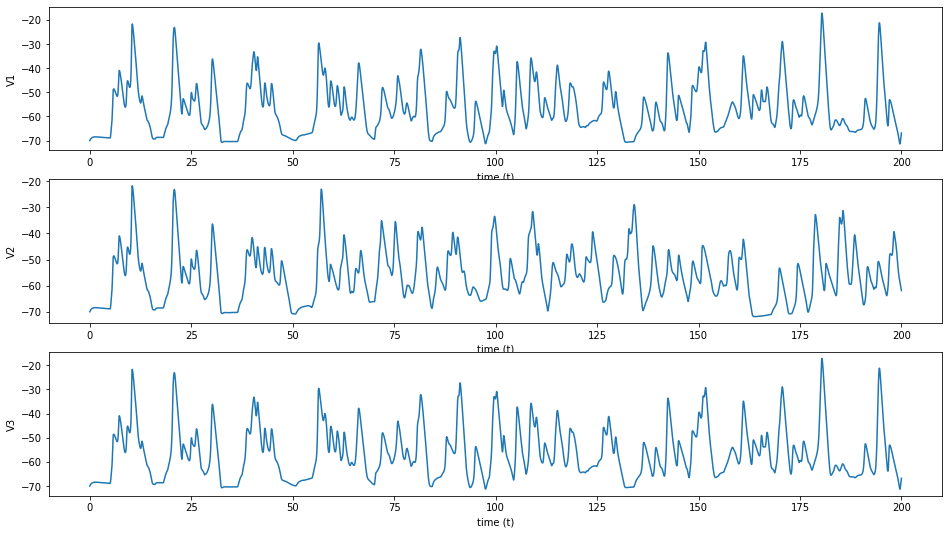

del2 is 0.1, del1 is 0.6


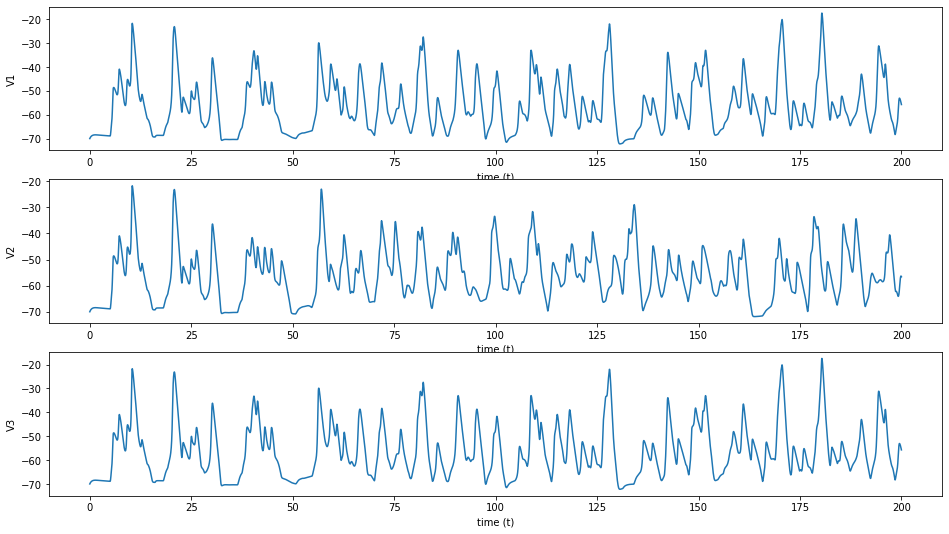

del2 is 0.1, del1 is 0.7


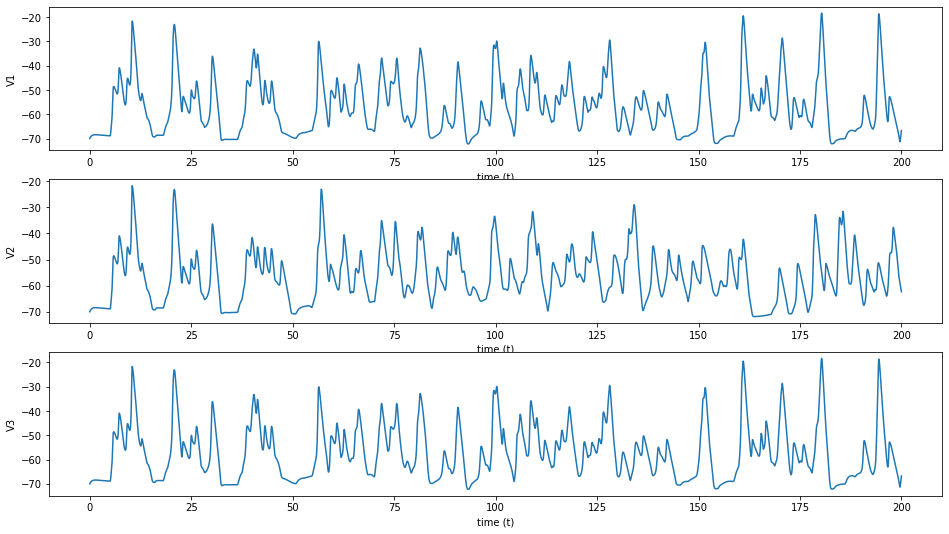

del2 is 0.1, del1 is 0.8


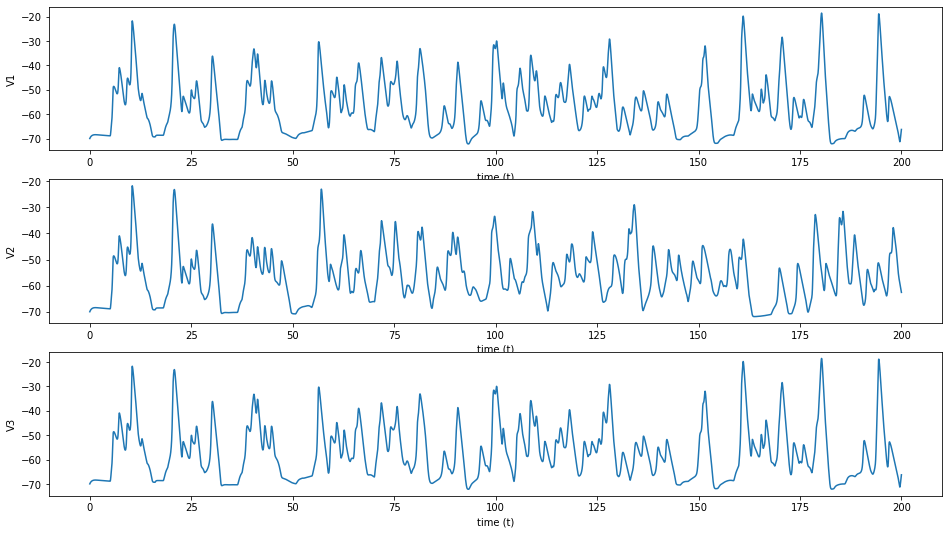

del2 is 0.1, del1 is 0.9


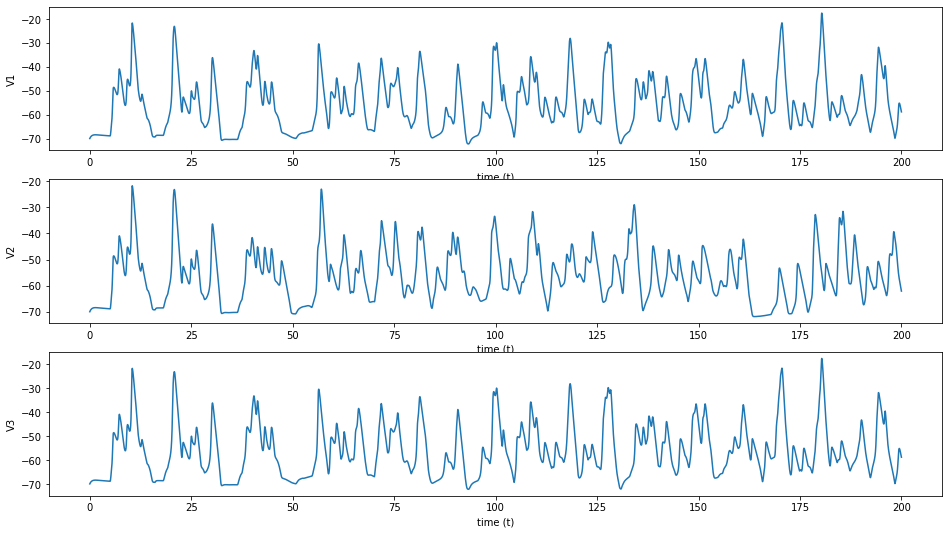

del2 is 0.1, del1 is 1.0


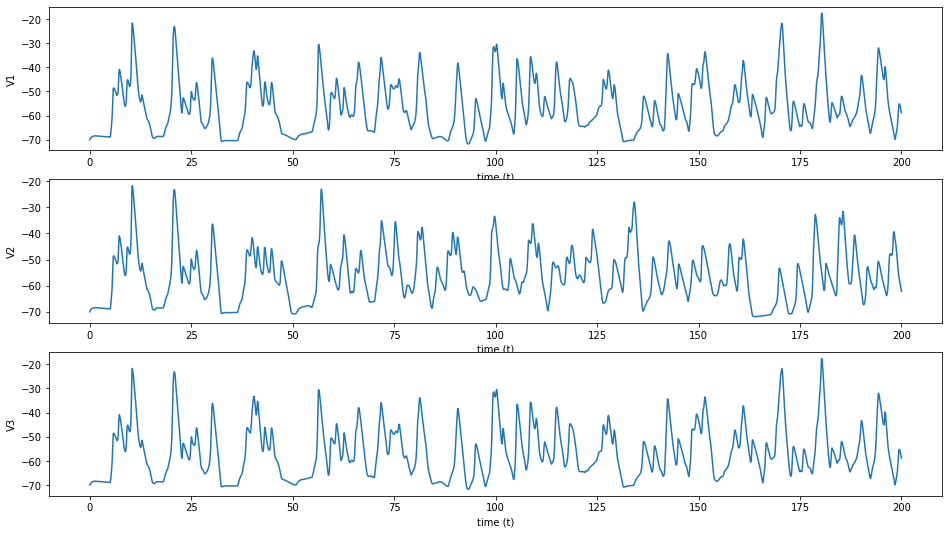

del2 is 0.1, del1 is 1.1


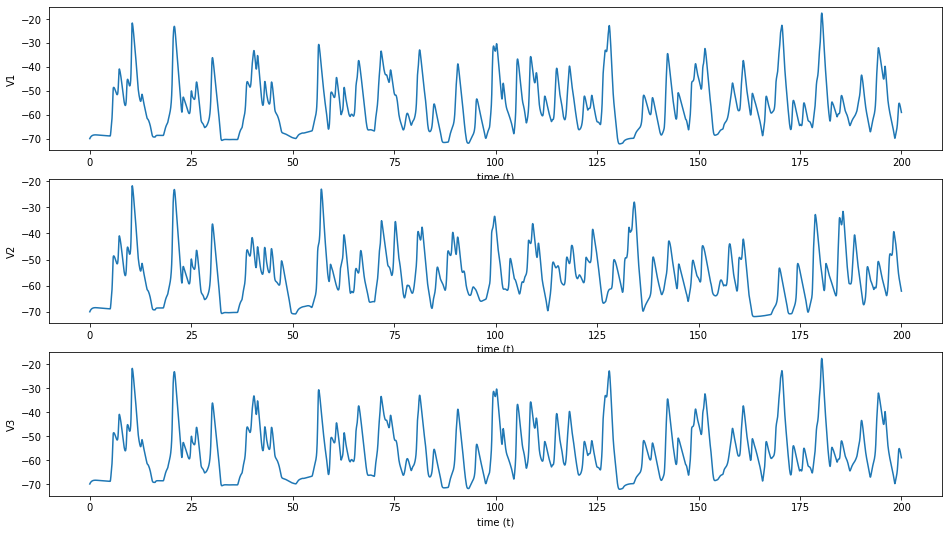

del2 is 0.1, del1 is 1.2


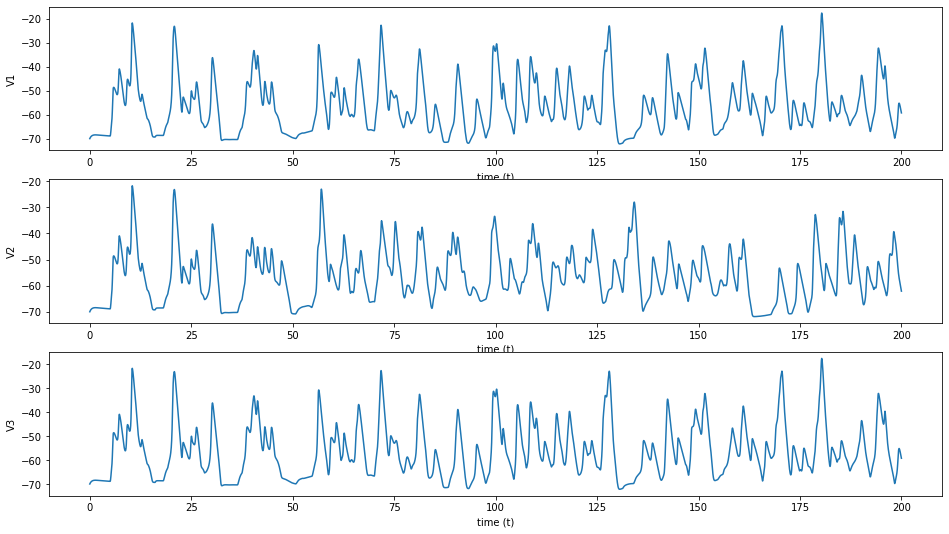

del2 is 0.1, del1 is 1.3


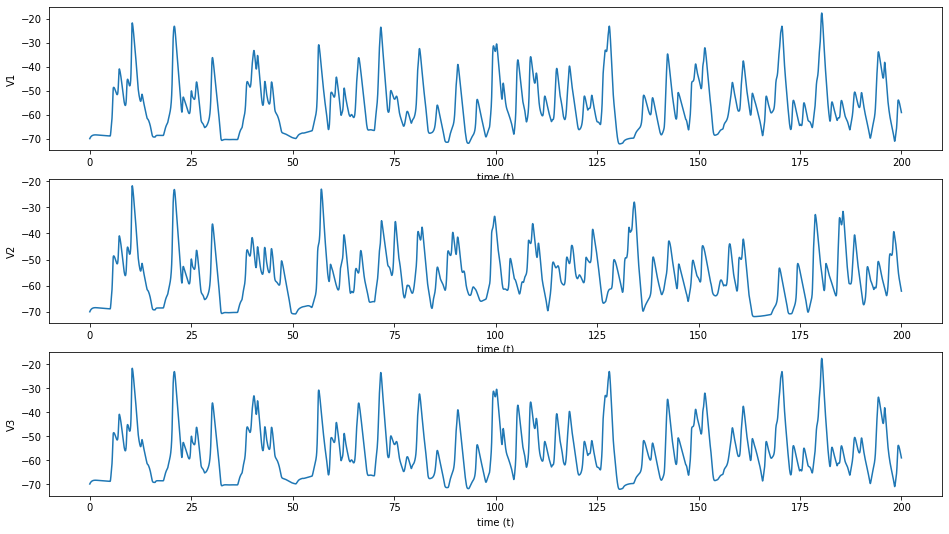

del2 is 0.1, del1 is 1.4


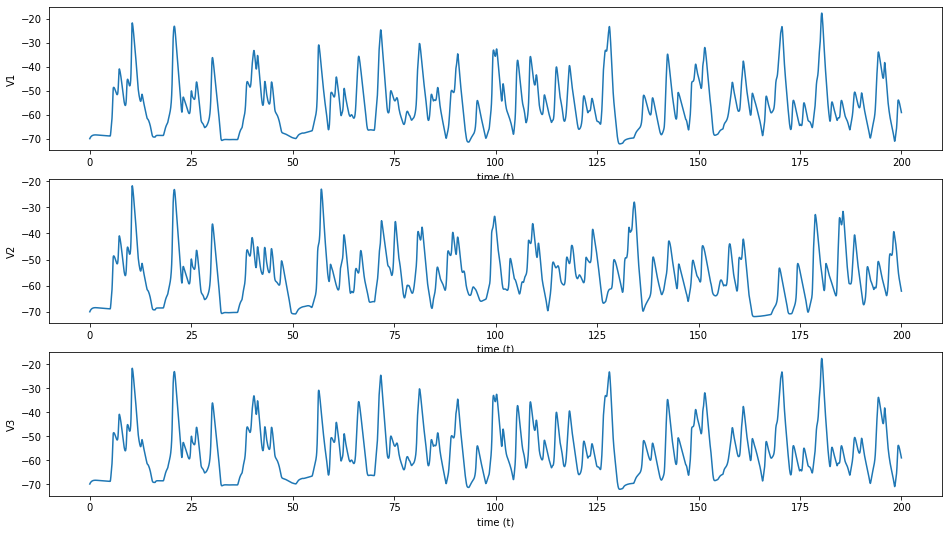

del2 is 0.1, del1 is 1.5


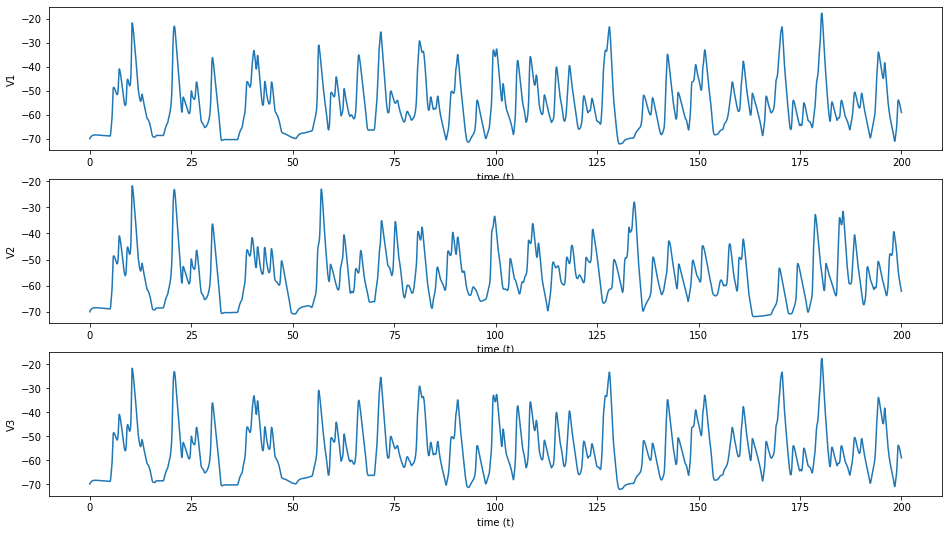

del2 is 0.1, del1 is 1.6


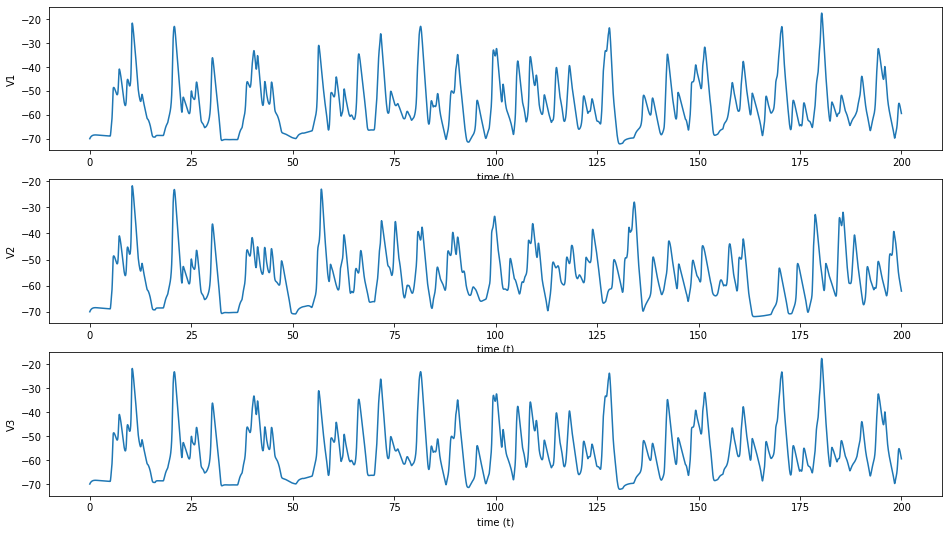

del2 is 0.1, del1 is 1.7


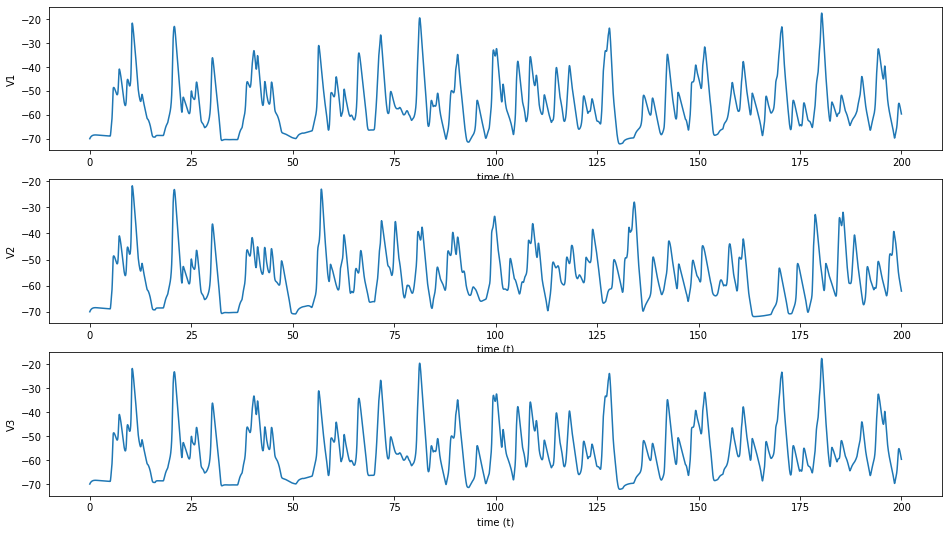

del2 is 0.1, del1 is 1.8


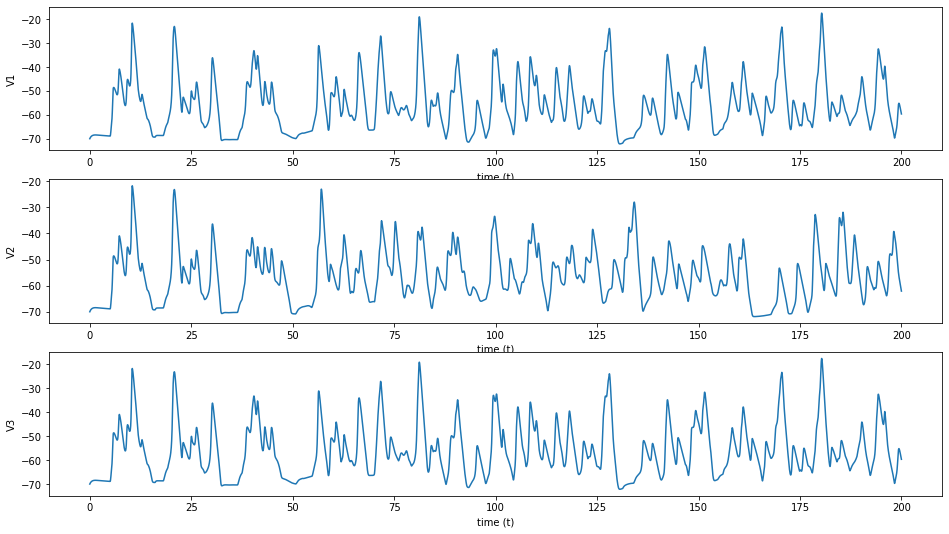

del2 is 0.1, del1 is 1.9


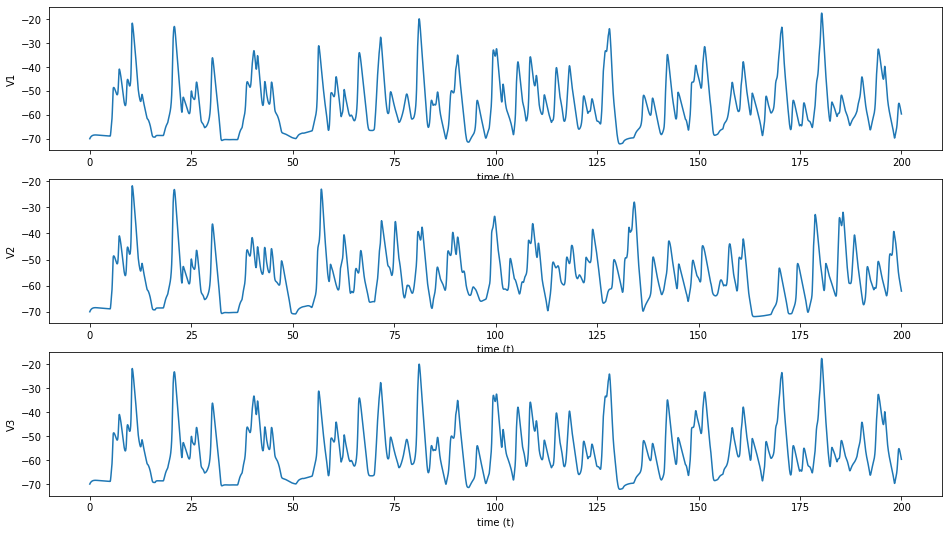

del2 is 0.2, del1 is 0.1


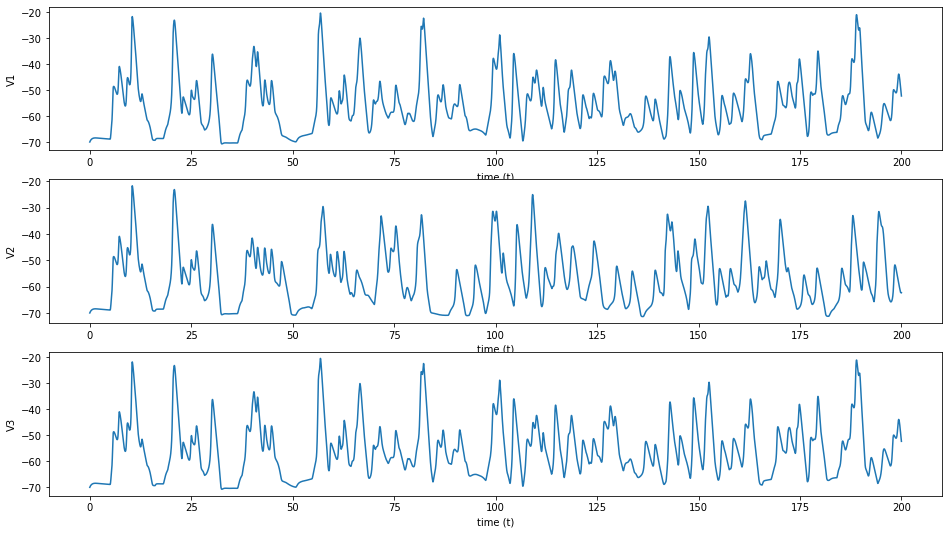

del2 is 0.2, del1 is 0.2


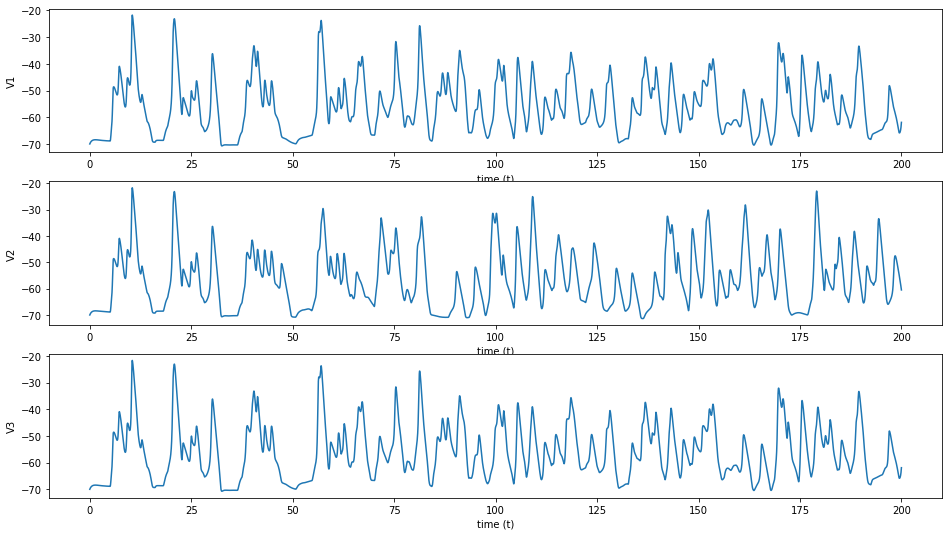

del2 is 0.2, del1 is 0.3


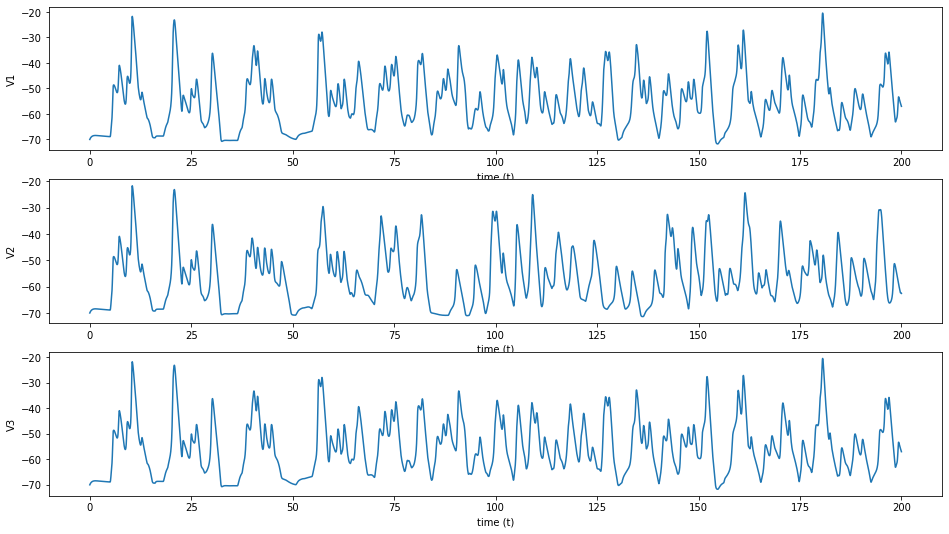

del2 is 0.2, del1 is 0.4


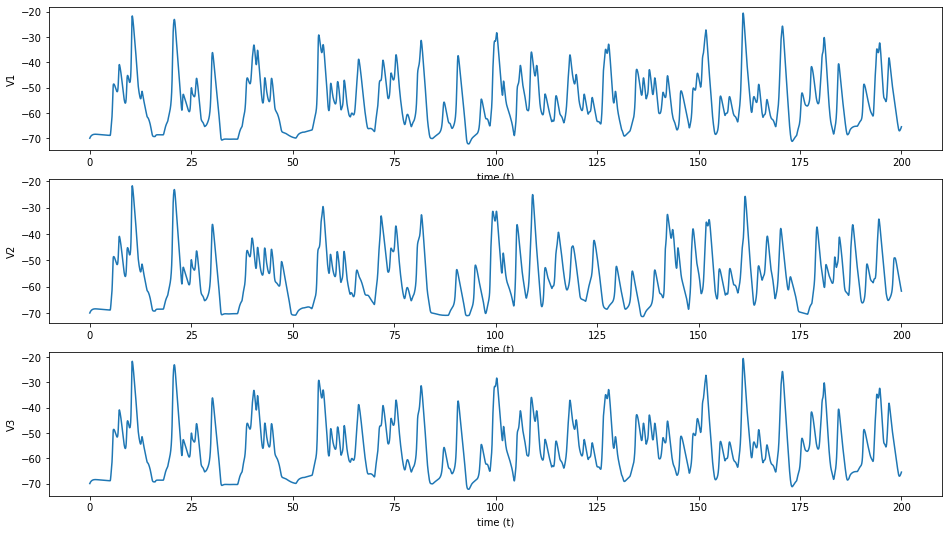

del2 is 0.2, del1 is 0.5


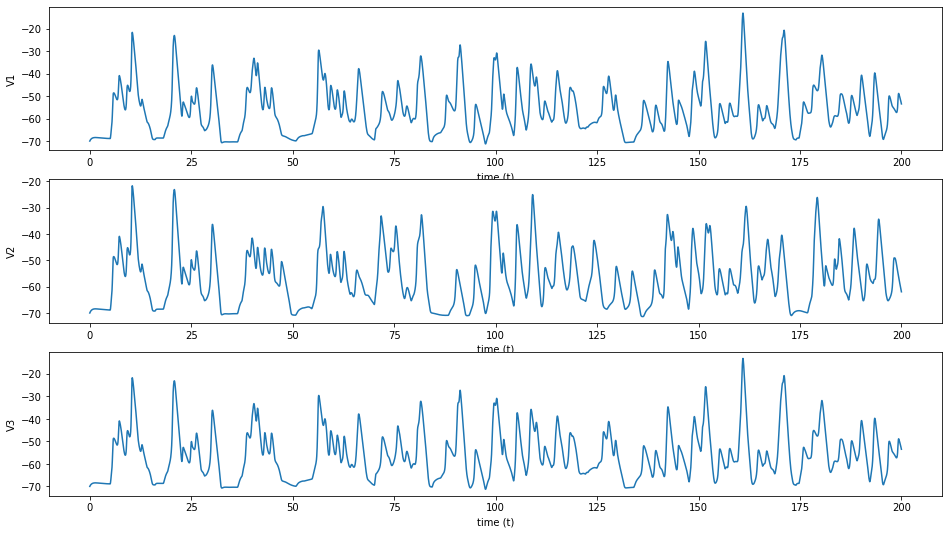

del2 is 0.2, del1 is 0.6


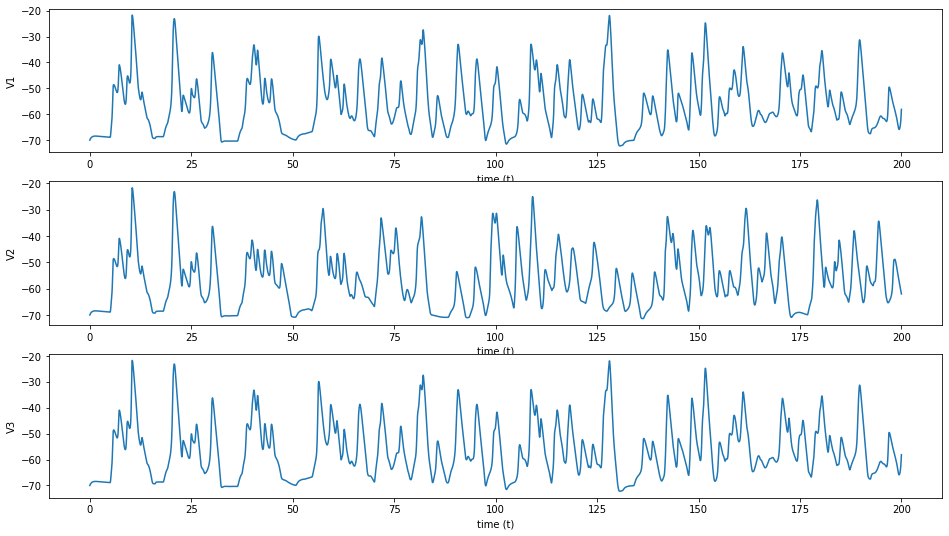

del2 is 0.2, del1 is 0.7


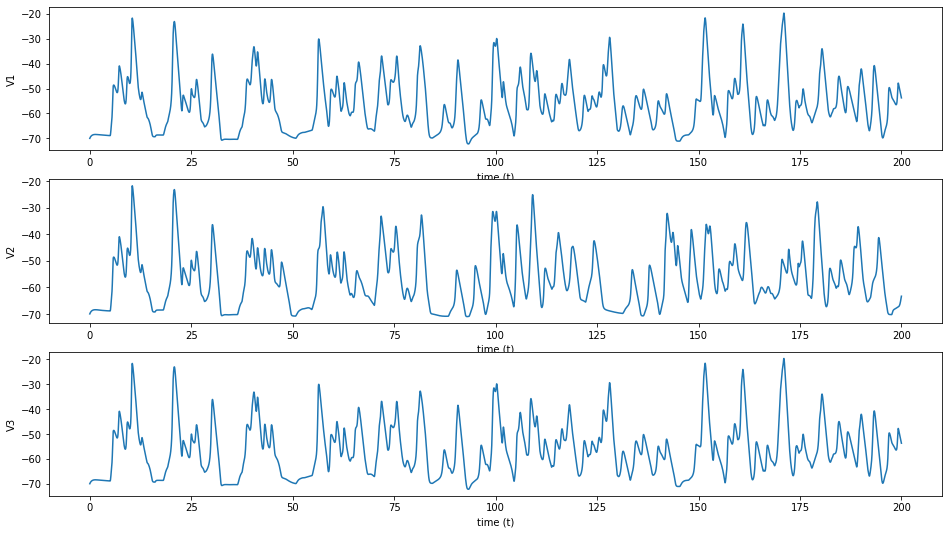

del2 is 0.2, del1 is 0.8


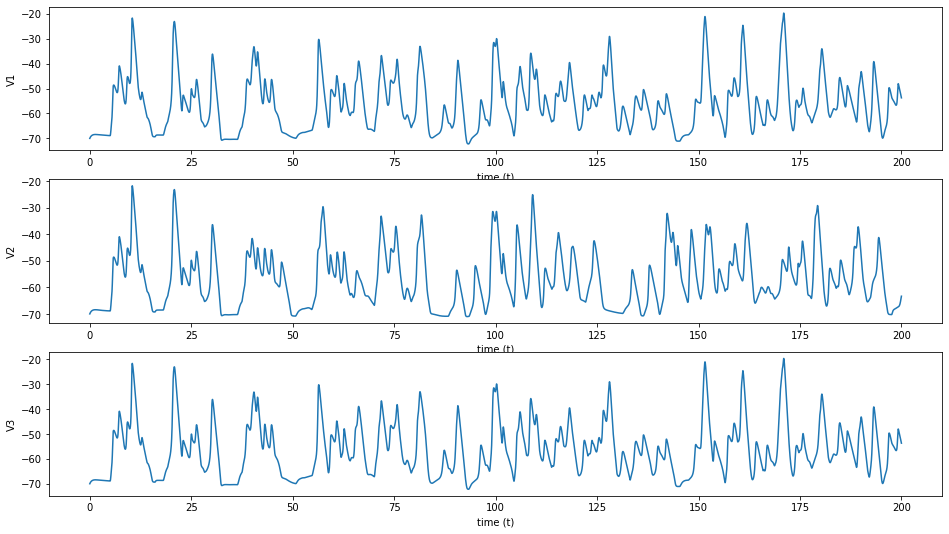

del2 is 0.2, del1 is 0.9


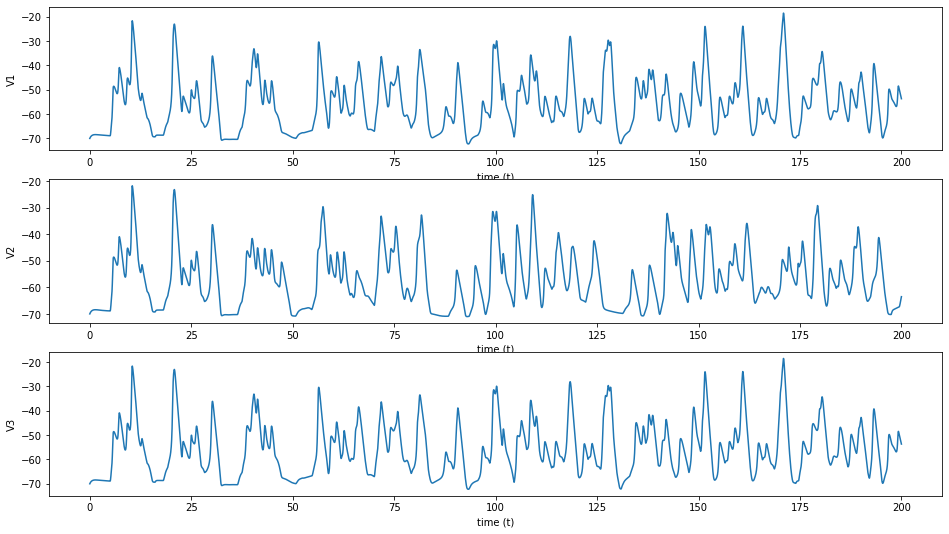

del2 is 0.2, del1 is 1.0


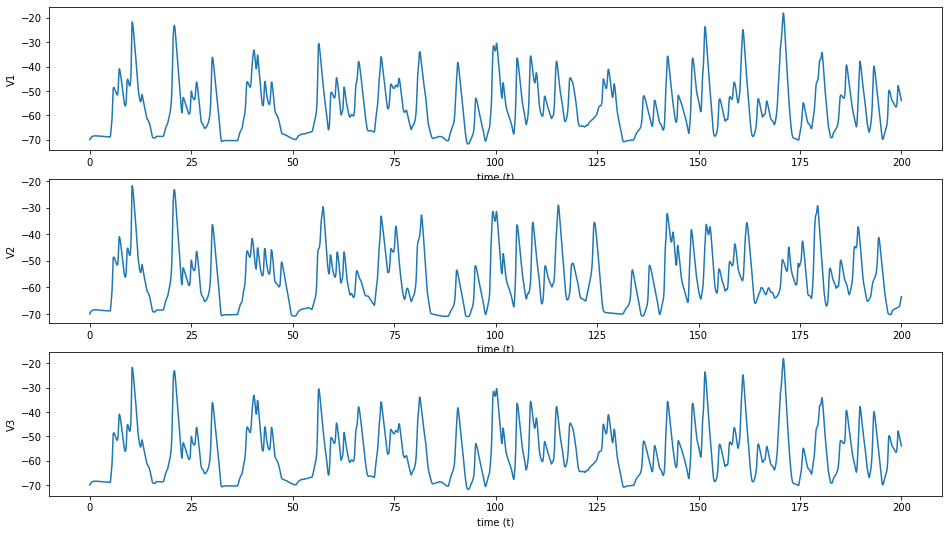

del2 is 0.2, del1 is 1.1


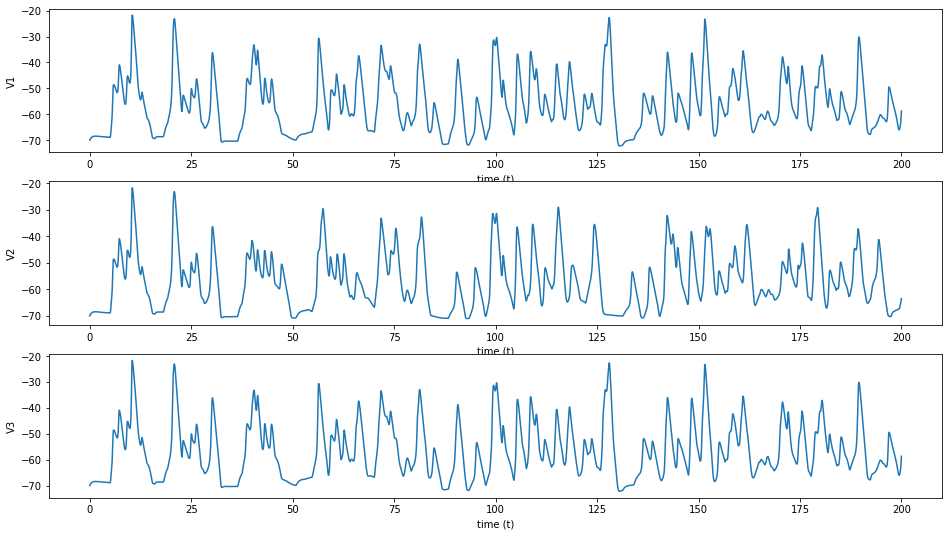

del2 is 0.2, del1 is 1.2


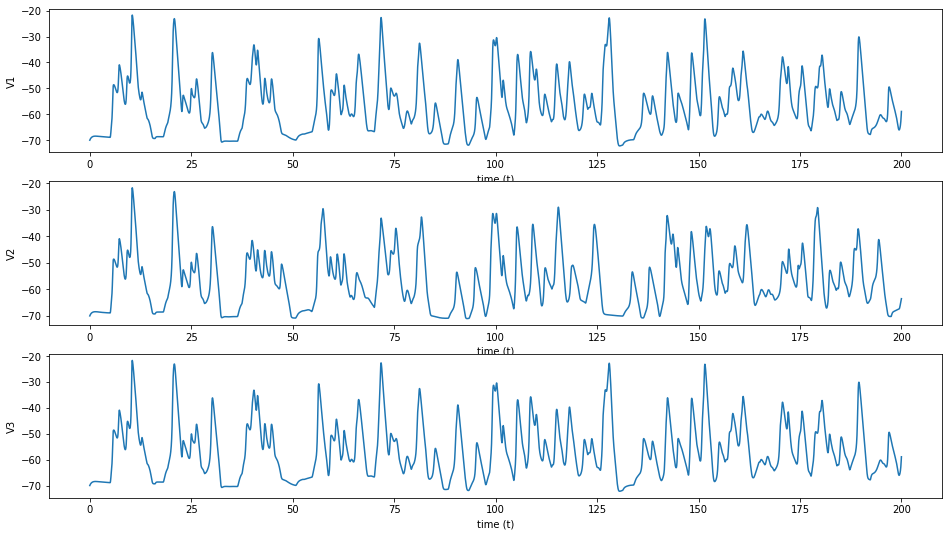

del2 is 0.2, del1 is 1.3


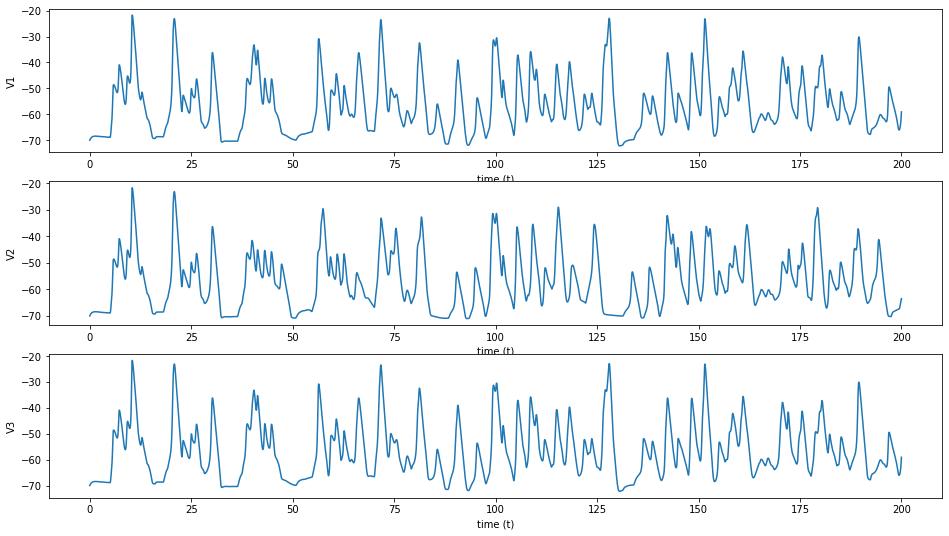

del2 is 0.2, del1 is 1.4


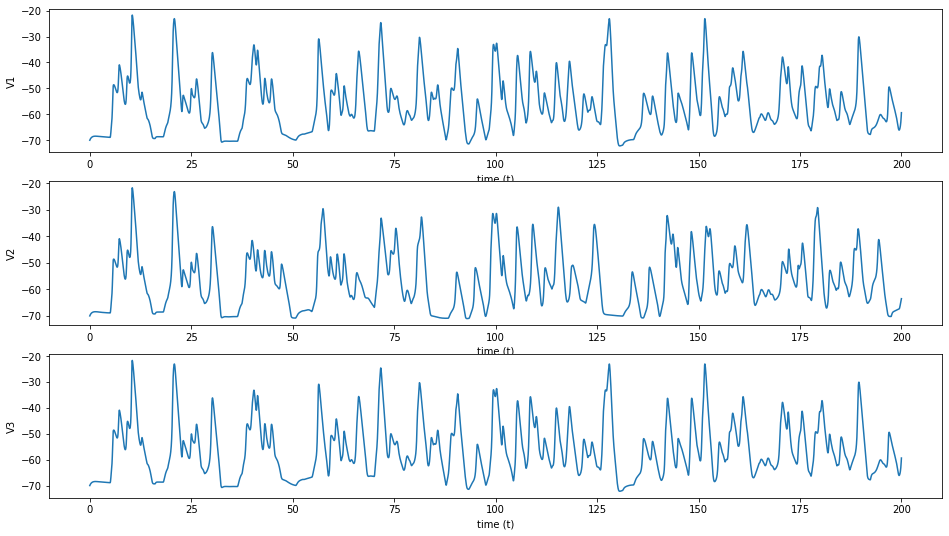

del2 is 0.2, del1 is 1.5


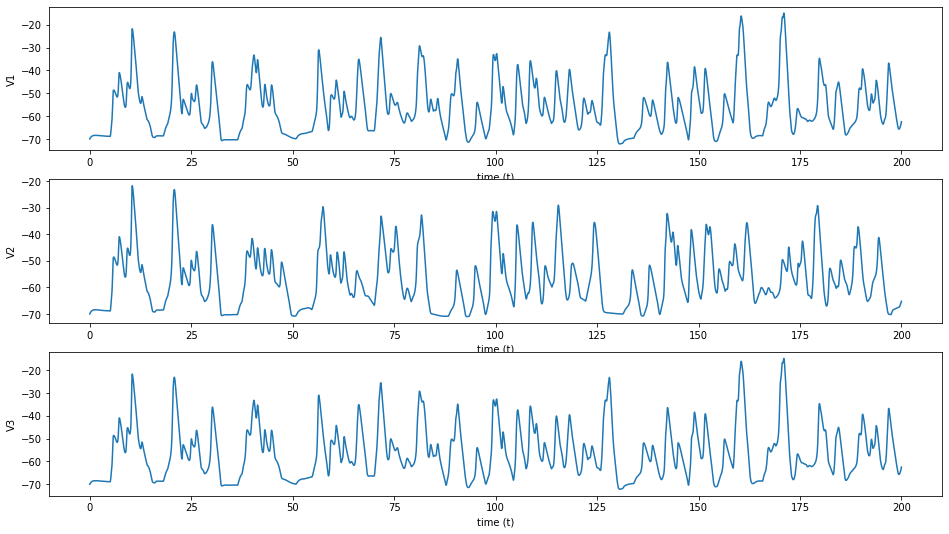

del2 is 0.2, del1 is 1.6


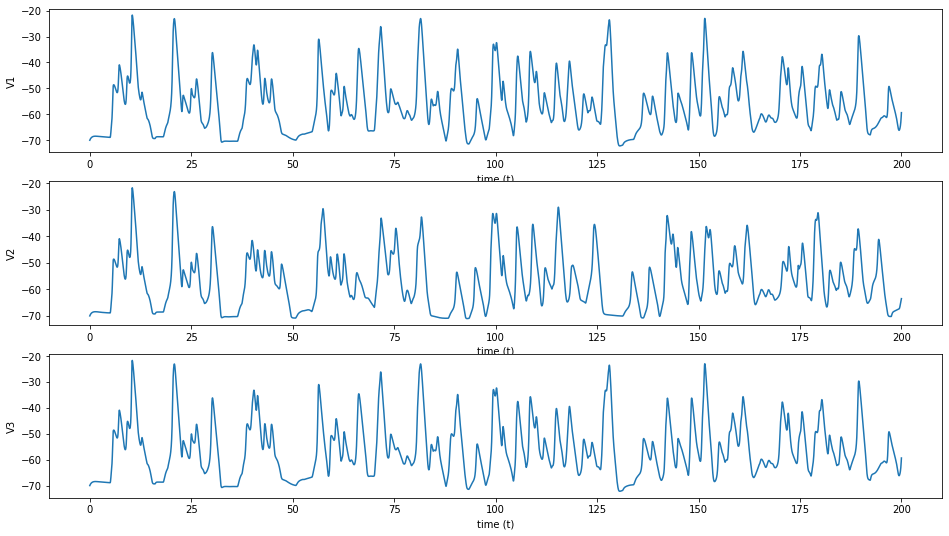

del2 is 0.2, del1 is 1.7


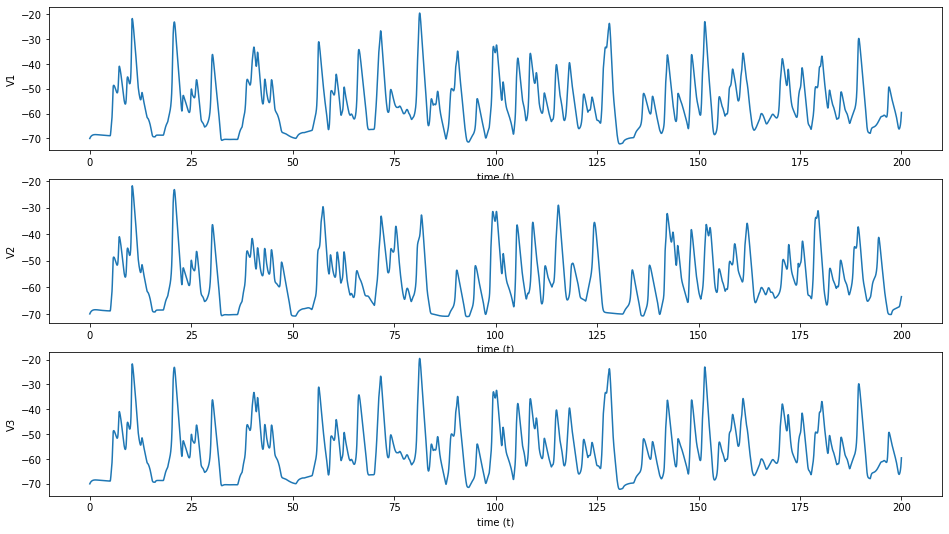

del2 is 0.2, del1 is 1.8


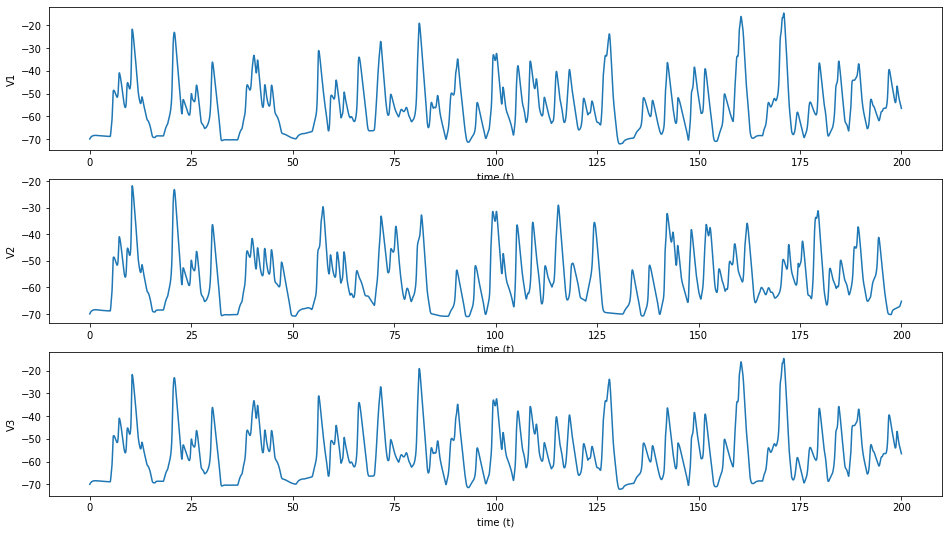

del2 is 0.2, del1 is 1.9


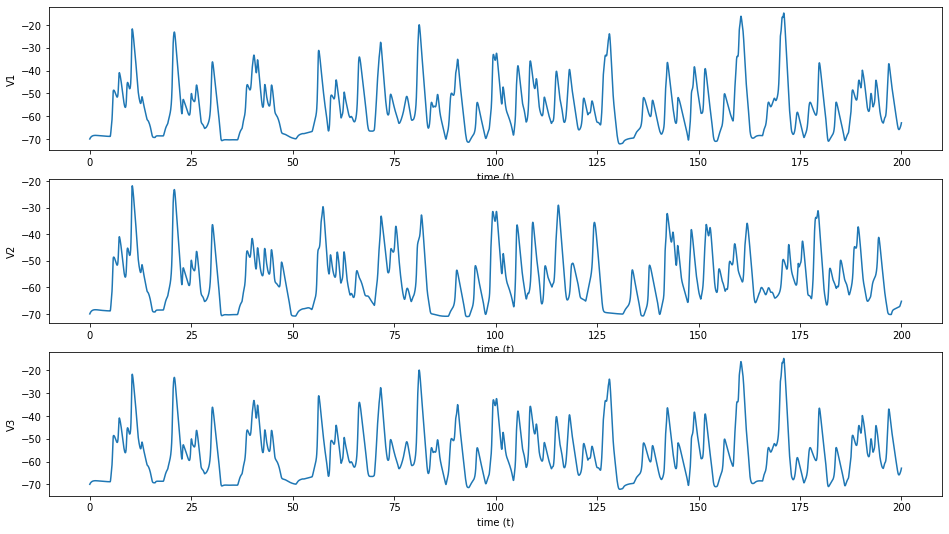

del2 is 0.3, del1 is 0.1


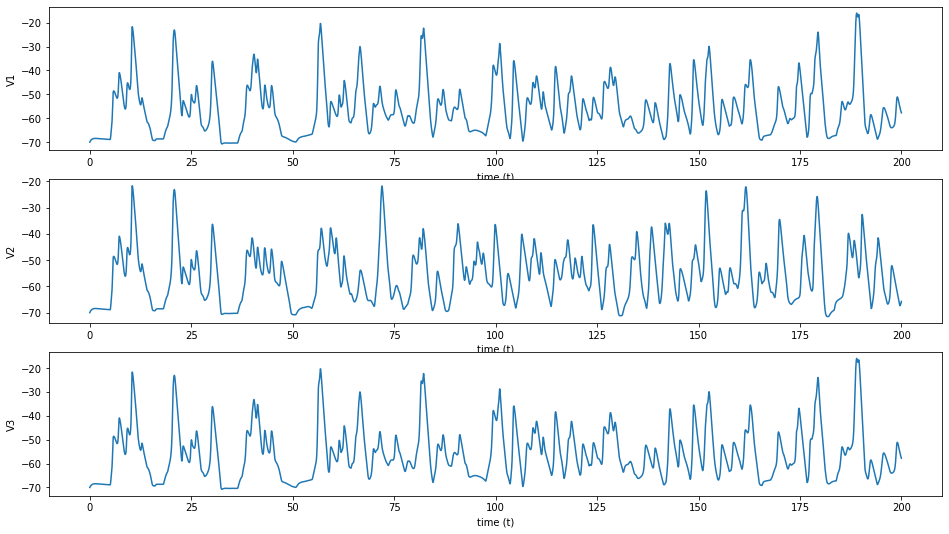

del2 is 0.3, del1 is 0.2


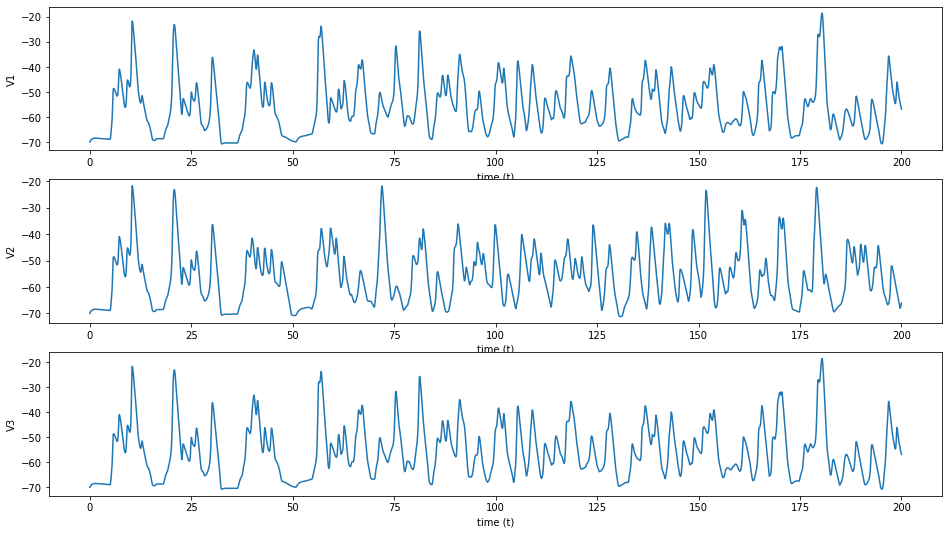

del2 is 0.3, del1 is 0.3


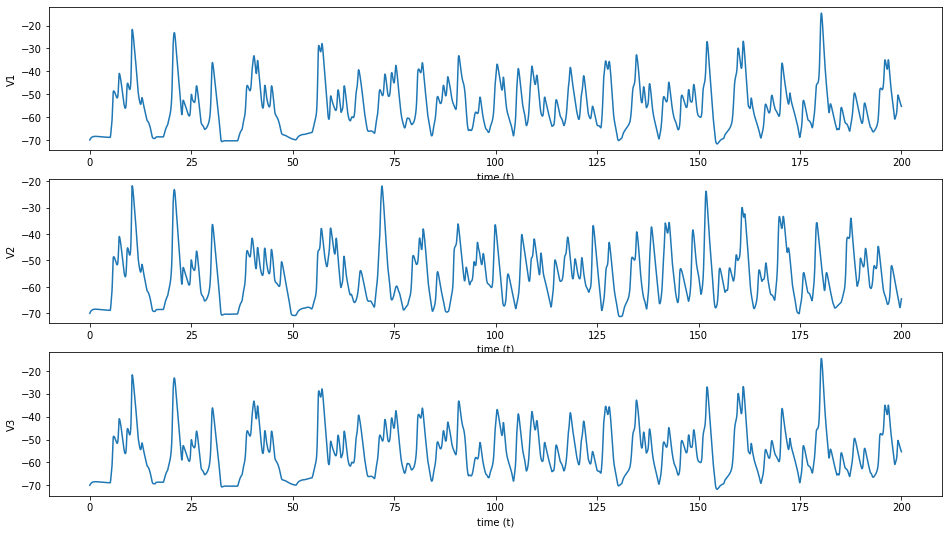

del2 is 0.3, del1 is 0.4


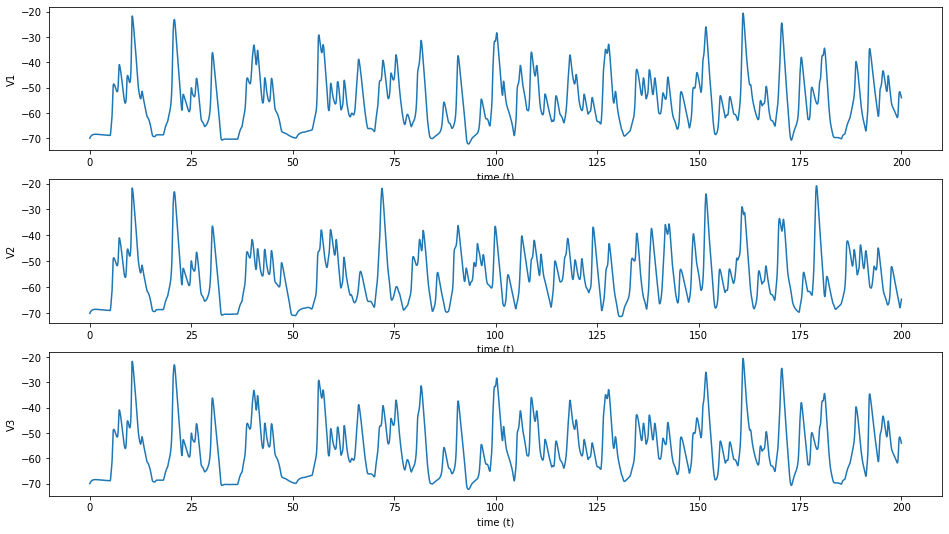

del2 is 0.3, del1 is 0.5


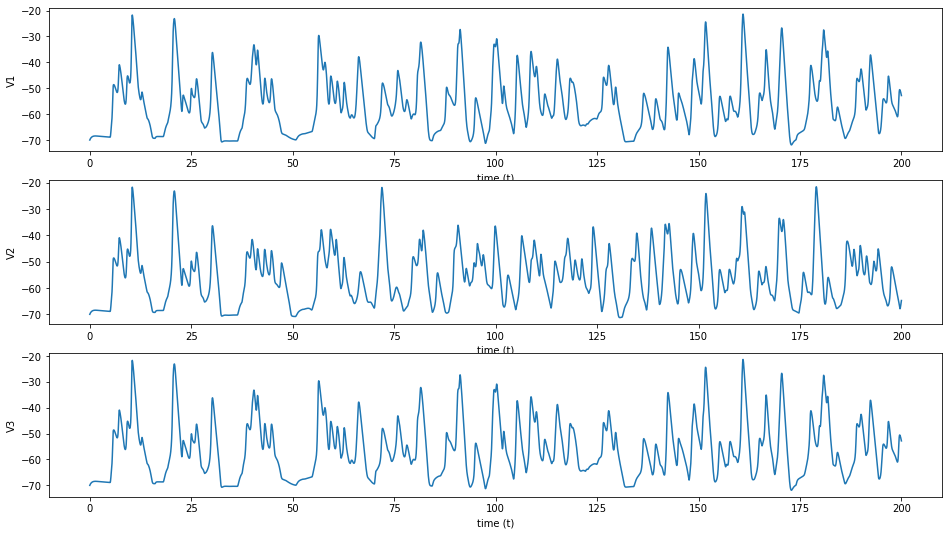

del2 is 0.3, del1 is 0.6


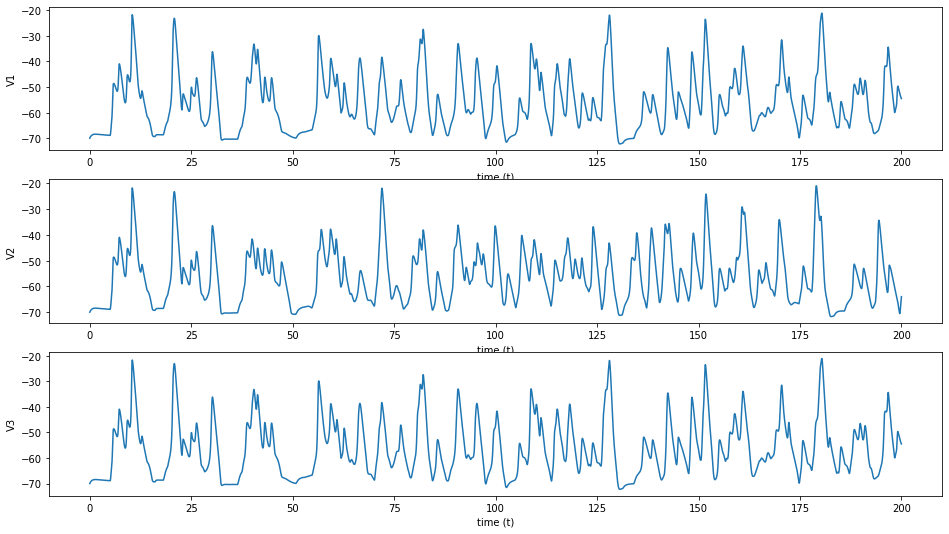

del2 is 0.3, del1 is 0.7


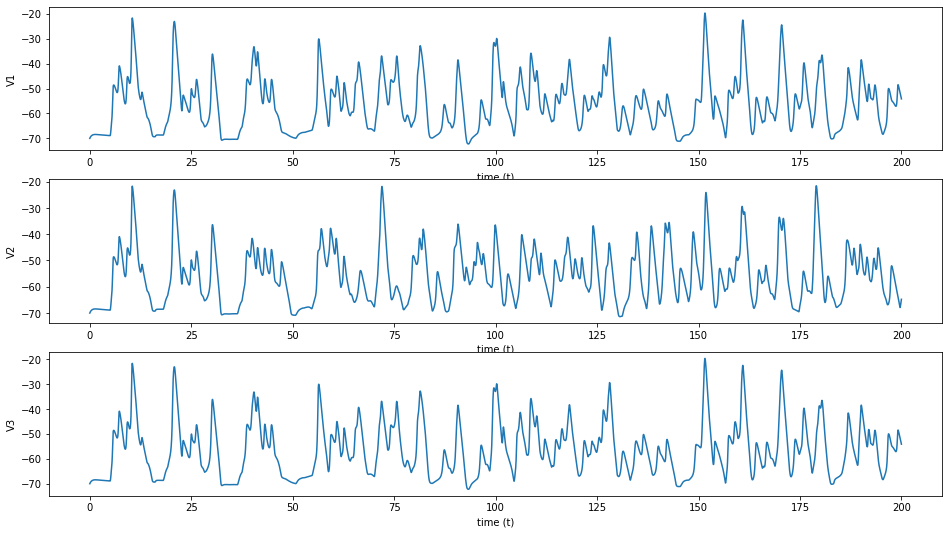

del2 is 0.3, del1 is 0.8


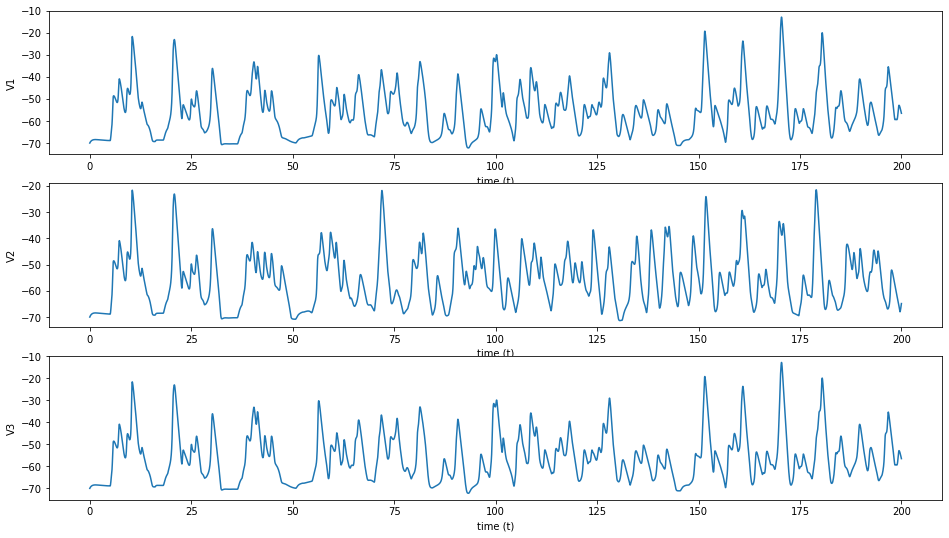

del2 is 0.3, del1 is 0.9


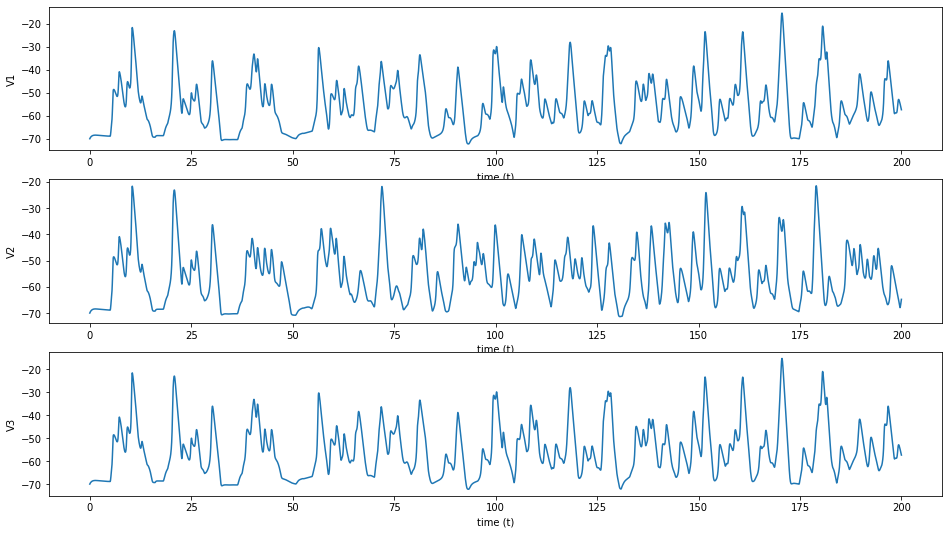

del2 is 0.3, del1 is 1.0


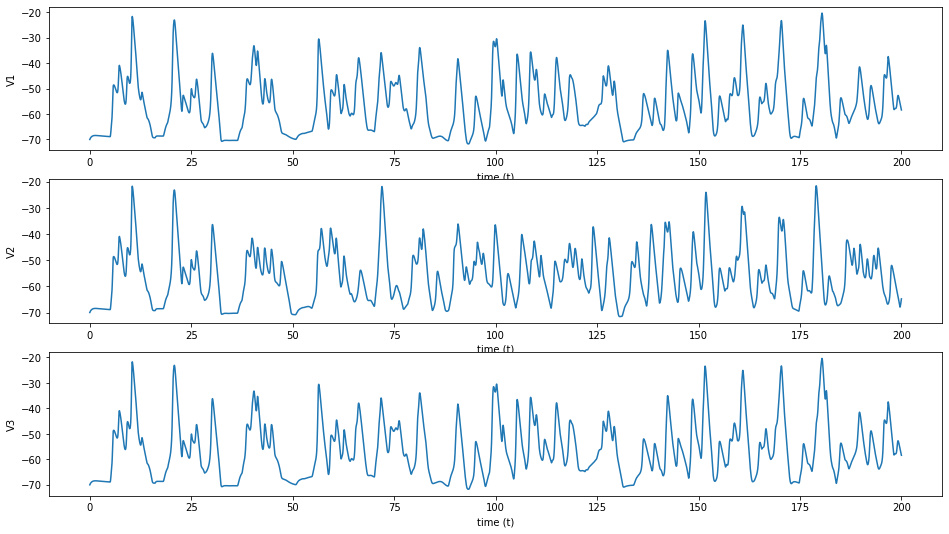

del2 is 0.3, del1 is 1.1


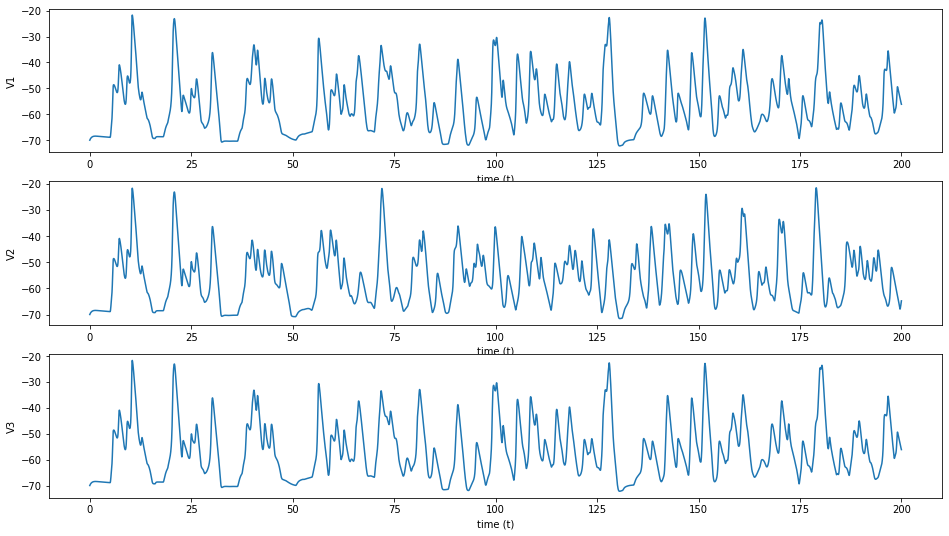

del2 is 0.3, del1 is 1.2


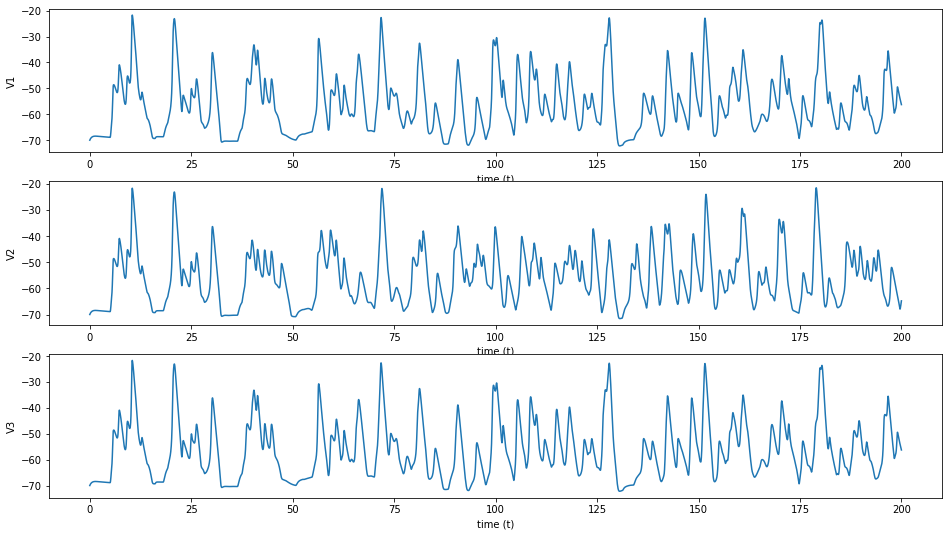

del2 is 0.3, del1 is 1.3


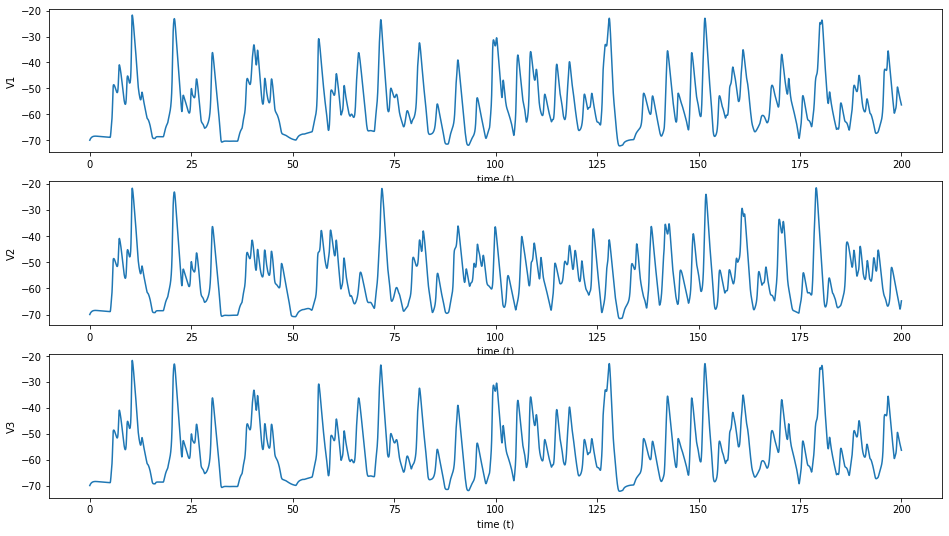

del2 is 0.3, del1 is 1.4


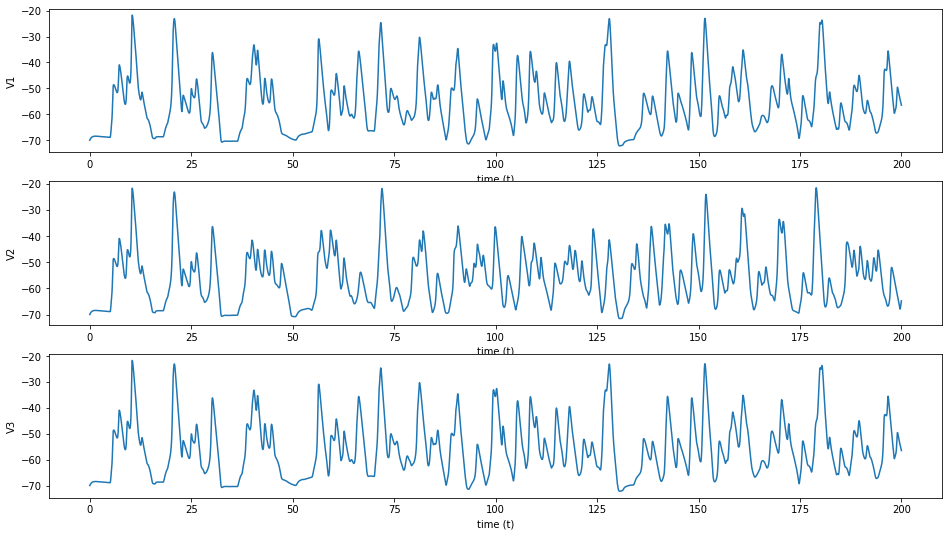

del2 is 0.3, del1 is 1.5


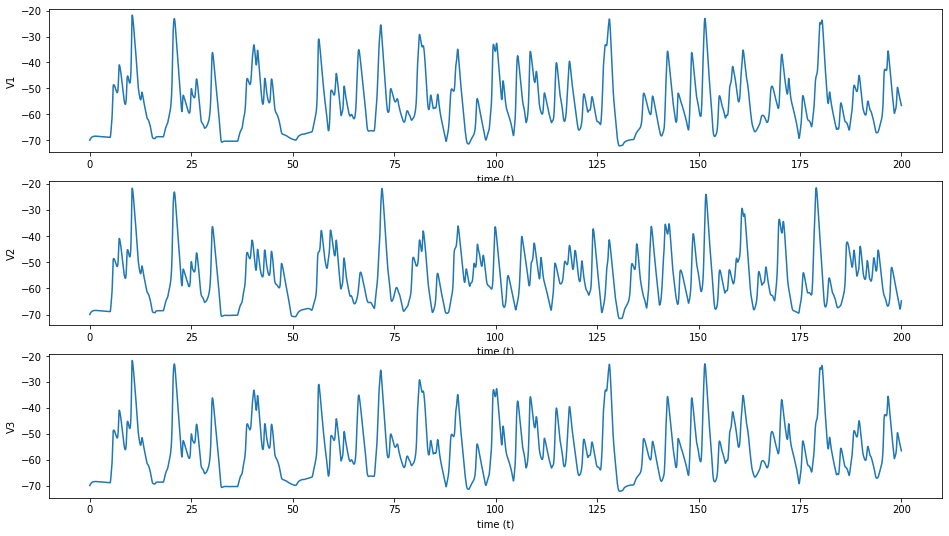

del2 is 0.3, del1 is 1.6


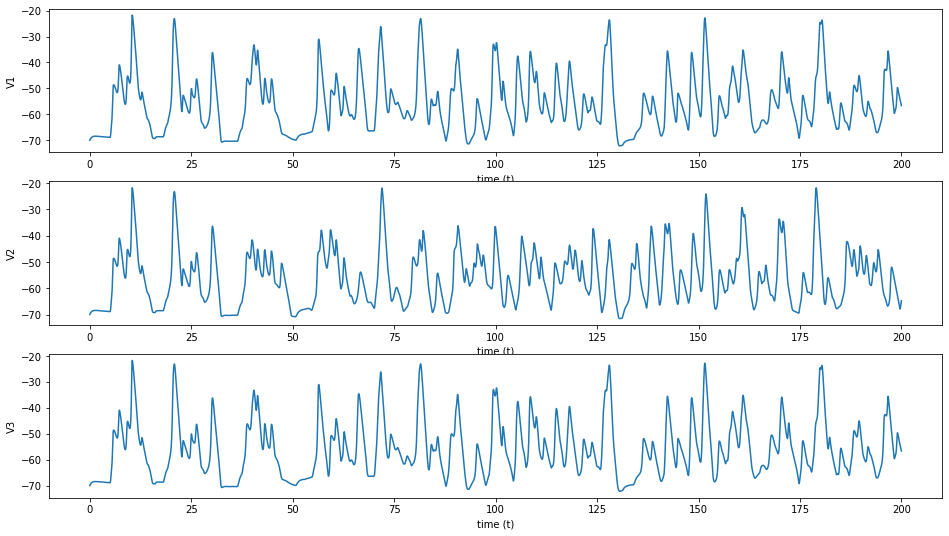

del2 is 0.3, del1 is 1.7


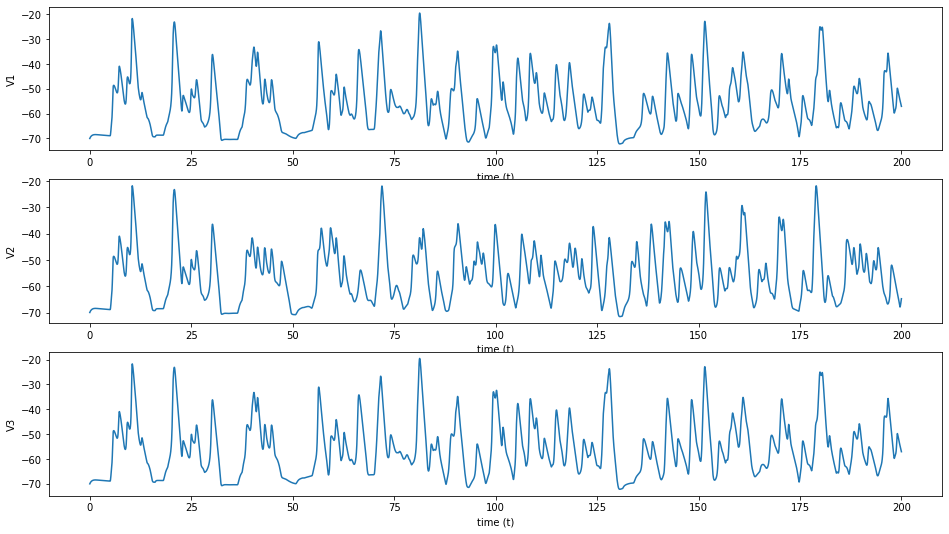

del2 is 0.3, del1 is 1.8


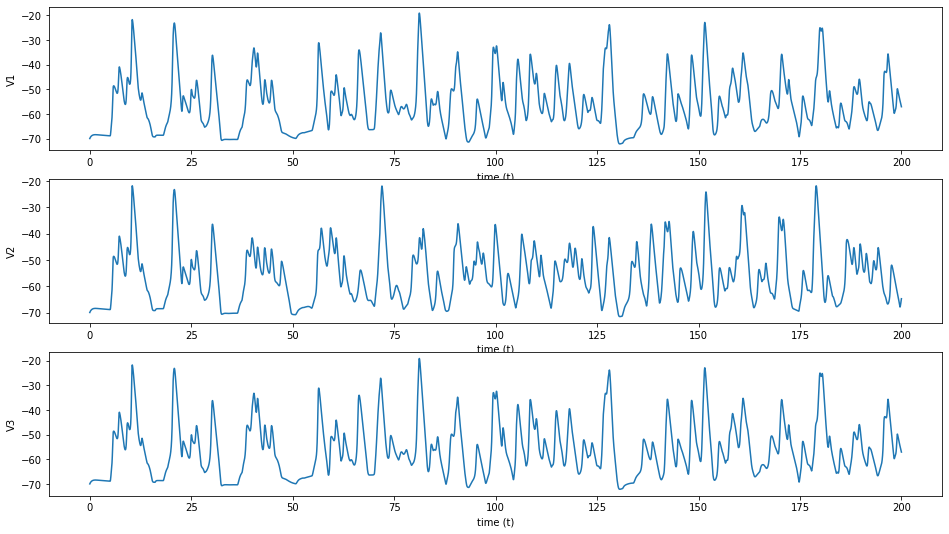

del2 is 0.3, del1 is 1.9


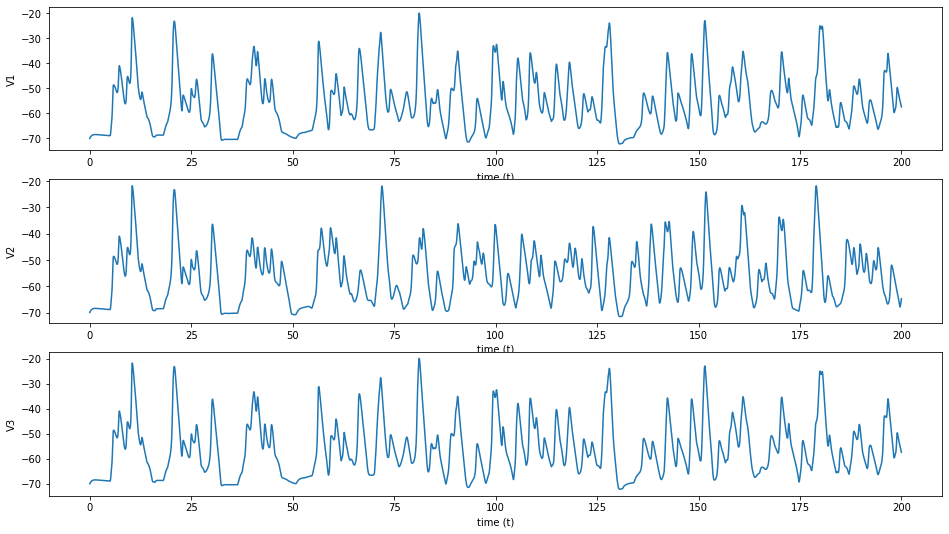

del2 is 0.4, del1 is 0.1


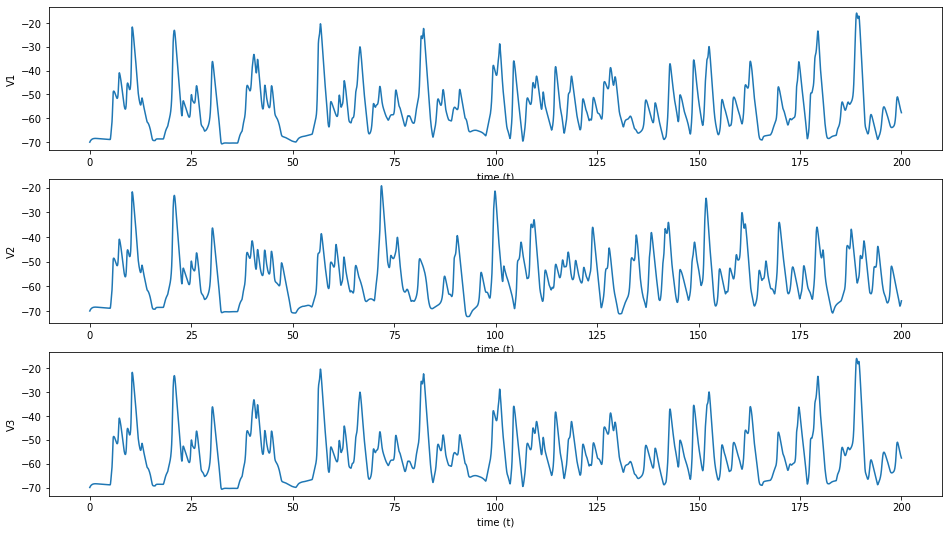

del2 is 0.4, del1 is 0.2


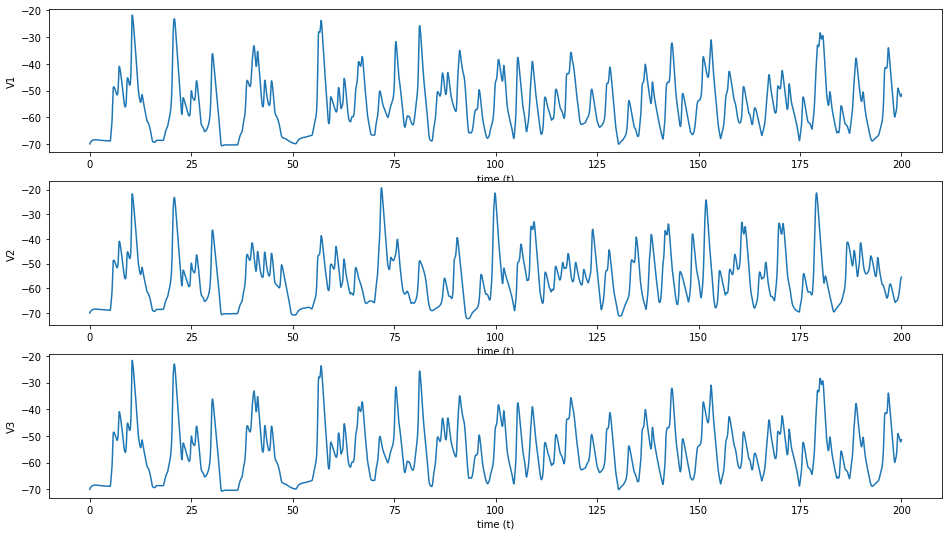

del2 is 0.4, del1 is 0.3


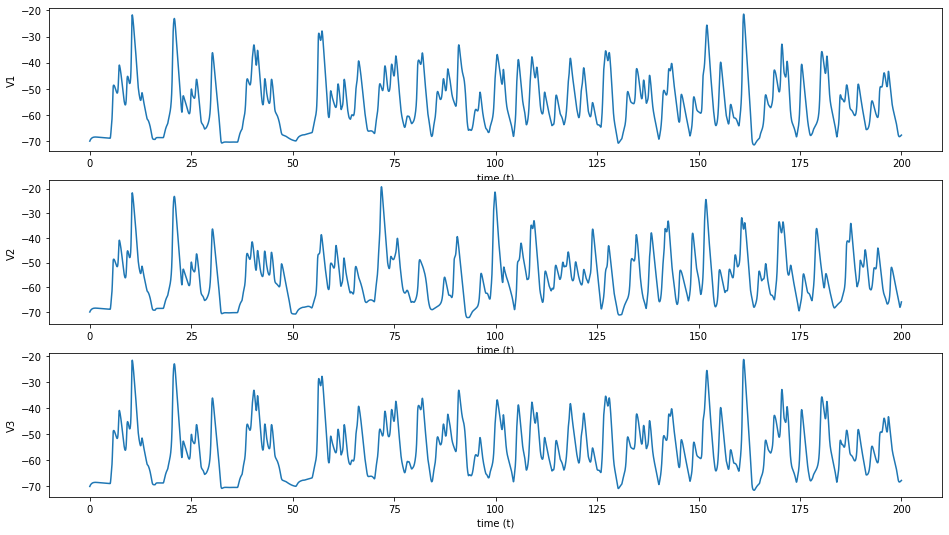

del2 is 0.4, del1 is 0.4


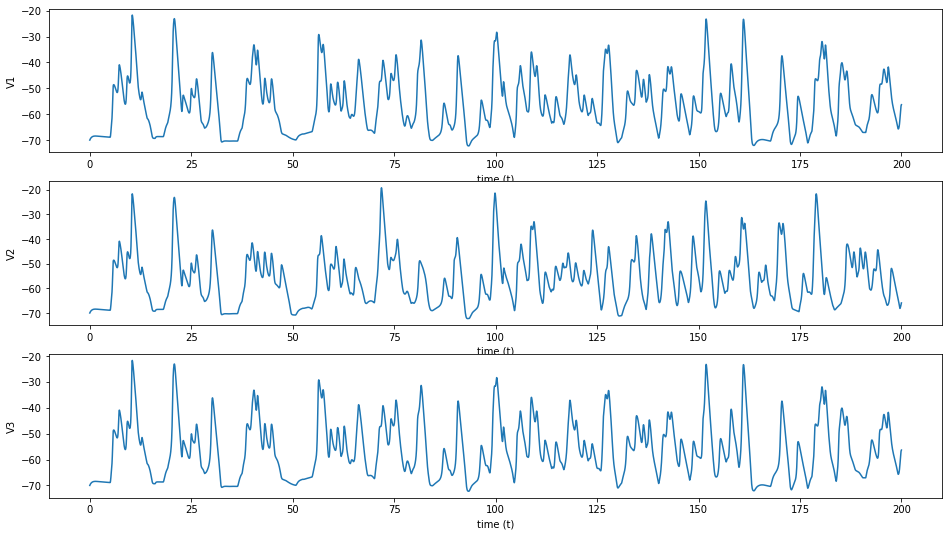

del2 is 0.4, del1 is 0.5


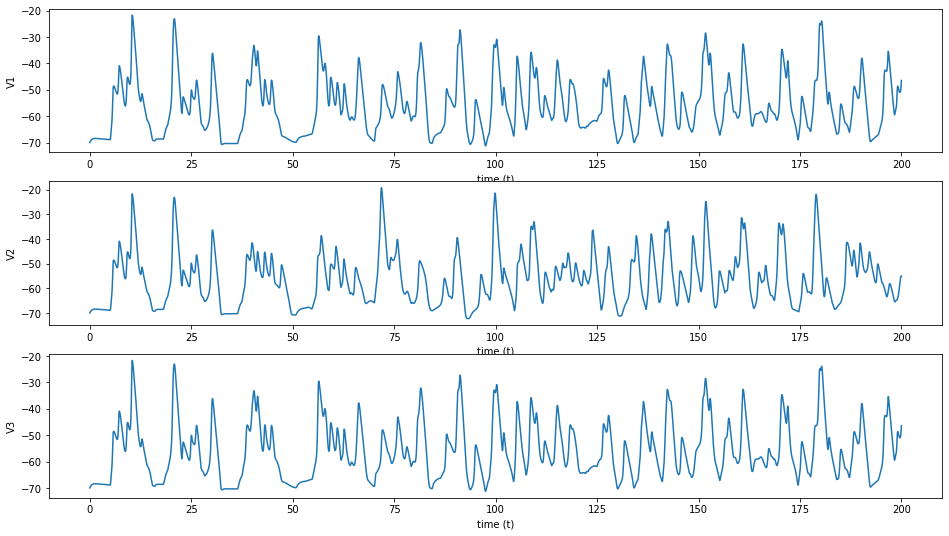

del2 is 0.4, del1 is 0.6


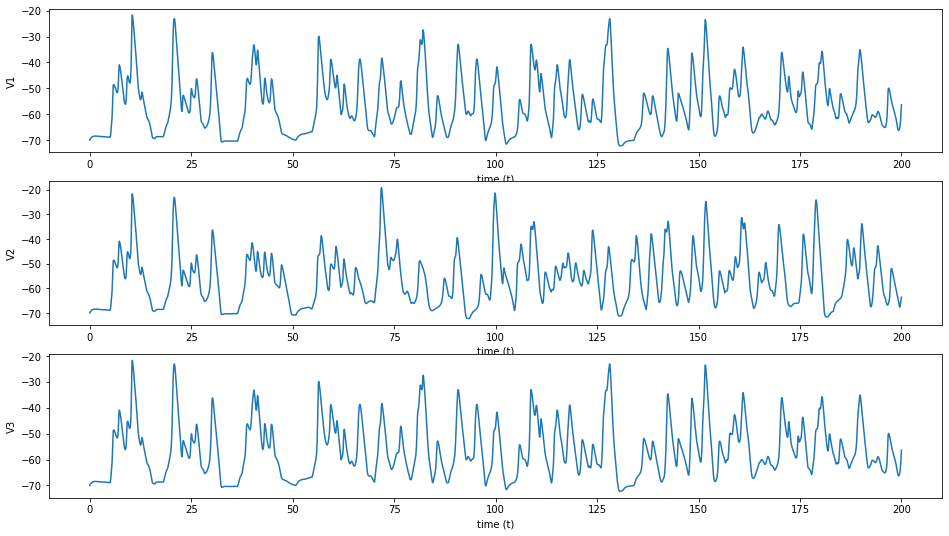

del2 is 0.4, del1 is 0.7


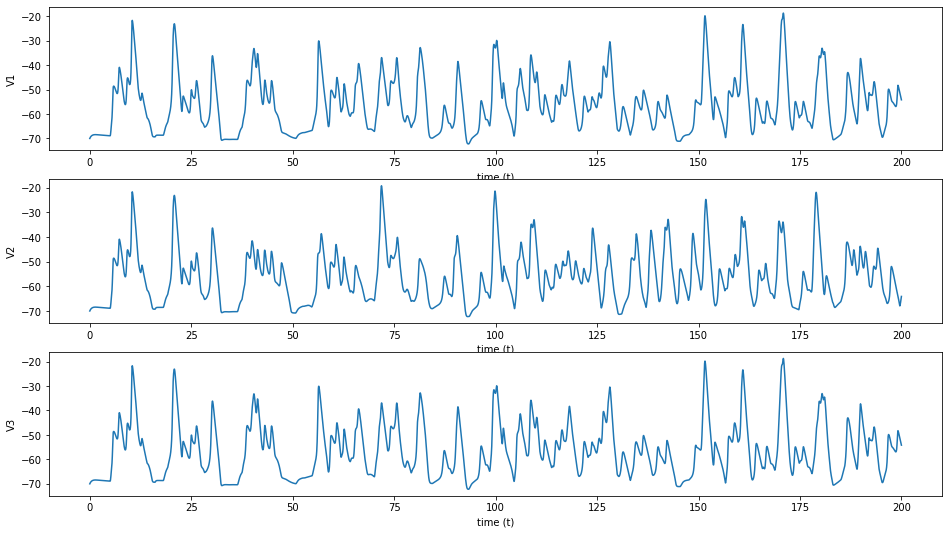

del2 is 0.4, del1 is 0.8


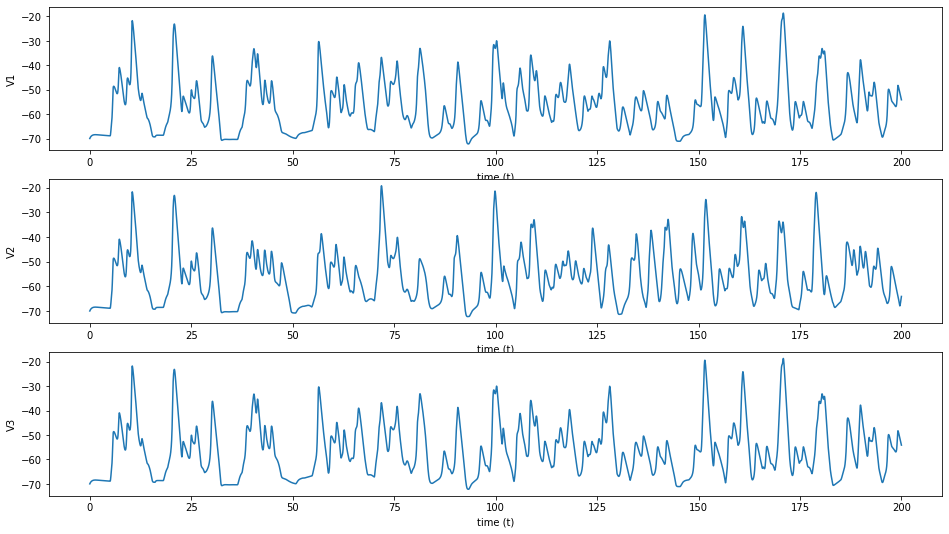

del2 is 0.4, del1 is 0.9


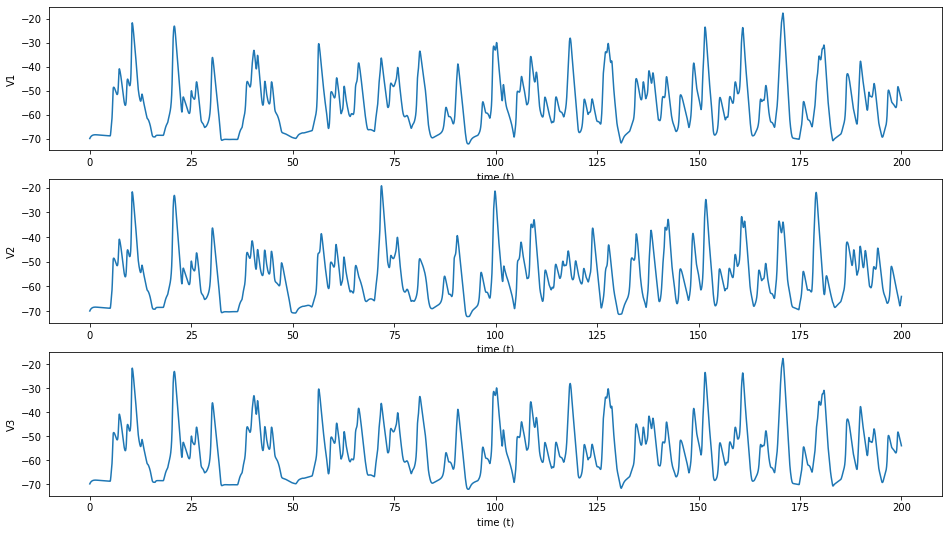

del2 is 0.4, del1 is 1.0


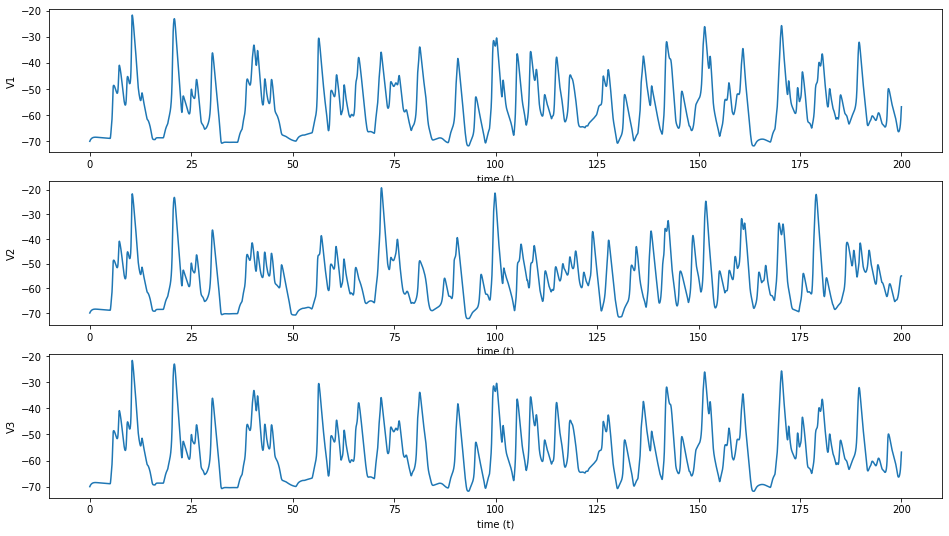

del2 is 0.4, del1 is 1.1


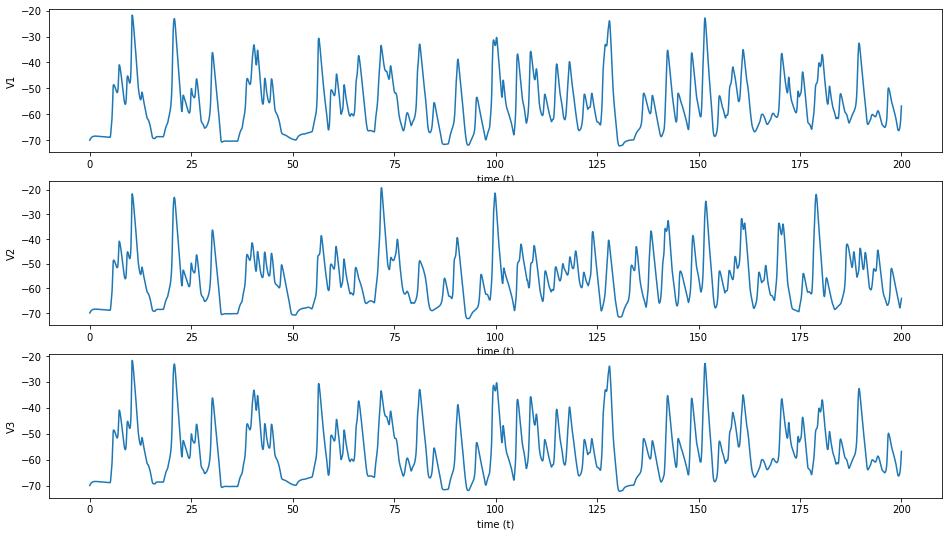

del2 is 0.4, del1 is 1.2


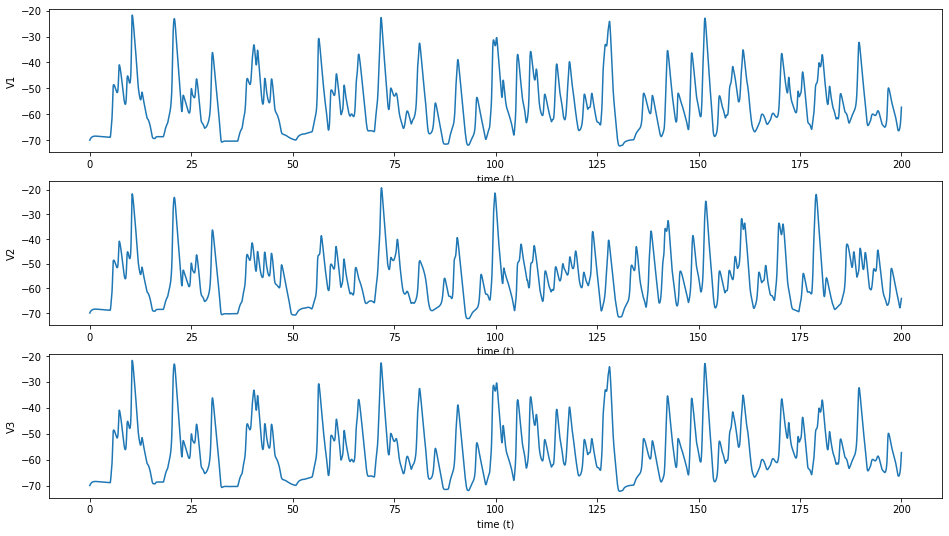

del2 is 0.4, del1 is 1.3


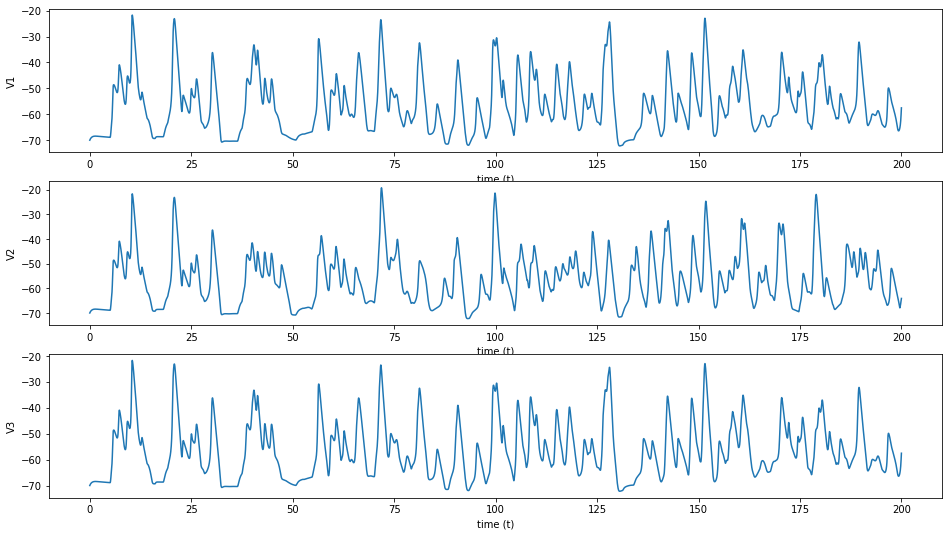

del2 is 0.4, del1 is 1.4


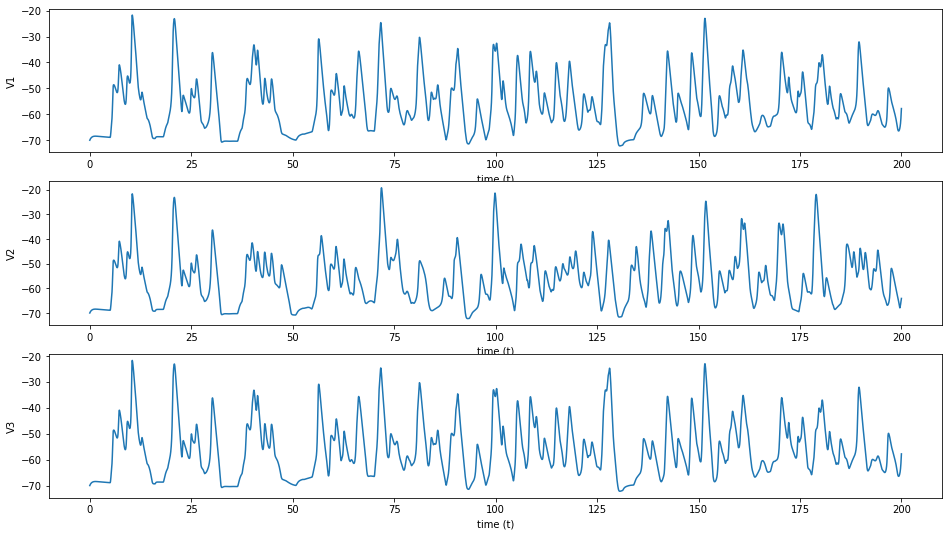

del2 is 0.4, del1 is 1.5


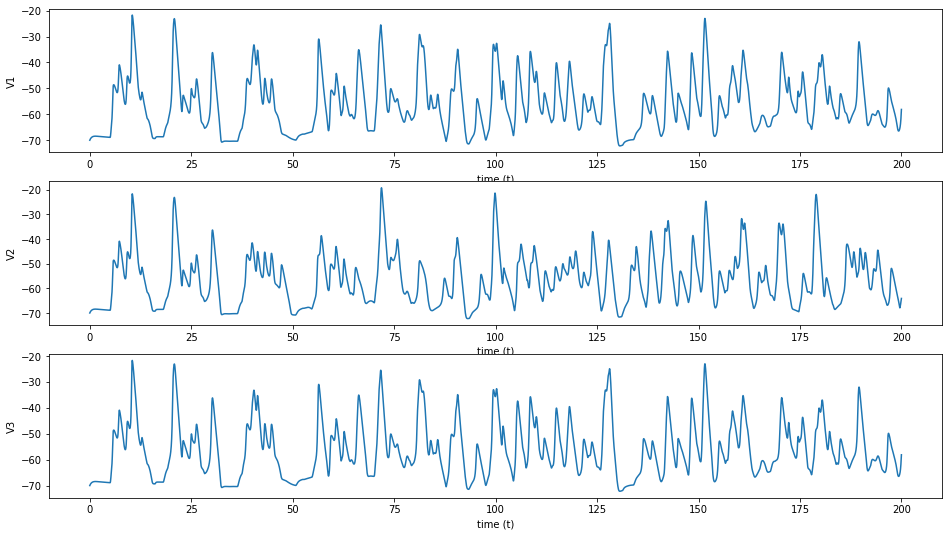

del2 is 0.4, del1 is 1.6


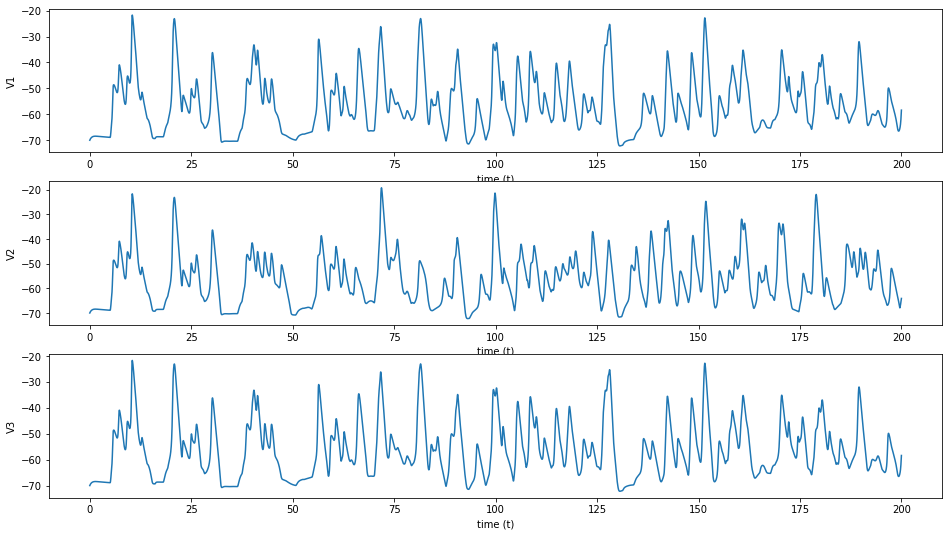

del2 is 0.4, del1 is 1.7


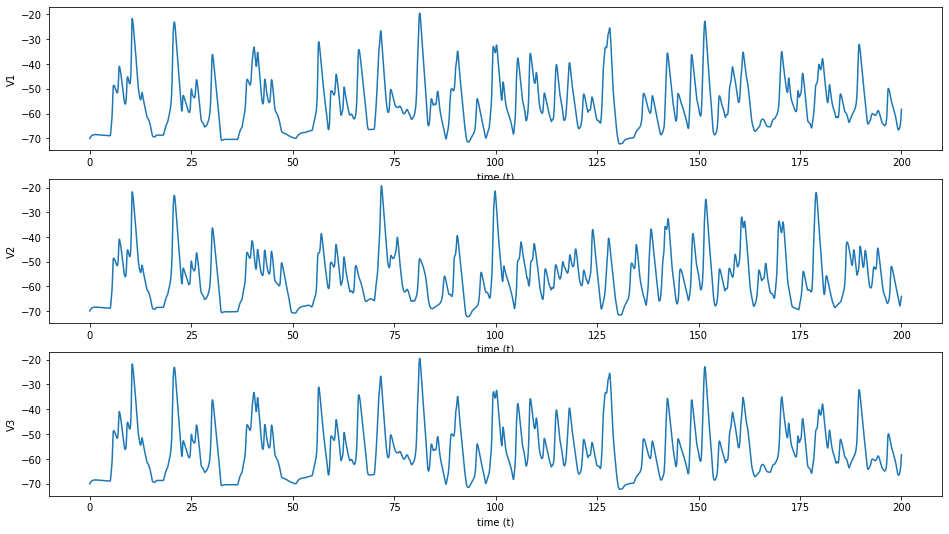

del2 is 0.4, del1 is 1.8


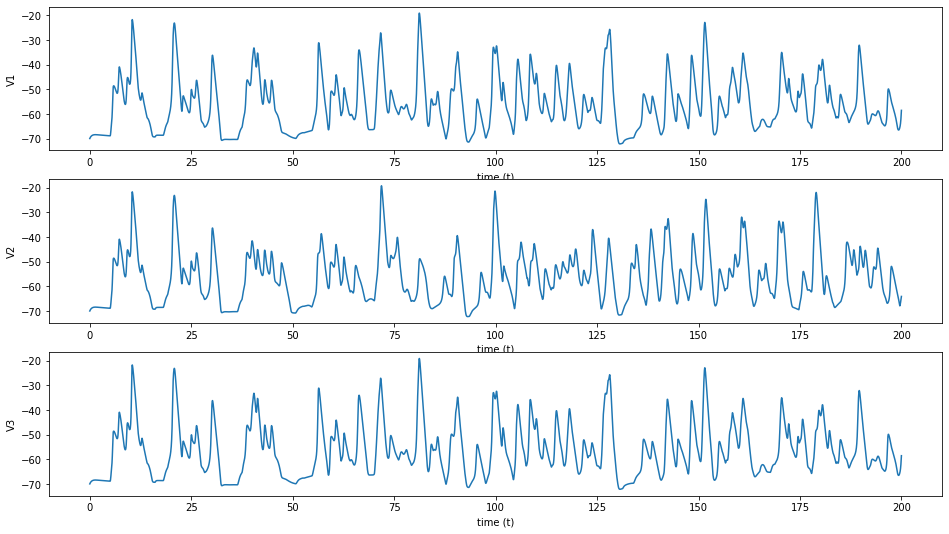

del2 is 0.4, del1 is 1.9


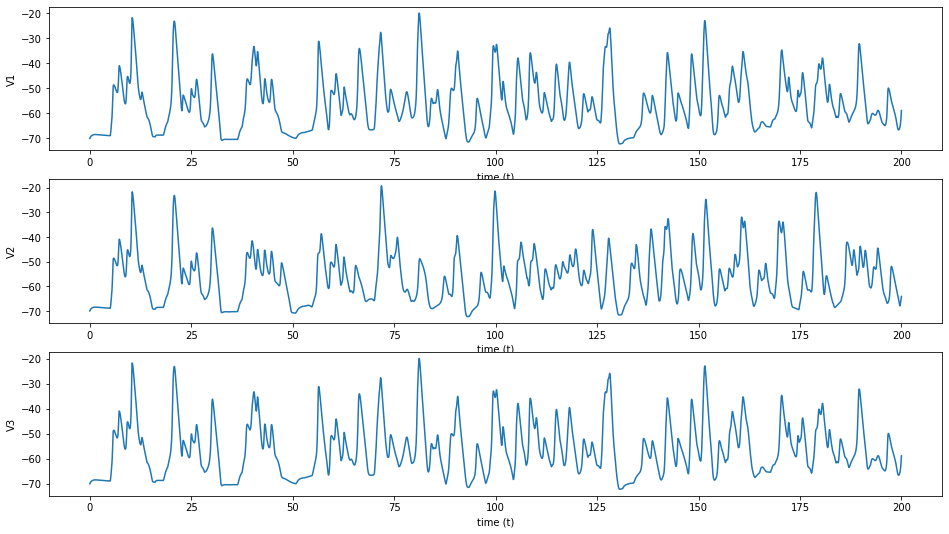

del2 is 0.5, del1 is 0.1


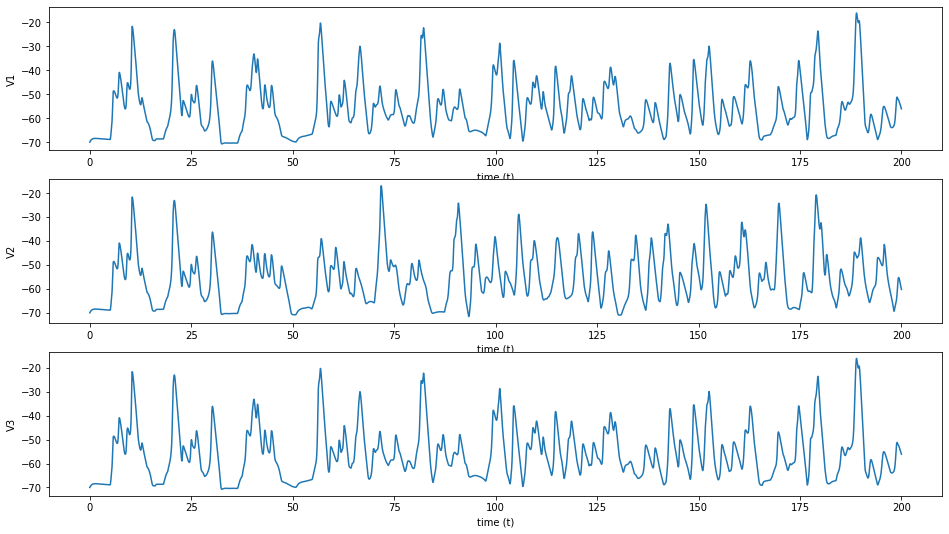

del2 is 0.5, del1 is 0.2


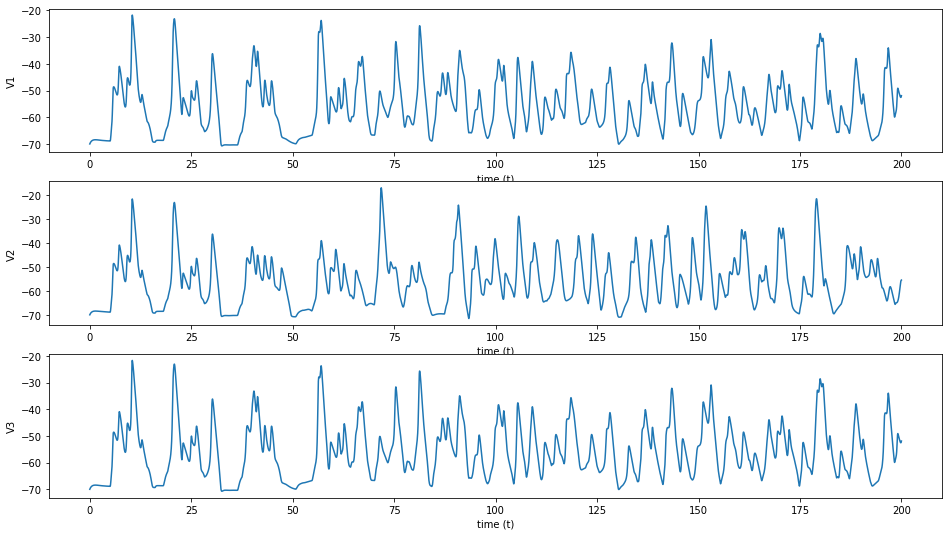

del2 is 0.5, del1 is 0.3


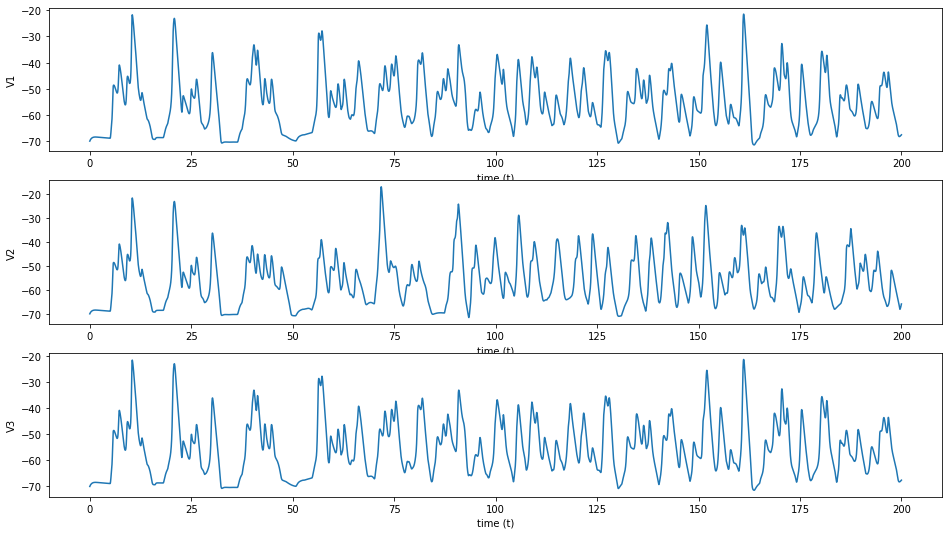

del2 is 0.5, del1 is 0.4


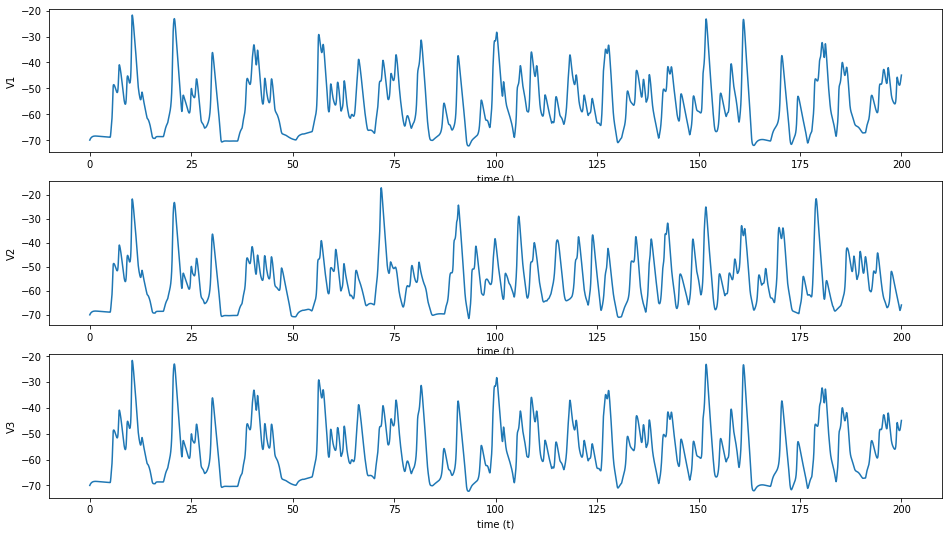

del2 is 0.5, del1 is 0.5


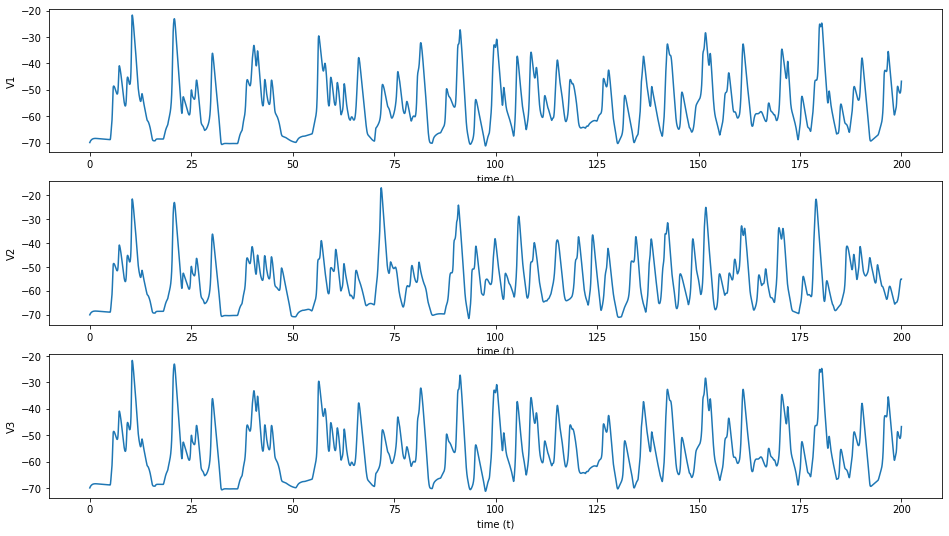

del2 is 0.5, del1 is 0.6


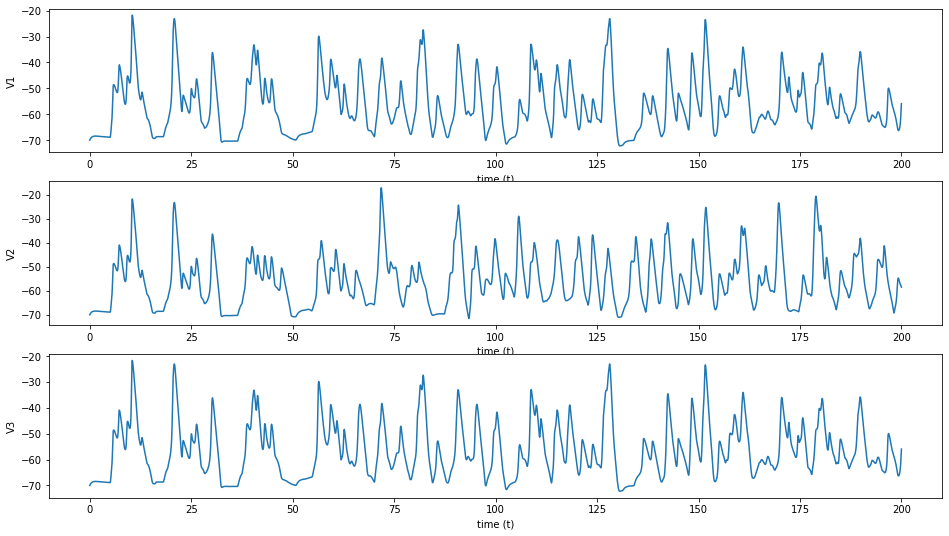

del2 is 0.5, del1 is 0.7


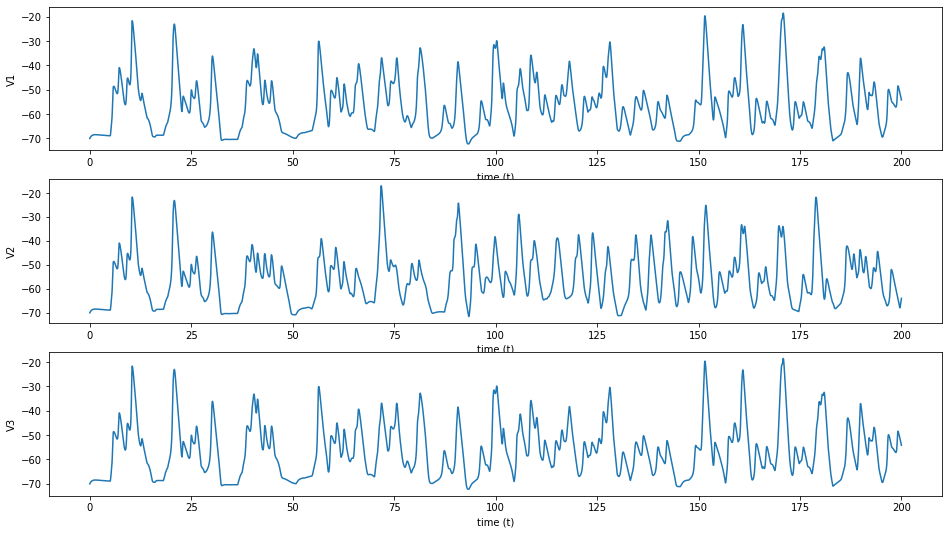

del2 is 0.5, del1 is 0.8


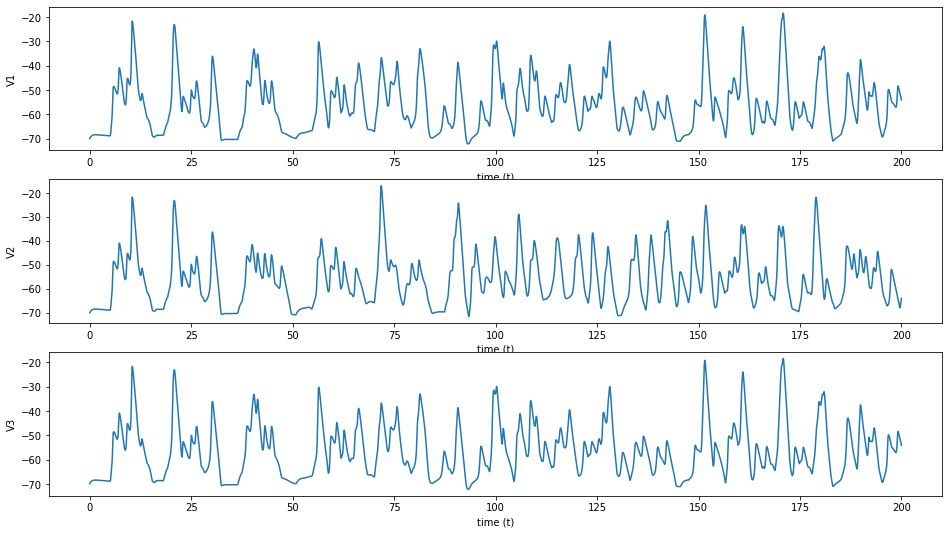

del2 is 0.5, del1 is 0.9


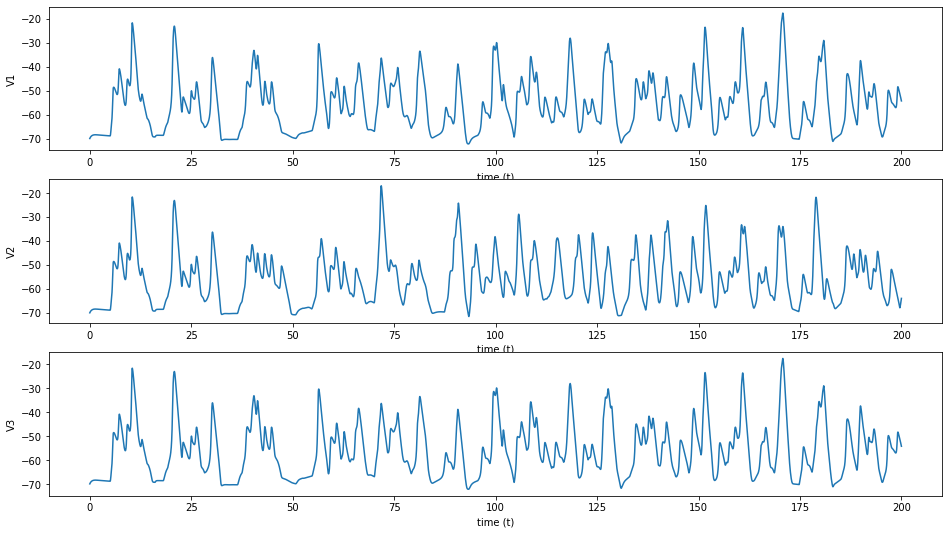

del2 is 0.5, del1 is 1.0


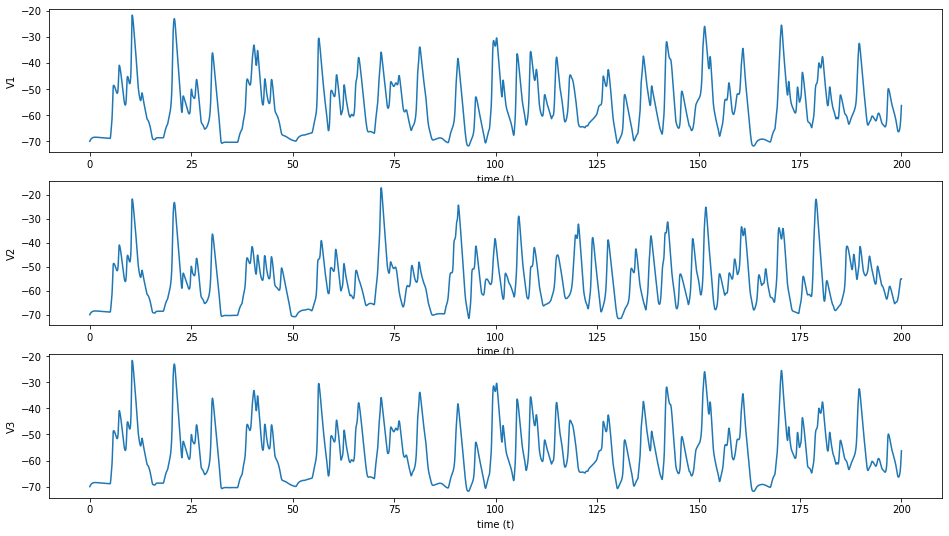

del2 is 0.5, del1 is 1.1


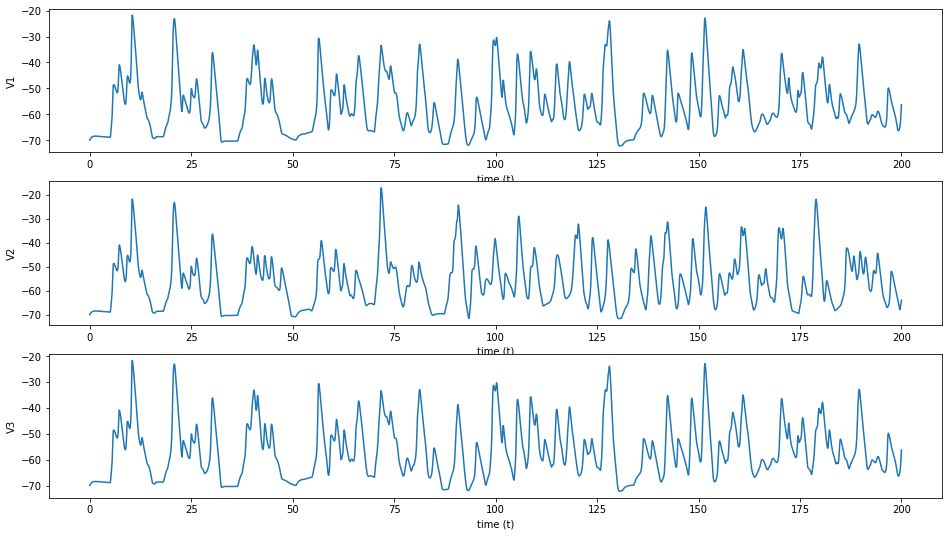

del2 is 0.5, del1 is 1.2


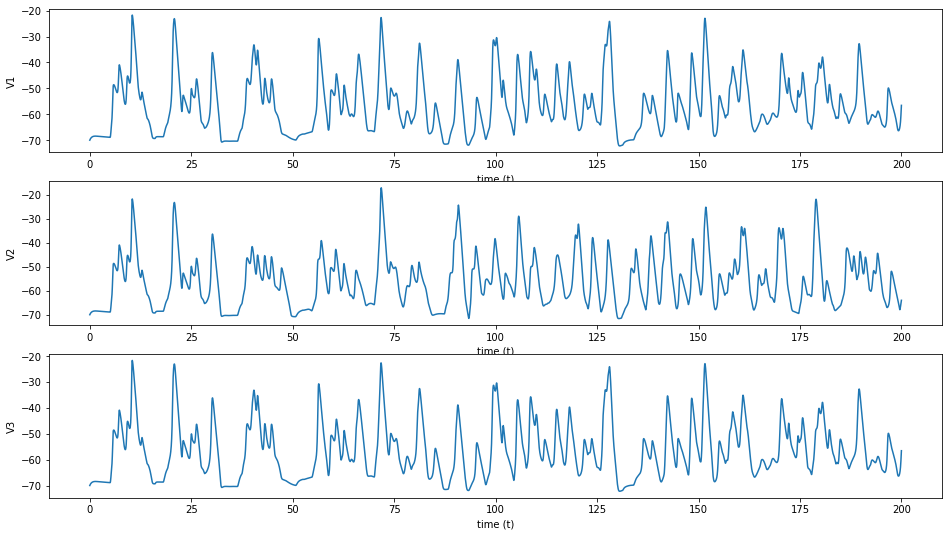

del2 is 0.5, del1 is 1.3


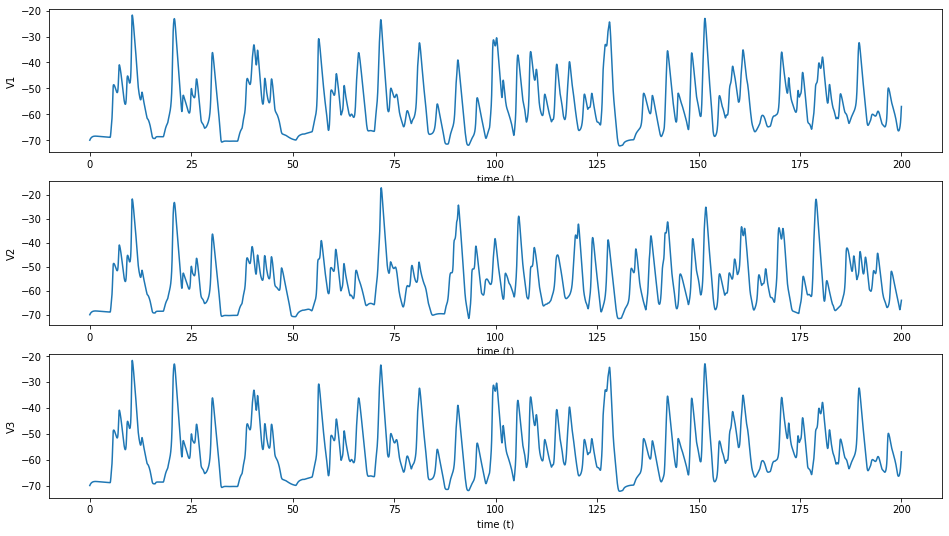

del2 is 0.5, del1 is 1.4


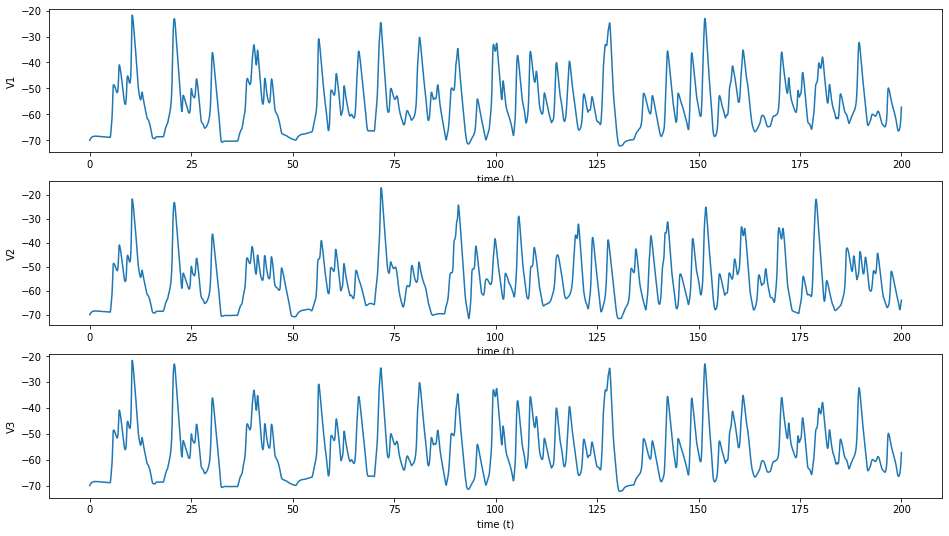

del2 is 0.5, del1 is 1.5


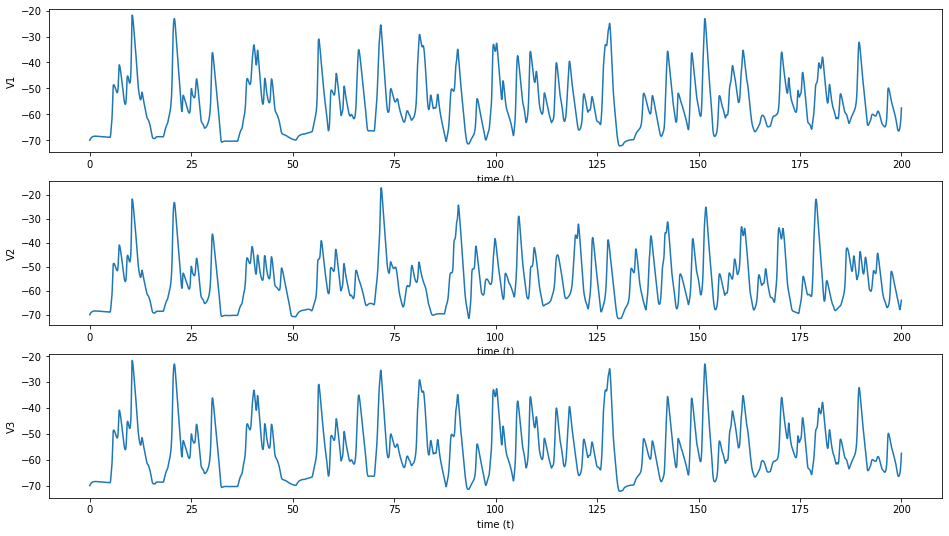

del2 is 0.5, del1 is 1.6


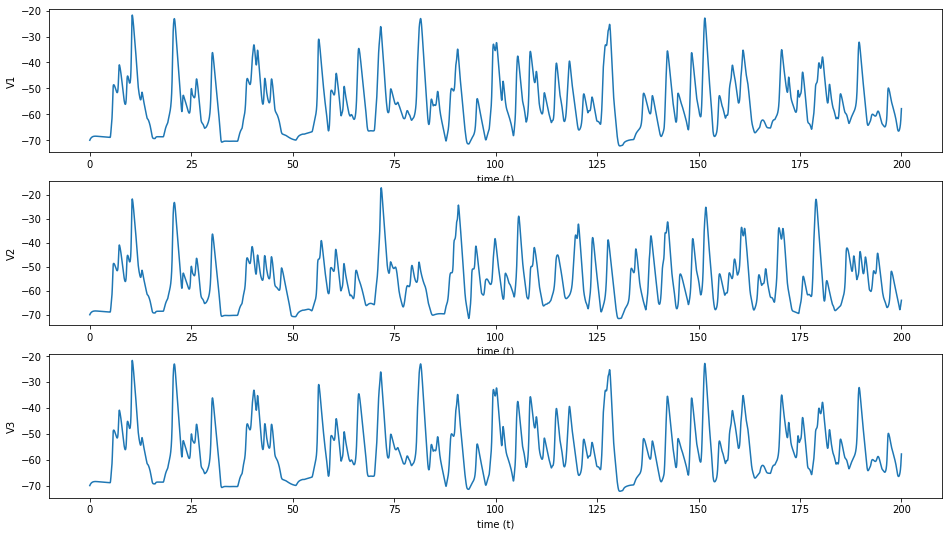

del2 is 0.5, del1 is 1.7


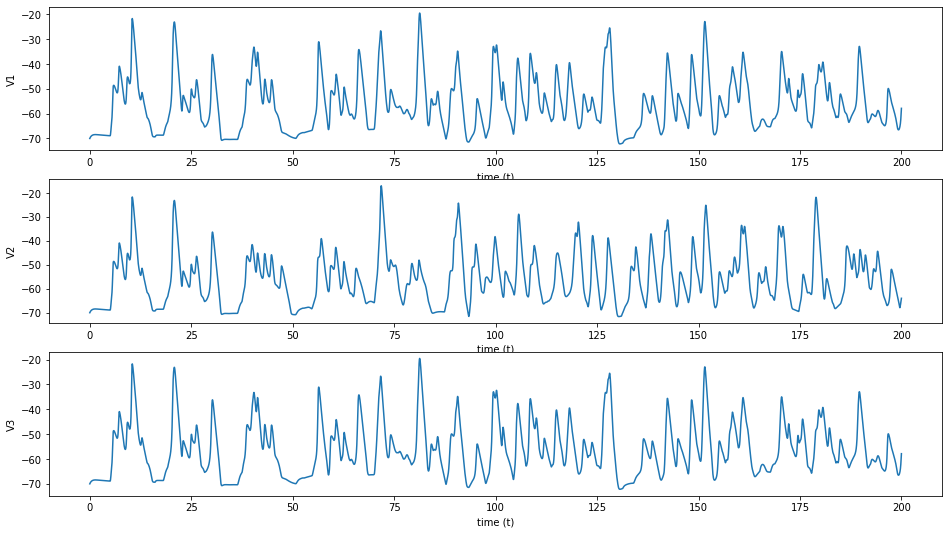

del2 is 0.5, del1 is 1.8


KeyboardInterrupt: ignored

In [ ]:
%matplotlib inline
import numpy as np
weights = [0.5 for i in range(11)]
for i in np.arange(0.1,2,0.1).round(2):
    for j in np.arange(0.1,2,0.1).round(2):
        lateralDelay = 50
        del2 = i
        del1 = j
        print(f"del2 is {i}, del1 is {j}")
        L1 = LATERAL(sets, weights)
        V1 , V2, V3 = [], [], []
        V1.append(h.Vector().record(L1.sets[0].P1.axon(0.5)._ref_v))
        V1.append(h.Vector().record(L1.sets[0].P2.axon(0.5)._ref_v))

        V2.append(h.Vector().record(L1.sets[1].P1.axon(0.5)._ref_v))
        V2.append(h.Vector().record(L1.sets[1].P2.axon(0.5)._ref_v))

        V3.append(h.Vector().record(L1.sets[2].P1.axon(0.5)._ref_v))
        V3.append(h.Vector().record(L1.sets[2].P2.axon(0.5)._ref_v))

        V1.append(h.Vector().record(L1.sets[0].M1.axon(0.5)._ref_v))
        V1.append(h.Vector().record(L1.sets[0].M2.axon(0.5)._ref_v))
        V1.append(h.Vector().record(L1.sets[0].G1.axon(0.5)._ref_v))
        V1.append(h.Vector().record(L1.sets[0].G2.axon(0.5)._ref_v))

        V2.append(h.Vector().record(L1.sets[1].M1.axon(0.5)._ref_v))
        V2.append(h.Vector().record(L1.sets[1].M2.axon(0.5)._ref_v))
        V2.append(h.Vector().record(L1.sets[1].G1.axon(0.5)._ref_v))
        V2.append(h.Vector().record(L1.sets[1].G2.axon(0.5)._ref_v))

        V3.append(h.Vector().record(L1.sets[2].M1.axon(0.5)._ref_v))
        V3.append(h.Vector().record(L1.sets[2].M2.axon(0.5)._ref_v))
        V3.append(h.Vector().record(L1.sets[2].G1.axon(0.5)._ref_v))
        V3.append(h.Vector().record(L1.sets[2].G2.axon(0.5)._ref_v))
        t = h.Vector().record(h._ref_t)
        h.finitialize(-70*mV)
        h.continuerun(200*ms)
        V1Mean = np.mean(V1, axis=0)
        V2Mean = np.mean(V2, axis=0)
        V3Mean = np.mean(V3, axis=0)
        fig, axs = plt1.subplots(3, figsize=(16,9))
        axs[0].plot(t, list(V1Mean))
        axs[0].set_xlabel('time (t)')
        axs[0].set_ylabel('V1')
        axs[1].plot(t, list(V2Mean))
        axs[1].set_xlabel('time (t)')
        axs[1].set_ylabel('V2')
        axs[2].plot(t, list(V3Mean))
        axs[2].set_xlabel('time (t)')
        axs[2].set_ylabel('V3')
        plt1.show(fig)

In [ ]:
%matplotlib inline
import numpy as np
weights = [0.5 for i in range(11)]
for i in np.arange(1,20,1):
    for j in np.arange(1,20,1).round(2):
        del2 = i
        del1 = j
        print(f"del2 is {i}, del1 is {j}")
        L1 = LATERAL(sets, weights)
        V1 , V2, V3 = [], [], []
        V1.append(h.Vector().record(L1.sets[0].P1.axon(0.5)._ref_v))
        V1.append(h.Vector().record(L1.sets[0].P2.axon(0.5)._ref_v))

        V2.append(h.Vector().record(L1.sets[1].P1.axon(0.5)._ref_v))
        V2.append(h.Vector().record(L1.sets[1].P2.axon(0.5)._ref_v))

        V3.append(h.Vector().record(L1.sets[2].P1.axon(0.5)._ref_v))
        V3.append(h.Vector().record(L1.sets[2].P2.axon(0.5)._ref_v))

        V1.append(h.Vector().record(L1.sets[0].M1.axon(0.5)._ref_v))
        V1.append(h.Vector().record(L1.sets[0].M2.axon(0.5)._ref_v))
        V1.append(h.Vector().record(L1.sets[0].G1.axon(0.5)._ref_v))
        V1.append(h.Vector().record(L1.sets[0].G2.axon(0.5)._ref_v))

        V2.append(h.Vector().record(L1.sets[1].M1.axon(0.5)._ref_v))
        V2.append(h.Vector().record(L1.sets[1].M2.axon(0.5)._ref_v))
        V2.append(h.Vector().record(L1.sets[1].G1.axon(0.5)._ref_v))
        V2.append(h.Vector().record(L1.sets[1].G2.axon(0.5)._ref_v))

        V3.append(h.Vector().record(L1.sets[2].M1.axon(0.5)._ref_v))
        V3.append(h.Vector().record(L1.sets[2].M2.axon(0.5)._ref_v))
        V3.append(h.Vector().record(L1.sets[2].G1.axon(0.5)._ref_v))
        V3.append(h.Vector().record(L1.sets[2].G2.axon(0.5)._ref_v))
        t = h.Vector().record(h._ref_t)
        h.finitialize(-70*mV)
        h.continuerun(200*ms)
        V1Mean = np.mean(V1, axis=0)
        V2Mean = np.mean(V2, axis=0)
        V3Mean = np.mean(V3, axis=0)
        fig, axs = plt1.subplots(3, figsize=(16,9))
        axs[0].plot(t, list(V1Mean))
        axs[0].set_xlabel('time (t)')
        axs[0].set_ylabel('V1')
        axs[1].plot(t, list(V2Mean))
        axs[1].set_xlabel('time (t)')
        axs[1].set_ylabel('V2')
        axs[2].plot(t, list(V3Mean))
        axs[2].set_xlabel('time (t)')
        axs[2].set_ylabel('V3')
        plt1.show(fig)

#changing lateral delay

In [ ]:
i1 = 0.7
i2 = 2
weights = [0.5 for i in range(11)]
for i in range(2, 20, 2):
    lateralDelay = 20 + i
    print("Lateral Delay is changed to", 20+i)
    L1 = LATERAL(sets, weights)
    V1 , V2, V3 = [], [], []
    V1.append(h.Vector().record(L1.sets[0].P1.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].P2.axon(0.5)._ref_v))

    V2.append(h.Vector().record(L1.sets[1].P1.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].P2.axon(0.5)._ref_v))

    V3.append(h.Vector().record(L1.sets[2].P1.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].P2.axon(0.5)._ref_v))

    V1.append(h.Vector().record(L1.sets[0].M1.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].M2.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].G1.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].G2.axon(0.5)._ref_v))

    V2.append(h.Vector().record(L1.sets[1].M1.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].M2.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].G1.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].G2.axon(0.5)._ref_v))

    V3.append(h.Vector().record(L1.sets[2].M1.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].M2.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].G1.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].G2.axon(0.5)._ref_v))
    t = h.Vector().record(h._ref_t)
    h.finitialize(-70*mV)
    h.continuerun(200*ms)
    V1Mean = np.mean(V1, axis=0)
    V2Mean = np.mean(V2, axis=0)
    V3Mean = np.mean(V3, axis=0)
    fig, axs = plt1.subplots(3, figsize=(16,9))
    axs[0].plot(t, list(V1Mean))
    axs[0].set_xlabel('time (t)')
    axs[0].set_ylabel('V1')
    axs[1].plot(t, list(V2Mean))
    axs[1].set_xlabel('time (t)')
    axs[1].set_ylabel('V2')
    axs[2].plot(t, list(V3Mean))
    axs[2].set_xlabel('time (t)')
    axs[2].set_ylabel('V3')
    plt1.show(fig)
# fig, axs = plt1.subplots(2, figsize=(16,9))
# axs[0].plot(list(V1Mean), list(V3Mean))
# axs[0].set_xlabel('V1')
# axs[0].set_ylabel('V3')
# axs[1].plot(list(V1Mean), list(V2Mean))
# axs[1].set_xlabel('V1')
# axs[1].set_ylabel('V2')

# Figure 6 weak coupling

In [ ]:
i1 = 2
i2 = 4
sets = 3
weights = np.random.uniform(0.05,0.1,15)
weight = 0.3
del1 = 0.01
del2 = 0.02
lateralDelay = 45

In [ ]:
#with coupling
# limit the time to 500ms
weights = [0.5 for i in range(11)]
# lateralDelay = 65
for weight in np.arange(0.01, 0.06, 0.01).round(2):
    L1 = LATERAL(sets, weights)
    print(f"Lateral Delay: {lateralDelay}, del1: {del1}, del2: {del2}, i1: {i1}, i2: {i2}, weight:{weight}")
    V1 , V2, V3 = [], [], []
    V1.append(h.Vector().record(L1.sets[0].P1.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].P1.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].P2.axon(0.5)._ref_v))

    V2.append(h.Vector().record(L1.sets[1].P1.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].P2.axon(0.5)._ref_v))

    V3.append(h.Vector().record(L1.sets[2].P1.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].P2.axon(0.5)._ref_v))

    V1.append(h.Vector().record(L1.sets[0].M1.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].M2.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].G1.axon(0.5)._ref_v))
    V1.append(h.Vector().record(L1.sets[0].G2.axon(0.5)._ref_v))

    V2.append(h.Vector().record(L1.sets[1].M1.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].M2.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].G1.axon(0.5)._ref_v))
    V2.append(h.Vector().record(L1.sets[1].G2.axon(0.5)._ref_v))

    V3.append(h.Vector().record(L1.sets[2].M1.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].M2.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].G1.axon(0.5)._ref_v))
    V3.append(h.Vector().record(L1.sets[2].G2.axon(0.5)._ref_v))
    t = h.Vector().record(h._ref_t)
    h.finitialize(-70*mV)
    h.continuerun(200*ms)
    V1Mean = np.mean(V1, axis=0)
    V2Mean = np.mean(V2, axis=0)
    V3Mean = np.mean(V3, axis=0)
    fig, axs = plt1.subplots(3, figsize=(16,9))
    axs[0].plot(t, list(V1Mean))
    axs[0].set_xlabel('time (t)')
    axs[0].set_ylabel('V1')
    axs[1].plot(t, list(V2Mean))
    axs[1].set_xlabel('time (t)')
    axs[1].set_ylabel('V2')
    axs[2].plot(t, list(V3Mean))
    axs[2].set_xlabel('time (t)')
    axs[2].set_ylabel('V3')
    plt1.show(fig)
    fig, axs = plt1.subplots(2, figsize=(16,9))
    axs[0].plot(list(V1Mean), list(V2Mean))
    axs[0].set_xlabel('V1')
    axs[0].set_ylabel('V2')
    axs[1].plot(list(V1Mean), list(V3Mean))
    axs[1].set_xlabel('V1')
    axs[1].set_ylabel('V3')
    plt1.show(fig)

In [ ]:
list1 = [i for i in range(500)]
list2 = list1[::5]
print(list2)